In [1]:
import os
#os.chdir('/Users/rupesh.karn/Desktop/WorkPart-1/UNSW-NB15 Dataset')
import pandas as pd
import numpy as np
import csv
import os
import time
from matplotlib.pyplot import *
import matplotlib.pyplot as plt
import pylab
pylab.rcParams['figure.figsize'] = (16.0, 5.0)

# Read in the training CSV file
print("Reading Training csv file.")
df1 = pd.read_csv("UNSW_NB15_training-set.csv")
df1.drop('label', axis=1, inplace=True)

obj_df=df1

obj_df["proto"] = obj_df["proto"].astype('category')
obj_df["service"] = obj_df["service"].astype('category')
obj_df["state"] = obj_df["state"].astype('category')
obj_df["proto_cat"] = obj_df["proto"].cat.codes
obj_df["service_cat"] = obj_df["service"].cat.codes
obj_df["state_cat"] = obj_df["state"].cat.codes

obj_df["proto"] = obj_df["proto_cat"]
obj_df["service"] = obj_df["service_cat"]
obj_df["state"] = obj_df["state_cat"]

obj_df.drop('proto_cat', axis=1, inplace=True)
obj_df.drop('service_cat', axis=1, inplace=True)
obj_df.drop('state_cat', axis=1, inplace=True)

Y_train_all_attacks = obj_df["attack_cat"]
obj_df=pd.get_dummies(obj_df, columns=["attack_cat"])


X_train = obj_df.values[:,:-10]


for j in range(0,43):
    maximum = max(X_train[:,j])
    for i in range(0,len(X_train)):
        X_train[i,j] = round(X_train[i,j]/maximum,3)

# Read in the testing CSV file 
print("Reading Testing csv file.")
df2 = pd.read_csv("UNSW_NB15_testing-set.csv")
df2.drop('label', axis=1, inplace=True)

obj_df2=df2

obj_df2["proto"] = obj_df2["proto"].astype('category')
obj_df2["service"] = obj_df2["service"].astype('category')
obj_df2["state"] = obj_df2["state"].astype('category')
obj_df2["proto_cat"] = obj_df2["proto"].cat.codes
obj_df2["service_cat"] = obj_df2["service"].cat.codes
obj_df2["state_cat"] = obj_df2["state"].cat.codes

obj_df2["proto"] = obj_df2["proto_cat"]
obj_df2["service"] = obj_df2["service_cat"]
obj_df2["state"] = obj_df2["state_cat"]

obj_df2.drop('proto_cat', axis=1, inplace=True)
obj_df2.drop('service_cat', axis=1, inplace=True)
obj_df2.drop('state_cat', axis=1, inplace=True)

Y_test_all_attacks = obj_df2["attack_cat"]
obj_df2=pd.get_dummies(obj_df2, columns=["attack_cat"])


X_test = obj_df2.values[:,:-10]


for j in range(0,43):
    maximum = max(X_train[:,j])
    for i in range(0,len(X_test)):
        X_test[i,j] = round(X_test[i,j]/maximum,3)


estimators_number = list(range(10,30))

dataspace = 0;
overall_accuracy_matrix = [None]*len(X_train)
iTERATION=0
dataspace_number=1
attack_type = 4
Y_train = obj_df.values[:,-attack_type]
Y_test = obj_df2.values[:,-attack_type]

cleanup_nums = {"Worms":0, "Shellcode":1, "Reconnaissance":2, "Normal":3, "Generic":4, "Fuzzers":5, "Exploits":6, "DoS":7, "Backdoor":8, "Analysis":9}
Y_train_all_attacks.replace(cleanup_nums,inplace=True)
Y_test_all_attacks.replace(cleanup_nums,inplace=True)

Reading Training csv file.
Reading Testing csv file.


In [50]:
%load_ext autoreload
%autoreload 2
%pylab inline

import tensorflow as tf
slim = tf.contrib.slim
graph_replace = tf.contrib.graph_editor.graph_replace

import sys, os
sys.path.extend([os.path.expanduser('..')])
from pathint import utils
import seaborn as sns
sns.set_style("ticks")

from tqdm import trange, tqdm

# import operator
import matplotlib.colors as colors
import matplotlib.cm as cmx

rcParams['pdf.fonttype'] = 42
rcParams['ps.fonttype'] = 42

select = tf.select if hasattr(tf, 'select') else tf.where

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Populating the interactive namespace from numpy and matplotlib


/usr/local/lib/python3.5/dist-packages/IPython/core/magics/pylab.py:160: UserWarning: pylab import has clobbered these variables: ['colors', 'flatten', 'select', 'gradient']
`%matplotlib` prevents importing * from pylab and numpy
  "\n`%matplotlib` prevents importing * from pylab and numpy"


In [51]:
# Data params
input_dim = 43
output_dim = 10

# Network params
n_hidden_units = 43
activation_fn = tf.nn.relu

# Optimization params
batch_size = 64
epochs_per_task = 10

n_stats = 10

# Reset optimizer after each age
reset_optimizer = True

In [78]:
from keras.utils import np_utils

#task_labels = [[0,1], [2,3], [4,5], [6,7], [8,9]]
task_labels = [[0,1], [2,3], [4,5], [6,7], [8,9],[1,5],[7,9],[3,8],[0,6],[4,2]]
#task_labels = [[0,1,2,3,4], [5,6,7,8,9]]
n_tasks = len(task_labels)
nb_classes  = 10
training_datasets = []
validation_datasets = []
multihead=False

for labels in task_labels:
    idx = np.in1d(Y_train_all_attacks, labels)
    if multihead:
        label_map = np.arange(nb_classes)
        label_map[labels] = np.arange(len(labels))
        data = X_train[idx], np_utils.to_categorical(label_map[Y_train_all_attacks[idx]], len(labels))
    else:
        data = X_train[idx], np_utils.to_categorical(Y_train_all_attacks[idx], nb_classes)
        training_datasets.append(data)

for labels in task_labels:
    idx = np.in1d(Y_test_all_attacks, labels)
    if multihead:
        label_map = np.arange(nb_classes)
        label_map[labels] = np.arange(len(labels))
        data = X_test[idx], np_utils.to_categorical(label_map[Y_test_all_attacks[idx]], len(labels))
    else:
        data = X_test[idx], np_utils.to_categorical(Y_test_all_attacks[idx], nb_classes)
        validation_datasets.append(data)

In [79]:
tf.reset_default_graph()
config = tf.ConfigProto()
config.gpu_options.allow_growth=True
sess = tf.InteractiveSession(config=config)
sess.run(tf.global_variables_initializer())
import keras.backend as K
import keras.activations as activations

output_mask = tf.Variable(tf.zeros(output_dim), name="mask", trainable=False)

def masked_softmax(logits):
    # logits are [batch_size, output_dim]
    x = select(tf.tile(tf.equal(output_mask[None, :], 1.0), [tf.shape(logits)[0], 1]), logits, -1e32 * tf.ones_like(logits))
    return activations.softmax(x)

def set_active_outputs(labels):
    new_mask = np.zeros(output_dim)
    for l in labels:
        new_mask[l] = 1.0
    sess.run(output_mask.assign(new_mask))
    print(sess.run(output_mask))
    
def masked_predict(model, data, targets):
    pred = model.predict(data)
    print(pred)
    acc = np.argmax(pred,1)==np.argmax(targets,1)
    return acc.mean()

In [80]:
from keras.models import Sequential
from keras.layers import Dense
model = Sequential()
model.add(Dense(n_hidden_units, activation=activation_fn, input_shape=(input_dim,)))
model.add(Dense(n_hidden_units, activation=activation_fn))
#model.add(Dense(n_hidden_units, activation=activation_fn))
model.add(Dense(output_dim, kernel_initializer='random_uniform', activation=masked_softmax))

from pathint import protocols
from pathint.optimizers import KOOptimizer
from keras.optimizers import Adam, RMSprop,SGD
from keras.callbacks import Callback
from pathint.keras_utils import LossHistory

#protocol_name, protocol = protocols.PATH_INT_PROTOCOL(omega_decay='sum',xi=1e-3)
protocol_name, protocol = protocols.PATH_INT_PROTOCOL(omega_decay='sum',xi=1e-3)
#protocol_name, protocol = protocols.FISHER_PROTOCOL('sum')
opt = Adam(lr=1e-3, beta_1=0.9, beta_2=0.999)
#opt = SGD(1e-3)
#opt = RMSprop(lr=1e-3)
oopt = KOOptimizer(opt, model=model, **protocol)
model.compile(loss='categorical_crossentropy', optimizer=oopt, metrics=['accuracy'])
model.model._make_train_function()
saved_weights = model.get_weights()

history = LossHistory()
callbacks = [history]
datafile_name = "split_mnist_data_%s.pkl.gz"%protocol_name

In [81]:
print(protocol)

{'regularizer_fn': <function quadratic_regularizer at 0x7fb54a0376a8>, 'init_updates': [('cweights', <function <lambda>.<locals>.<lambda> at 0x7fb5a4453d90>)], 'task_updates': [('omega', <function <lambda>.<locals>.<lambda> at 0x7fb4fc3e56a8>), ('cweights', <function <lambda>.<locals>.<lambda> at 0x7fb4fc3e5730>), ('grads2', <function <lambda>.<locals>.<lambda> at 0x7fb4fc3e5d90>)], 'step_updates': [('grads2', <function <lambda>.<locals>.<lambda> at 0x7fb4fc3e5e18>)]}


In [82]:
def run_fits(cvals, training_data, valid_data, eval_on_train_set=False, nstats=1):
    acc_mean = dict()
    acc_std = dict()
    model_weights_save = []   #Empty list to save the model weights aftertraining each task
    for cidx, cval_ in enumerate(tqdm(cvals)):
        runs = []
        for runid in range(nstats):
            sess.run(tf.global_variables_initializer())
            # model.set_weights(saved_weights)
            cstuffs = []
            evals = []
            print("setting cval")
            cval = cval_
            oopt.set_strength(cval)
            oopt.init_task_vars()
            print("cval is", sess.run(oopt.lam))
            for age, tidx in enumerate(range(n_tasks)):
                print("Age %i, cval is=%f"%(age,cval))
                print("settint output mask")
                set_active_outputs(task_labels[age])
                stuffs = model.fit(training_data[tidx][0], training_data[tidx][1], batch_size, epochs_per_task, callbacks=callbacks)
                oopt.update_task_metrics(training_data[tidx][0], training_data[tidx][1], batch_size)
                oopt.update_task_vars()
                ftask = []
                model_weights_save.append(model.get_weights()) #Save the model weights aftertraining each task
                for j in range(n_tasks):
                    set_active_outputs(task_labels[j])
                    if eval_on_train_set:
                        f_ = masked_predict(model, training_data[j][0], training_data[j][1])
                    else:
                        f_ = masked_predict(model, valid_data[j][0], valid_data[j][1])
                    ftask.append(np.mean(f_))
                evals.append(ftask)
                cstuffs.append(stuffs)

                # Re-initialize optimizater variables
                if reset_optimizer:
                    oopt.reset_optimizer()

            evals = np.array(evals)
            runs.append(evals)
        
        runs = np.array(runs)
        acc_mean[cval_] = runs.mean(0)
        acc_std[cval_] = runs.std(0)
    return dict(mean=acc_mean, std=acc_std),model_weights_save

In [83]:
# cvals = np.concatenate(([0], np.logspace(-2, 2, 10)))
# cvals = np.concatenate(([0], np.logspace(-1, 2, 2)))
# cvals = np.concatenate(([0], np.logspace(-2, 0, 3)))
#cvals = np.logspace(-3, 3, 7)#[0, 1.0, 2, 5, 10]
cvals = [0, 1.0]
print(cvals)

[0, 1.0]


In [84]:
#%%capture

recompute_data = True

if recompute_data:
    data,model_weights_save = run_fits(cvals, training_datasets, validation_datasets, eval_on_train_set=True, nstats=n_stats)
    utils.save_zipped_pickle(data, datafile_name)

  0%|          | 0/2 [00:00<?, ?it/s]

setting cval
cval is 0.0
Age 0, cval is=0.000000
settint output mask
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
Epoch 1/10
422/422 [==============================] - 0s - loss: 0.6666 - acc: 0.8720     
Epoch 2/10
422/422 [==============================] - 0s - loss: 0.6241 - acc: 0.8957     
Epoch 3/10
422/422 [==============================] - 0s - loss: 0.5731 - acc: 0.8957     
Epoch 4/10
422/422 [==============================] - 0s - loss: 0.5126 - acc: 0.8957     
Epoch 5/10
422/422 [==============================] - 0s - loss: 0.4496 - acc: 0.8957     
Epoch 6/10
422/422 [==============================] - 0s - loss: 0.3909 - acc: 0.8957     
Epoch 7/10
422/422 [==============================] - 0s - loss: 0.3573 - acc: 0.8957     
Epoch 8/10
422/422 [==============================] - 0s - loss: 0.3411 - acc: 0.8957     
Epoch 9/10
422/422 [==============================] - 0s - loss: 0.3315 - acc: 0.8957     
Epoch 10/10
422/422 [==============================] - 0s - loss: 0.3206 - acc: 

[[0.         0.         0.         ... 0.45939577 0.         0.54060423]
 [0.         0.         0.         ... 0.6433362  0.         0.3566639 ]
 [0.         0.         0.         ... 0.4653897  0.         0.53461033]
 ...
 [0.         0.         0.         ... 0.59375733 0.         0.40624264]
 [0.         0.         0.         ... 0.5687941  0.         0.43120596]
 [0.         0.         0.         ... 0.5825883  0.         0.4174117 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  8.0802572e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  6.6769794e-02 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.2759586e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  2.6419617e-18 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  2.6419617e-18 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000

15221/15221 [==============================] - 0s - loss: 0.4814 - acc: 0.7477     
Epoch 6/10
15221/15221 [==============================] - 0s - loss: 0.4795 - acc: 0.7480     
Epoch 7/10
15221/15221 [==============================] - 0s - loss: 0.4783 - acc: 0.7507     
Epoch 8/10
15221/15221 [==============================] - 0s - loss: 0.4764 - acc: 0.7506     
Epoch 9/10
15221/15221 [==============================] - 0s - loss: 0.4753 - acc: 0.7494     
Epoch 10/10
15221/15221 [==============================] - 0s - loss: 0.4739 - acc: 0.7526     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.32105917 0.6789408  0.         ... 0.         0.         0.        ]
 [0.35564464 0.6443553  0.         ... 0.         0.         0.        ]
 [0.42568448 0.5743155  0.         ... 0.         0.         0.        ]
 ...
 [0.34172305 0.6582769  0.         ... 0.         0.         0.        ]
 [0.33563492 0.66436505 0.         ... 0.         0.         0.        ]
 [0.44269758 0.5573024  0.         ...

[[0.         0.         0.         ... 0.40192765 0.         0.59807235]
 [0.         0.         0.         ... 0.5970742  0.         0.40292576]
 [0.         0.         0.         ... 0.6449417  0.         0.35505828]
 ...
 [0.         0.         0.         ... 0.00548278 0.         0.99451727]
 [0.         0.         0.         ... 0.01029837 0.         0.9897016 ]
 [0.         0.         0.         ... 0.01022875 0.         0.98977125]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  7.5919396e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  7.6203495e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  7.3354089e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.1035195e-17 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.1035195e-17 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000

4766/4766 [==============================] - 0s - loss: 0.2828 - acc: 0.8590     
Epoch 5/10
4766/4766 [==============================] - 0s - loss: 0.2810 - acc: 0.8575     
Epoch 6/10
4766/4766 [==============================] - 0s - loss: 0.2788 - acc: 0.8594     
Epoch 7/10
4766/4766 [==============================] - 0s - loss: 0.2774 - acc: 0.8621     
Epoch 8/10
4766/4766 [==============================] - 0s - loss: 0.2755 - acc: 0.8666     
Epoch 9/10
4766/4766 [==============================] - 0s - loss: 0.2741 - acc: 0.8647     
Epoch 10/10
4766/4766 [==============================] - 0s - loss: 0.2735 - acc: 0.8628     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1016449  0.89835507 0.         ... 0.         0.         0.        ]
 [0.05858862 0.9414114  0.         ... 0.         0.         0.        ]
 [0.2057829  0.79421705 0.         ... 0.         0.         0.        ]
 ...
 [0.09904519 0.9009548  0.         ... 0.         0.         0.        ]
 [0.08843182 0.9115682  0.    

[[0.         0.         0.         ... 0.94000244 0.         0.05999754]
 [0.         0.         0.         ... 0.998889   0.         0.00111104]
 [0.         0.         0.         ... 0.444937   0.         0.55506307]
 ...
 [0.         0.         0.         ... 0.05026364 0.         0.94973636]
 [0.         0.         0.         ... 0.1427401  0.         0.8572599 ]
 [0.         0.         0.         ... 0.09030166 0.         0.90969825]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  2.5300023e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.1583727e-03 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.7761463e-02 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000

22367/22367 [==============================] - 0s - loss: 0.0675 - acc: 0.9849     
Epoch 2/10
22367/22367 [==============================] - 0s - loss: 0.0532 - acc: 0.9894     
Epoch 3/10
22367/22367 [==============================] - 0s - loss: 0.0515 - acc: 0.9894     
Epoch 4/10
22367/22367 [==============================] - 0s - loss: 0.0493 - acc: 0.9900     
Epoch 5/10
22367/22367 [==============================] - 0s - loss: 0.0484 - acc: 0.9902     
Epoch 6/10
22367/22367 [==============================] - 0s - loss: 0.0475 - acc: 0.9903     
Epoch 7/10
22367/22367 [==============================] - 0s - loss: 0.0470 - acc: 0.9905     
Epoch 8/10
22367/22367 [==============================] - 0s - loss: 0.0470 - acc: 0.9906     
Epoch 9/10
22367/22367 [==============================] - 0s - loss: 0.0460 - acc: 0.9905     
Epoch 10/10
22367/22367 [==============================] - 0s - loss: 0.0453 - acc: 0.9912     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.19712546 0.8028745  0.  

[[0.         0.         0.         ... 0.49674624 0.         0.        ]
 [0.         0.         0.         ... 0.49612233 0.         0.        ]
 [0.         0.         0.         ... 0.4908559  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.48534307 0.         0.        ]
 [0.         0.         0.         ... 0.48136294 0.         0.        ]
 [0.         0.         0.         ... 0.48136294 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.4759485  0.5240514 ]
 [0.         0.         0.         ... 0.         0.46599743 0.5340025 ]
 [0.         0.         0.         ... 0.         0.47661847 0.5233816 ]
 ...
 [0.         0.         0.         ... 0.         0.47565237 0.52434766]
 [0.         0.         0.         ... 0.         0.47565237 0.52434766]
 [0.         0.         0.         ... 0.         0.49335897 0.506641  ]]
[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.6885805  0.         ... 0.       

[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.8863947  ... 0.         0.         0.        ]
 [0.         0.         0.8863947  ... 0.         0.         0.        ]
 [0.         0.         0.91952634 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.04042942 ... 0.         0.         0.        ]
 [0.         0.         0.72405314 ... 0.         0.         0.        ]
 [0.         0.         0.8096028  ... 0.         0.         0.        ]]
Age 2, cval is=0.000000
settint output mask
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
Epoch 1/10
24933/24933 [==============================] - 0s - loss: 0.1055 - acc: 0.9617     
Epoch 2/10
24933/24933 [==============================] - 0s - loss: 0.0530 - acc: 0.9847     
Epoch 3/10
24933/24933 [==============================] - 0s - loss: 0.0475 - acc: 0.9852     
Epoch 4/10
24933/24933 [==============================] - 0s - loss: 0.0430 - acc: 0.9862     
Epoch 5/10
24933/24933 [==============================] - 0s - loss:

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5220796  0.         0.        ]
 [0.         0.         0.         ... 0.5389432  0.         0.        ]
 [0.         0.         0.         ... 0.35603648 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.09288125 0.         0.        ]
 [0.         0.         0.         ... 0.11618831 0.         0.        ]
 [0.         0.         0.         ... 0.11618831 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.49715796 0.50284195]
 [0.         0.         0.         ... 0.         0.49872488 0.5012751 ]
 [0.         0.         0.         ... 0.         0.49797177 0.50202817]
 ...
 [0.         0.         0.         ... 0.         0.5030583  0.4969417 ]
 [0.         0.         0.         ... 

[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.9982767  ... 0.         0.         0.        ]
 [0.         0.         0.9982767  ... 0.         0.         0.        ]
 [0.         0.         0.05206495 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.8802016  ... 0.         0.         0.        ]
 [0.         0.         0.05924033 ... 0.         0.         0.        ]
 [0.         0.         0.05471855 ... 0.         0.         0.        ]]
Age 5, cval is=0.000000
settint output mask
[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
Epoch 1/10
6440/6440 [==============================] - 0s - loss: 0.3067 - acc: 0.8994     
Epoch 2/10
6440/6440 [==============================] - 0s - loss: 0.1364 - acc: 0.9464     
Epoch 3/10
6440/6440 [==============================] - 0s - loss: 0.1150 - acc: 0.9561     
Epoch 4/10
6440/6440 [==============================] - 0s - loss: 0.1073 - acc: 0.9627     
Epoch 5/10
6440/6440 [==============================] - 0s - loss: 0.1017 - 

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.        0.        0.        ... 0.8788367 0.        0.       ]
 [0.        0.        0.        ... 0.8855451 0.        0.       ]
 [0.        0.        0.        ... 0.9470901 0.        0.       ]
 ...
 [0.        0.        0.        ... 0.8853383 0.        0.       ]
 [0.        0.        0.        ... 0.9693104 0.        0.       ]
 [0.        0.        0.        ... 0.9693104 0.        0.       ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.89186716 0.10813291]
 [0.         0.         0.         ... 0.         0.91929317 0.08070684]
 [0.         0.         0.         ... 0.         0.78558403 0.21441591]
 ...
 [0.         0.         0.         ... 0.         0.6764821  0.32351786]
 [0.         0.         0.         ... 0.         0.6764821  0.32351786]
 [

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  2.6096004e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.9641381e-04 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  9.5079336e-03 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  2.5383102e-07 0.0000000e+00]]
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
[[7.3193800e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [5.0649128e-06 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [5.0649128e-06 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [5.3121036e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [4.6155336e-01 0.0000000e+

22367/22367 [==============================] - 0s - loss: 0.0994 - acc: 0.9807     
Epoch 2/10
22367/22367 [==============================] - 0s - loss: 0.0636 - acc: 0.9871     
Epoch 3/10
22367/22367 [==============================] - 0s - loss: 0.0563 - acc: 0.9881     
Epoch 4/10
22367/22367 [==============================] - 0s - loss: 0.0535 - acc: 0.9886     
Epoch 5/10
22367/22367 [==============================] - 0s - loss: 0.0504 - acc: 0.9893     
Epoch 6/10
22367/22367 [==============================] - 0s - loss: 0.0487 - acc: 0.9897     
Epoch 7/10
22367/22367 [==============================] - 0s - loss: 0.0476 - acc: 0.9900     
Epoch 8/10
22367/22367 [==============================] - 0s - loss: 0.0474 - acc: 0.9903     
Epoch 9/10
22367/22367 [==============================] - 0s - loss: 0.0460 - acc: 0.9903     
Epoch 10/10
22367/22367 [==============================] - 0s - loss: 0.0437 - acc: 0.9907     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.27899596 0.721004   0.  

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.50828546 0.         0.        ]
 [0.         0.         0.         ... 0.5074888  0.         0.        ]
 [0.         0.         0.         ... 0.5073768  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.507095   0.         0.        ]
 [0.         0.         0.         ... 0.50756025 0.         0.        ]
 [0.         0.         0.         ... 0.50756025 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.5057307  0.49426925]
 [0.         0.         0.         ... 0.         0.4901988  0.5098012 ]
 [0.         0.         0.         ... 0.         0.49860087 0.5013992 ]
 ...
 [0.         0.         0.         ... 0.         0.5058496  0.4941504 ]
 [0.         0.         0.         ... 

[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.9140298  ... 0.         0.         0.        ]
 [0.         0.         0.9140298  ... 0.         0.         0.        ]
 [0.         0.         0.88238925 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.04453035 ... 0.         0.         0.        ]
 [0.         0.         0.6444556  ... 0.         0.         0.        ]
 [0.         0.         0.7720266  ... 0.         0.         0.        ]]
Age 2, cval is=0.000000
settint output mask
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
Epoch 1/10
24933/24933 [==============================] - 0s - loss: 0.0998 - acc: 0.9674     
Epoch 2/10
24933/24933 [==============================] - 0s - loss: 0.0526 - acc: 0.9848     
Epoch 3/10
24933/24933 [==============================] - 0s - loss: 0.0488 - acc: 0.9852     
Epoch 4/10
24933/24933 [==============================] - 0s - loss: 0.0463 - acc: 0.9855     
Epoch 5/10
24933/24933 [==============================] - 0s - loss:

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.48444223 0.         0.        ]
 [0.         0.         0.         ... 0.508083   0.         0.        ]
 [0.         0.         0.         ... 0.39730188 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.09676817 0.         0.        ]
 [0.         0.         0.         ... 0.10360016 0.         0.        ]
 [0.         0.         0.         ... 0.10360014 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.49197778 0.50802225]
 [0.         0.         0.         ... 0.         0.52842337 0.4715766 ]
 [0.         0.         0.         ... 0.         0.49844396 0.501556  ]
 ...
 [0.         0.         0.         ... 0.         0.5182597  0.4817402 ]
 [0.         0.         0.         ... 

[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.09382005 ... 0.         0.         0.        ]
 [0.         0.         0.09382005 ... 0.         0.         0.        ]
 [0.         0.         0.37814334 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.3460265  ... 0.         0.         0.        ]
 [0.         0.         0.71296334 ... 0.         0.         0.        ]
 [0.         0.         0.6898058  ... 0.         0.         0.        ]]
Age 5, cval is=0.000000
settint output mask
[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
Epoch 1/10
6440/6440 [==============================] - 0s - loss: 0.2498 - acc: 0.9143     
Epoch 2/10
6440/6440 [==============================] - 0s - loss: 0.1445 - acc: 0.9433     
Epoch 3/10
6440/6440 [==============================] - 0s - loss: 0.1266 - acc: 0.9509     
Epoch 4/10
6440/6440 [==============================] - 0s - loss: 0.1148 - acc: 0.9561     
Epoch 5/10
6440/6440 [==============================] - 0s - loss: 0.1071 - 

[[0.         0.         0.         ... 0.799105   0.         0.        ]
 [0.         0.         0.         ... 0.8135978  0.         0.        ]
 [0.         0.         0.         ... 0.9273391  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.4816101  0.         0.        ]
 [0.         0.         0.         ... 0.66122204 0.         0.        ]
 [0.         0.         0.         ... 0.66122204 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.9312769  0.06872311]
 [0.         0.         0.         ... 0.         0.9070485  0.09295145]
 [0.         0.         0.         ... 0.         0.7787744  0.22122563]
 ...
 [0.         0.         0.         ... 0.         0.59941614 0.40058386]
 [0.         0.         0.         ... 0.         0.59941614 0.40058386]
 [0.         0.         0.         ... 0.         0.7923396  0.20766038]]
[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.0000000e+00 7.3560870e-01 0.0000000e+00 ... 

[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.76903826 ... 0.         0.         0.        ]
 [0.         0.         0.76903826 ... 0.         0.         0.        ]
 [0.         0.         0.027845   ... 0.         0.         0.        ]
 ...
 [0.         0.         0.00573836 ... 0.         0.         0.        ]
 [0.         0.         0.00567028 ... 0.         0.         0.        ]
 [0.         0.         0.00629436 ... 0.         0.         0.        ]]
Age 8, cval is=0.000000
settint output mask
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
Epoch 1/10
11176/11176 [==============================] - 0s - loss: 0.0399 - acc: 0.9898     
Epoch 2/10
11176/11176 [==============================] - 0s - loss: 0.0233 - acc: 0.9961     
Epoch 3/10
11176/11176 [==============================] - 0s - loss: 0.0224 - acc: 0.9961     
Epoch 4/10
11176/11176 [==============================] - 0s - loss: 0.0213 - acc: 0.9961     
Epoch 5/10
11176/11176 [==============================] - 0s - loss:

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 2.7359185e-01
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 2.4111597e-01
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 6.3105796e-07
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 8.1419216e-07
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 4.0051102e-08
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 4.0051102e-08
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  4.1504765e-01 5.8495235e-01]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.0295868e-09 1.0000000e+00]
 [0.0000000e+00 0.0000000e+00 

[[0.         0.         0.         ... 0.         0.5960965  0.        ]
 [0.         0.         0.         ... 0.         0.59533226 0.        ]
 [0.         0.         0.         ... 0.         0.5973487  0.        ]
 ...
 [0.         0.         0.         ... 0.         0.56175643 0.        ]
 [0.         0.         0.         ... 0.         0.56175643 0.        ]
 [0.         0.         0.         ... 0.         0.6028709  0.        ]]
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
[[0.21038362 0.         0.         ... 0.         0.         0.        ]
 [0.22838658 0.         0.         ... 0.         0.         0.        ]
 [0.22838658 0.         0.         ... 0.         0.         0.        ]
 ...
 [0.25490618 0.         0.         ... 0.         0.         0.        ]
 [0.2557634  0.         0.         ... 0.         0.         0.        ]
 [0.2557634  0.         0.         ... 0.         0.         0.        ]]
[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.48513559 ... 0.       

24933/24933 [==============================] - 0s - loss: 0.0328 - acc: 0.9888     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.37219745 0.6278026  0.         ... 0.         0.         0.        ]
 [0.39171386 0.60828614 0.         ... 0.         0.         0.        ]
 [0.37735263 0.62264735 0.         ... 0.         0.         0.        ]
 ...
 [0.35707235 0.64292765 0.         ... 0.         0.         0.        ]
 [0.36123163 0.6387684  0.         ... 0.         0.         0.        ]
 [0.36969128 0.6303087  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 8.7909752e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 7.1559560e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 8.7426639e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 5.2794081e-16 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 5

[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.50746334 0.         0.4925367 ]
 [0.         0.         0.         ... 0.39541492 0.         0.6045851 ]
 [0.         0.         0.         ... 0.3185687  0.         0.68143123]
 ...
 [0.         0.         0.         ... 0.21413893 0.         0.7858611 ]
 [0.         0.         0.         ... 0.2658567  0.         0.7341433 ]
 [0.         0.         0.         ... 0.2434115  0.         0.75658846]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  5.2911264e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  6.2526733e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  5.8812904e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.3177864e-07 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.3177864e-07 0.0000000e+00]
 [0.0000000e+00 0.0000

6440/6440 [==============================] - 0s - loss: 0.0962 - acc: 0.9683     
Epoch 6/10
6440/6440 [==============================] - 0s - loss: 0.0929 - acc: 0.9694     
Epoch 7/10
6440/6440 [==============================] - 0s - loss: 0.0883 - acc: 0.9728     
Epoch 8/10
6440/6440 [==============================] - 0s - loss: 0.0931 - acc: 0.9700     
Epoch 9/10
6440/6440 [==============================] - 0s - loss: 0.0859 - acc: 0.9736     
Epoch 10/10
6440/6440 [==============================] - 0s - loss: 0.0839 - acc: 0.9748     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.5097461  0.49025387 0.         ... 0.         0.         0.        ]
 [0.10548108 0.8945189  0.         ... 0.         0.         0.        ]
 [0.5591798  0.4408202  0.         ... 0.         0.         0.        ]
 ...
 [0.2099279  0.7900721  0.         ... 0.         0.         0.        ]
 [0.17523445 0.82476556 0.         ... 0.         0.         0.        ]
 [0.26425666 0.73574334 0.         ... 0.         

[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 9.7055382e-01
  0.0000000e+00 2.9446235e-02]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 9.1637725e-01
  0.0000000e+00 8.3622724e-02]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 9.9999166e-01
  0.0000000e+00 8.3194263e-06]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 1.3287480e-01
  0.0000000e+00 8.6712515e-01]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 9.4460690e-01
  0.0000000e+00 5.5393066e-02]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 6.8380910e-01
  0.0000000e+00 3.1619084e-01]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.         0.         0.         ... 0.         0.42267212 0.        ]
 [0.         0.         0.         ... 0.         0.5467236  0.        ]
 [0.         0.         0.         ... 0.         0.46931022 0.        ]
 ...
 [0.         0.         0.         ... 0.         0.731223   0.        ]
 [0.         0.         0.         ... 0.         0.731223   0.        ]
 [

11176/11176 [==============================] - 0s - loss: 0.0219 - acc: 0.9961     
Epoch 3/10
11176/11176 [==============================] - 0s - loss: 0.0208 - acc: 0.9961     
Epoch 4/10
11176/11176 [==============================] - 0s - loss: 0.0198 - acc: 0.9961     
Epoch 5/10
11176/11176 [==============================] - 0s - loss: 0.0191 - acc: 0.9961     
Epoch 6/10
11176/11176 [==============================] - 0s - loss: 0.0189 - acc: 0.9961     
Epoch 7/10
11176/11176 [==============================] - 0s - loss: 0.0184 - acc: 0.9961     
Epoch 8/10
11176/11176 [==============================] - 0s - loss: 0.0183 - acc: 0.9961     
Epoch 9/10
11176/11176 [==============================] - 0s - loss: 0.0179 - acc: 0.9963     
Epoch 10/10
11176/11176 [==============================] - 0s - loss: 0.0181 - acc: 0.9962     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.02308542 0.9769146  0.         ... 0.         0.         0.        ]
 [0.023441   0.97655904 0.         ... 0.         

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.46434033 0.         0.        ]
 [0.         0.         0.         ... 0.4577849  0.         0.        ]
 [0.         0.         0.         ... 0.00313452 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.81142443 0.         0.        ]
 [0.         0.         0.         ... 0.9978607  0.         0.        ]
 [0.         0.         0.         ... 0.9978607  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  9.9691725e-01 3.0826968e-03]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.3338558e-06 9.9999666e-01]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  9.7712028e-01 2.2879656e-02]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.00

[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.        0.        0.5144858 ... 0.        0.        0.       ]
 [0.        0.        0.5144858 ... 0.        0.        0.       ]
 [0.        0.        0.521815  ... 0.        0.        0.       ]
 ...
 [0.        0.        0.5172784 ... 0.        0.        0.       ]
 [0.        0.        0.5115497 ... 0.        0.        0.       ]
 [0.        0.        0.5117324 ... 0.        0.        0.       ]]
Age 1, cval is=0.000000
settint output mask
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
Epoch 1/10
40496/40496 [==============================] - 1s - loss: 0.1320 - acc: 0.9461     
Epoch 2/10
40496/40496 [==============================] - 1s - loss: 0.0717 - acc: 0.9698     
Epoch 3/10
40496/40496 [==============================] - 1s - loss: 0.0672 - acc: 0.9726     
Epoch 4/10
40496/40496 [==============================] - 1s - loss: 0.0622 - acc: 0.9754     
Epoch 5/10
40496/40496 [==============================] - 1s - loss: 0.0597 - acc: 0.9774     
Epoch 6/1

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.46300587 0.         0.        ]
 [0.         0.         0.         ... 0.4648398  0.         0.        ]
 [0.         0.         0.         ... 0.50707626 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.48341048 0.         0.        ]
 [0.         0.         0.         ... 0.4750986  0.         0.        ]
 [0.         0.         0.         ... 0.47509864 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.4894042  0.51059574]
 [0.         0.         0.         ... 0.         0.44271603 0.557284  ]
 [0.         0.         0.         ... 0.         0.49185577 0.5081442 ]
 ...
 [0.         0.         0.         ... 0.         0.47070983 0.5292902 ]
 [0.         0.         0.         ... 

[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.6613604  ... 0.         0.         0.        ]
 [0.         0.         0.6613604  ... 0.         0.         0.        ]
 [0.         0.         0.83666164 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.5977512  ... 0.         0.         0.        ]
 [0.         0.         0.7191509  ... 0.         0.         0.        ]
 [0.         0.         0.6909669  ... 0.         0.         0.        ]]
Age 4, cval is=0.000000
settint output mask
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
Epoch 1/10
1260/1260 [==============================] - 0s - loss: 0.6811 - acc: 0.5690     
Epoch 2/10
1260/1260 [==============================] - 0s - loss: 0.6509 - acc: 0.5905     
Epoch 3/10
1260/1260 [==============================] - 0s - loss: 0.6309 - acc: 0.6000     
Epoch 4/10
1260/1260 [==============================] - 0s - loss: 0.6213 - acc: 0.6000     
Epoch 5/10
1260/1260 [==============================] - 0s - loss: 0.6151 - 

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.37514856 0.         0.        ]
 [0.         0.         0.         ... 0.39490935 0.         0.        ]
 [0.         0.         0.         ... 0.03425989 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.16092871 0.         0.        ]
 [0.         0.         0.         ... 0.1291957  0.         0.        ]
 [0.         0.         0.         ... 0.1291957  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.7242466  0.27575344]
 [0.         0.         0.         ... 0.         0.9660512  0.03394885]
 [0.         0.         0.         ... 0.         0.6689761  0.3310239 ]
 ...
 [0.         0.         0.         ... 0.         0.880395   0.119605  ]
 [0.         0.         0.         ... 

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  8.9220899e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  9.6992391e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  9.1005582e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.1823078e-09 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.1823078e-09 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  4.7599939e-01 0.0000000e+00]]
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
[[0.39582378 0.         0.         ... 0.         0.         0.        ]
 [0.36762083 0.         0.         ... 0.         0.         0.        ]
 [0.36762083 0.         0.         ... 0.         0.         0.        ]
 ...
 [0.29446292 0.         0.         ... 0.         0.         0.        ]
 [0.27252257 0.         0.         ... 0.         0.         0.        ]
 [0.27252257 0.         0.        

11176/11176 [==============================] - 0s - loss: 0.0191 - acc: 0.9961     
Epoch 7/10
11176/11176 [==============================] - 0s - loss: 0.0186 - acc: 0.9961     
Epoch 8/10
11176/11176 [==============================] - 0s - loss: 0.0187 - acc: 0.9961     
Epoch 9/10
11176/11176 [==============================] - 0s - loss: 0.0185 - acc: 0.9962     
Epoch 10/10
11176/11176 [==============================] - 0s - loss: 0.0183 - acc: 0.9964     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.16772881 0.8322712  0.         ... 0.         0.         0.        ]
 [0.10962699 0.890373   0.         ... 0.         0.         0.        ]
 [0.05330752 0.94669247 0.         ... 0.         0.         0.        ]
 ...
 [0.22066955 0.7793304  0.         ... 0.         0.         0.        ]
 [0.21126871 0.7887313  0.         ... 0.         0.         0.        ]
 [0.07643114 0.9235689  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+

[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 7.1979523e-01
  0.0000000e+00 2.8020474e-01]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 2.4594894e-02
  0.0000000e+00 9.7540516e-01]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 4.3979648e-01
  0.0000000e+00 5.6020355e-01]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 7.8022831e-06
  0.0000000e+00 9.9999225e-01]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 2.3069426e-04
  0.0000000e+00 9.9976927e-01]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 3.1883148e-05
  0.0000000e+00 9.9996817e-01]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.         0.         0.         ... 0.         0.9713221  0.        ]
 [0.         0.         0.         ... 0.         0.00125285 0.        ]
 [0.         0.         0.         ... 0.         0.1354121  0.        ]
 ...
 [0.         0.         0.         ... 0.         0.         0.        ]
 [0.         0.         0.         ... 0.         0.         0.        ]
 [

40496/40496 [==============================] - 1s - loss: 0.0532 - acc: 0.9798     
Epoch 7/10
40496/40496 [==============================] - 1s - loss: 0.0506 - acc: 0.9807     
Epoch 8/10
40496/40496 [==============================] - 1s - loss: 0.0466 - acc: 0.9828     
Epoch 9/10
40496/40496 [==============================] - 1s - loss: 0.0425 - acc: 0.9847     
Epoch 10/10
40496/40496 [==============================] - 1s - loss: 0.0374 - acc: 0.9872     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.3889875  0.6110125  0.         ... 0.         0.         0.        ]
 [0.36986446 0.63013554 0.         ... 0.         0.         0.        ]
 [0.32481888 0.6751811  0.         ... 0.         0.         0.        ]
 ...
 [0.21759361 0.78240645 0.         ... 0.         0.         0.        ]
 [0.24661744 0.7533826  0.         ... 0.         0.         0.        ]
 [0.22148047 0.77851945 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+

[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.520068   0.         0.479932  ]
 [0.         0.         0.         ... 0.5468859  0.         0.4531141 ]
 [0.         0.         0.         ... 0.5210117  0.         0.4789883 ]
 ...
 [0.         0.         0.         ... 0.51705754 0.         0.48294246]
 [0.         0.         0.         ... 0.5125357  0.         0.48746434]
 [0.         0.         0.         ... 0.5106429  0.         0.4893572 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  8.7037128e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  7.8679198e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  8.7360394e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.2357548e-09 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.2357548e-09 0.0000000e+00]
 [0.0000000e+00 0.0000

1260/1260 [==============================] - 0s - loss: 0.6121 - acc: 0.5817     
Epoch 5/10
1260/1260 [==============================] - 0s - loss: 0.6066 - acc: 0.5802     
Epoch 6/10
1260/1260 [==============================] - 0s - loss: 0.6076 - acc: 0.5937     
Epoch 7/10
1260/1260 [==============================] - 0s - loss: 0.6014 - acc: 0.6040     
Epoch 8/10
1260/1260 [==============================] - 0s - loss: 0.6036 - acc: 0.5881     
Epoch 9/10
1260/1260 [==============================] - 0s - loss: 0.5973 - acc: 0.5786     
Epoch 10/10
1260/1260 [==============================] - 0s - loss: 0.5947 - acc: 0.5913     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.0445992  0.95540076 0.         ... 0.         0.         0.        ]
 [0.08794113 0.9120589  0.         ... 0.         0.         0.        ]
 [0.22302687 0.7769732  0.         ... 0.         0.         0.        ]
 ...
 [0.11371607 0.8862839  0.         ... 0.         0.         0.        ]
 [0.11702238 0.8829776  0.    

[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.53005666 0.         0.4699433 ]
 [0.         0.         0.         ... 0.8752218  0.         0.12477818]
 [0.         0.         0.         ... 0.91868144 0.         0.08131854]
 ...
 [0.         0.         0.         ... 0.9525258  0.         0.04747415]
 [0.         0.         0.         ... 0.9103572  0.         0.08964285]
 [0.         0.         0.         ... 0.9301762  0.         0.06982377]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.         0.         0.         ... 0.         0.822966   0.        ]
 [0.         0.         0.         ... 0.         0.9526766  0.        ]
 [0.         0.         0.         ... 0.         0.93911386 0.        ]
 ...
 [0.         0.         0.         ... 0.         0.03295346 0.        ]
 [0.         0.         0.         ... 0.         0.03295346 0.        ]
 [0.         0.         0.         ... 0.         0.9737289  0.        ]]
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
[[0.3781078  0. 

37583/37583 [==============================] - 1s - loss: 0.0170 - acc: 0.9962     
Epoch 4/10
37583/37583 [==============================] - 1s - loss: 0.0143 - acc: 0.9969     
Epoch 5/10
37583/37583 [==============================] - 1s - loss: 0.0124 - acc: 0.9969     
Epoch 6/10
37583/37583 [==============================] - 1s - loss: 0.0111 - acc: 0.9973     
Epoch 7/10
37583/37583 [==============================] - 1s - loss: 0.0100 - acc: 0.9975     
Epoch 8/10
37583/37583 [==============================] - 1s - loss: 0.0095 - acc: 0.9977     
Epoch 9/10
37583/37583 [==============================] - 1s - loss: 0.0088 - acc: 0.9977     
Epoch 10/10
37583/37583 [==============================] - 1s - loss: 0.0086 - acc: 0.9978     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.15609056 0.8439095  0.         ... 0.         0.         0.        ]
 [0.23040165 0.76959836 0.         ... 0.         0.         0.        ]
 [0.3635348  0.63646513 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.9049961  0.         0.09500391]
 [0.         0.         0.         ... 0.10682491 0.         0.89317507]
 [0.         0.         0.         ... 0.9817214  0.         0.01827859]
 ...
 [0.         0.         0.         ... 0.00168443 0.         0.9983156 ]
 [0.         0.         0.         ... 0.0099461  0.         0.9900539 ]
 [0.         0.         0.         ... 0.00371458 0.         0.99628544]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  9.7333038e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  6.2831837e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  9.3361539e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  7.8671958e-31 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  7.8671958e-31 0.0000000e+00]
 [0.0000000e+00 0.0000

422/422 [==============================] - 0s - loss: 0.7171 - acc: 0.1043     
Epoch 2/10
422/422 [==============================] - 0s - loss: 0.6814 - acc: 0.8057     
Epoch 3/10
422/422 [==============================] - 0s - loss: 0.6457 - acc: 0.8957     
Epoch 4/10
422/422 [==============================] - 0s - loss: 0.6012 - acc: 0.8957     
Epoch 5/10
422/422 [==============================] - 0s - loss: 0.5443 - acc: 0.8957     
Epoch 6/10
422/422 [==============================] - 0s - loss: 0.4712 - acc: 0.8957     
Epoch 7/10
422/422 [==============================] - 0s - loss: 0.4039 - acc: 0.8957     
Epoch 8/10
422/422 [==============================] - 0s - loss: 0.3585 - acc: 0.8957     
Epoch 9/10
422/422 [==============================] - 0s - loss: 0.3348 - acc: 0.8957     
Epoch 10/10
422/422 [==============================] - 0s - loss: 0.3234 - acc: 0.8957     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1124604  0.8875396  0.         ... 0.         0.         0.     

[[0.         0.5197663  0.         ... 0.         0.         0.        ]
 [0.         0.5509883  0.         ... 0.         0.         0.        ]
 [0.         0.5549599  0.         ... 0.         0.         0.        ]
 ...
 [0.         0.62847    0.         ... 0.         0.         0.        ]
 [0.         0.62209845 0.         ... 0.         0.         0.        ]
 [0.         0.6270588  0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.46968195 0.         0.530318  ]
 [0.         0.         0.         ... 0.3654359  0.         0.63456416]
 [0.         0.         0.         ... 0.45551807 0.         0.54448193]
 ...
 [0.         0.         0.         ... 0.422835   0.         0.57716507]
 [0.         0.         0.         ... 0.43759662 0.         0.5624034 ]
 [0.         0.         0.         ... 0.42235404 0.         0.577646  ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

15221/15221 [==============================] - 0s - loss: 0.5061 - acc: 0.7354     
Epoch 2/10
15221/15221 [==============================] - 0s - loss: 0.4914 - acc: 0.7407     
Epoch 3/10
15221/15221 [==============================] - 0s - loss: 0.4881 - acc: 0.7431     
Epoch 4/10
15221/15221 [==============================] - 0s - loss: 0.4861 - acc: 0.7461     
Epoch 5/10
15221/15221 [==============================] - 0s - loss: 0.4854 - acc: 0.7451     
Epoch 6/10
15221/15221 [==============================] - 0s - loss: 0.4834 - acc: 0.7455     
Epoch 7/10
15221/15221 [==============================] - 0s - loss: 0.4813 - acc: 0.7471     
Epoch 8/10
15221/15221 [==============================] - 0s - loss: 0.4804 - acc: 0.7487     
Epoch 9/10
15221/15221 [==============================] - 0s - loss: 0.4789 - acc: 0.7498     
Epoch 10/10
15221/15221 [==============================] - 0s - loss: 0.4772 - acc: 0.7503     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.34936967 0.6506303  0.  

[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.35883853 0.         0.6411615 ]
 [0.         0.         0.         ... 0.3944863  0.         0.60551375]
 [0.         0.         0.         ... 0.7901203  0.         0.20987971]
 ...
 [0.         0.         0.         ... 0.01920836 0.         0.9807916 ]
 [0.         0.         0.         ... 0.03891093 0.         0.961089  ]
 [0.         0.         0.         ... 0.02851504 0.         0.9714849 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  5.7838309e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  5.6827742e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  5.4859537e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  5.2142823e-15 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  5.2142823e-15 0.0000000e+00]
 [0.0000000e+00 0.0000

4766/4766 [==============================] - 0s - loss: 0.3153 - acc: 0.8584     
Epoch 3/10
4766/4766 [==============================] - 0s - loss: 0.2991 - acc: 0.8569     
Epoch 4/10
4766/4766 [==============================] - 0s - loss: 0.2891 - acc: 0.8575     
Epoch 5/10
4766/4766 [==============================] - 0s - loss: 0.2852 - acc: 0.8636     
Epoch 6/10
4766/4766 [==============================] - 0s - loss: 0.2810 - acc: 0.8634     
Epoch 7/10
4766/4766 [==============================] - 0s - loss: 0.2791 - acc: 0.8601     
Epoch 8/10
4766/4766 [==============================] - 0s - loss: 0.2775 - acc: 0.8649     
Epoch 9/10
4766/4766 [==============================] - 0s - loss: 0.2766 - acc: 0.8668     
Epoch 10/10
4766/4766 [==============================] - 0s - loss: 0.2739 - acc: 0.8617     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.01239678 0.98760325 0.         ... 0.         0.         0.        ]
 [0.03387368 0.9661263  0.         ... 0.         0.         0.     

[[0.0000000e+00 6.8186784e-01 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 1.0082307e-09 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 9.1151350e-11 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 2.5068582e-07 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 1.0036139e-03 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 2.5582584e-04 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.94352657 0.         0.05647337]
 [0.         0.         0.         ... 0.99552613 0.         0.0044739 ]
 [0.         0.         0.         ... 0.9935329  0.         0.00646709]
 ...
 [0.         0.         0.         ... 0.2406475  0.         0.7593525 ]
 [0.         0.         0.         ... 0.43238774 0.         0.56761223]
 [0.         0.         0.        

[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.0006723  ... 0.         0.         0.        ]
 [0.         0.         0.0006723  ... 0.         0.         0.        ]
 [0.         0.         0.63359225 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.49432352 ... 0.         0.         0.        ]
 [0.         0.         0.04752025 ... 0.         0.         0.        ]
 [0.         0.         0.05414017 ... 0.         0.         0.        ]]
Age 9, cval is=0.000000
settint output mask
[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
Epoch 1/10
22367/22367 [==============================] - 0s - loss: 0.0699 - acc: 0.9840     
Epoch 2/10
22367/22367 [==============================] - 0s - loss: 0.0541 - acc: 0.9890     
Epoch 3/10
22367/22367 [==============================] - 0s - loss: 0.0510 - acc: 0.9894     
Epoch 4/10
22367/22367 [==============================] - 0s - loss: 0.0496 - acc: 0.9904     
Epoch 5/10
22367/22367 [==============================] - 0s - loss:

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.48580965 0.         0.        ]
 [0.         0.         0.         ... 0.48501375 0.         0.        ]
 [0.         0.         0.         ... 0.4809404  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.4859115  0.         0.        ]
 [0.         0.         0.         ... 0.48237464 0.         0.        ]
 [0.         0.         0.         ... 0.48237464 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.46115237 0.5388477 ]
 [0.         0.         0.         ... 0.         0.45954007 0.54046   ]
 [0.         0.         0.         ... 0.         0.4629968  0.5370032 ]
 ...
 [0.         0.         0.         ... 0.         0.46431196 0.53568804]
 [0.         0.         0.         ... 

[[0.42106652 0.         0.         ... 0.         0.         0.        ]
 [0.02899259 0.         0.         ... 0.         0.         0.        ]
 [0.02899259 0.         0.         ... 0.         0.         0.        ]
 ...
 [0.16617402 0.         0.         ... 0.         0.         0.        ]
 [0.1234606  0.         0.         ... 0.         0.         0.        ]
 [0.1234606  0.         0.         ... 0.         0.         0.        ]]
[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.883595   ... 0.         0.         0.        ]
 [0.         0.         0.883595   ... 0.         0.         0.        ]
 [0.         0.         0.8113797  ... 0.         0.         0.        ]
 ...
 [0.         0.         0.06642033 ... 0.         0.         0.        ]
 [0.         0.         0.5758095  ... 0.         0.         0.        ]
 [0.         0.         0.6942913  ... 0.         0.         0.        ]]
Age 2, cval is=0.000000
settint output mask
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
Epoc

[[0.0000000e+00 0.0000000e+00 7.1076488e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 6.9328290e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 6.5967363e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 3.2934612e-25 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.2934612e-25 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.9138429e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.47127563 0.         0.        ]
 [0.         0.         0.         ... 0.51026446 0.         0.        ]
 [0.         0.         0.         ... 0.47285053 0.         0.       

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  4.7726902e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  7.1205825e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  4.6821648e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.6589598e-16 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.6589598e-16 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  4.7871879e-01 0.0000000e+00]]
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
[[0.48713556 0.         0.         ... 0.         0.         0.        ]
 [0.53387284 0.         0.         ... 0.         0.         0.        ]
 [0.53387284 0.         0.         ... 0.         0.         0.        ]
 ...
 [0.05206862 0.         0.         ... 0.         0.         0.        ]
 [0.05628292 0.         0.         ... 0.         0.         0.        ]
 [0.05628292 0.         0.        

4766/4766 [==============================] - 0s - loss: 0.2705 - acc: 0.8598     
Epoch 8/10
4766/4766 [==============================] - 0s - loss: 0.2674 - acc: 0.8703     
Epoch 9/10
4766/4766 [==============================] - 0s - loss: 0.2689 - acc: 0.8582     
Epoch 10/10
4766/4766 [==============================] - 0s - loss: 0.2674 - acc: 0.8630     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.34370372 0.65629625 0.         ... 0.         0.         0.        ]
 [0.10012814 0.8998718  0.         ... 0.         0.         0.        ]
 [0.38190025 0.6180998  0.         ... 0.         0.         0.        ]
 ...
 [0.16620763 0.8337923  0.         ... 0.         0.         0.        ]
 [0.16071288 0.83928716 0.         ... 0.         0.         0.        ]
 [0.4262562  0.57374376 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.6457005e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.97958

[[0.         0.3556351  0.         ... 0.         0.         0.        ]
 [0.         0.00047469 0.         ... 0.         0.         0.        ]
 [0.         0.00037837 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.0017416  0.         ... 0.         0.         0.        ]
 [0.         0.04330766 0.         ... 0.         0.         0.        ]
 [0.         0.04800748 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 8.7873119e-01
  0.0000000e+00 1.2126880e-01]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 1.0000000e+00
  0.0000000e+00 1.8043462e-08]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 9.9788755e-01
  0.0000000e+00 2.1123898e-03]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 8.6957604e-01
  0.0000000e+00 1.3042392e-01]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 9.7778523e-01
  0.0000000e+00 2.2214783e-02]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 9.6246

22367/22367 [==============================] - 0s - loss: 0.0812 - acc: 0.9826     
Epoch 2/10
22367/22367 [==============================] - 0s - loss: 0.0570 - acc: 0.9885     
Epoch 3/10
22367/22367 [==============================] - 0s - loss: 0.0528 - acc: 0.9896     
Epoch 4/10
22367/22367 [==============================] - 0s - loss: 0.0509 - acc: 0.9903     
Epoch 5/10
22367/22367 [==============================] - 0s - loss: 0.0488 - acc: 0.9907     
Epoch 6/10
22367/22367 [==============================] - 0s - loss: 0.0466 - acc: 0.9912     
Epoch 7/10
22367/22367 [==============================] - 0s - loss: 0.0461 - acc: 0.9915     
Epoch 8/10
22367/22367 [==============================] - 0s - loss: 0.0450 - acc: 0.9920     
Epoch 9/10
22367/22367 [==============================] - 0s - loss: 0.0448 - acc: 0.9914     
Epoch 10/10
22367/22367 [==============================] - 0s - loss: 0.0439 - acc: 0.9918     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.01428543 0.9857145  0.  

[[0.         0.         0.         ... 0.5512201  0.         0.        ]
 [0.         0.         0.         ... 0.5583383  0.         0.        ]
 [0.         0.         0.         ... 0.5513561  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.54302907 0.         0.        ]
 [0.         0.         0.         ... 0.5497248  0.         0.        ]
 [0.         0.         0.         ... 0.5497248  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.50681114 0.49318883]
 [0.         0.         0.         ... 0.         0.5002572  0.49974284]
 [0.         0.         0.         ... 0.         0.5032596  0.49674034]
 ...
 [0.         0.         0.         ... 0.         0.5116689  0.48833105]
 [0.         0.         0.         ... 0.         0.5116689  0.48833105]
 [0.         0.         0.         ... 0.         0.4953217  0.50467837]]
[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.737868   0.         ... 0.       

[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.87547344 ... 0.         0.         0.        ]
 [0.         0.         0.87547344 ... 0.         0.         0.        ]
 [0.         0.         0.8326926  ... 0.         0.         0.        ]
 ...
 [0.         0.         0.06113625 ... 0.         0.         0.        ]
 [0.         0.         0.5973592  ... 0.         0.         0.        ]
 [0.         0.         0.70802426 ... 0.         0.         0.        ]]
Age 2, cval is=0.000000
settint output mask
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
Epoch 1/10
24933/24933 [==============================] - 0s - loss: 0.1126 - acc: 0.9587     
Epoch 2/10
24933/24933 [==============================] - 0s - loss: 0.0533 - acc: 0.9844     
Epoch 3/10
24933/24933 [==============================] - 0s - loss: 0.0482 - acc: 0.9852     
Epoch 4/10
24933/24933 [==============================] - 0s - loss: 0.0448 - acc: 0.9855     
Epoch 5/10
24933/24933 [==============================] - 0s - loss:

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.48753136 0.         0.        ]
 [0.         0.         0.         ... 0.49560338 0.         0.        ]
 [0.         0.         0.         ... 0.4149677  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.14003636 0.         0.        ]
 [0.         0.         0.         ... 0.11946982 0.         0.        ]
 [0.         0.         0.         ... 0.11946982 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.52156395 0.47843608]
 [0.         0.         0.         ... 0.         0.5629047  0.43709525]
 [0.         0.         0.         ... 0.         0.5201404  0.47985956]
 ...
 [0.         0.         0.         ... 0.         0.5178712  0.4821288 ]
 [0.         0.         0.         ... 

[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.88287216 ... 0.         0.         0.        ]
 [0.         0.         0.88287216 ... 0.         0.         0.        ]
 [0.         0.         0.99996126 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.6465737  ... 0.         0.         0.        ]
 [0.         0.         0.9998566  ... 0.         0.         0.        ]
 [0.         0.         0.9998317  ... 0.         0.         0.        ]]
Age 5, cval is=0.000000
settint output mask
[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
Epoch 1/10
6440/6440 [==============================] - 0s - loss: 0.1763 - acc: 0.9410     
Epoch 2/10
6440/6440 [==============================] - 0s - loss: 0.1153 - acc: 0.9565     
Epoch 3/10
6440/6440 [==============================] - 0s - loss: 0.1048 - acc: 0.9637     
Epoch 4/10
6440/6440 [==============================] - 0s - loss: 0.0994 - acc: 0.9677     
Epoch 5/10
6440/6440 [==============================] - 0s - loss: 0.0963 - 

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.72853696 0.         0.        ]
 [0.         0.         0.         ... 0.7437994  0.         0.        ]
 [0.         0.         0.         ... 0.75532    0.         0.        ]
 ...
 [0.         0.         0.         ... 0.1540052  0.         0.        ]
 [0.         0.         0.         ... 0.14627276 0.         0.        ]
 [0.         0.         0.         ... 0.14627276 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.9086018  0.09139816]
 [0.         0.         0.         ... 0.         0.8273187  0.17268127]
 [0.         0.         0.         ... 0.         0.81338054 0.18661949]
 ...
 [0.         0.         0.         ... 0.         0.77919245 0.22080754]
 [0.         0.         0.         ... 

[[0.32448924 0.         0.         ... 0.         0.         0.        ]
 [0.15172668 0.         0.         ... 0.         0.         0.        ]
 [0.15172668 0.         0.         ... 0.         0.         0.        ]
 ...
 [0.2992686  0.         0.         ... 0.         0.         0.        ]
 [0.22961374 0.         0.         ... 0.         0.         0.        ]
 [0.22961374 0.         0.         ... 0.         0.         0.        ]]
[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.69738567 ... 0.         0.         0.        ]
 [0.         0.         0.69738567 ... 0.         0.         0.        ]
 [0.         0.         0.51092243 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.07575402 ... 0.         0.         0.        ]
 [0.         0.         0.17345639 ... 0.         0.         0.        ]
 [0.         0.         0.20337687 ... 0.         0.         0.        ]]
Age 8, cval is=0.000000
settint output mask
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
Epoc

22367/22367 [==============================] - 0s - loss: 0.0446 - acc: 0.9908     
Epoch 10/10
22367/22367 [==============================] - 0s - loss: 0.0442 - acc: 0.9908     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.03841078 0.9615892  0.         ... 0.         0.         0.        ]
 [0.04547004 0.95453    0.         ... 0.         0.         0.        ]
 [0.03978953 0.96021044 0.         ... 0.         0.         0.        ]
 ...
 [0.16623111 0.8337689  0.         ... 0.         0.         0.        ]
 [0.15377718 0.8462229  0.         ... 0.         0.         0.        ]
 [0.06473824 0.9352618  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 1.7899014e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 1.4447032e-05 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 8.2658988e-04 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+0

[[0.         0.6733747  0.         ... 0.         0.         0.        ]
 [0.         0.66223454 0.         ... 0.         0.         0.        ]
 [0.         0.6464676  0.         ... 0.         0.         0.        ]
 ...
 [0.         0.6985704  0.         ... 0.         0.         0.        ]
 [0.         0.690163   0.         ... 0.         0.         0.        ]
 [0.         0.6780147  0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.5104722  0.         0.4895278 ]
 [0.         0.         0.         ... 0.5097956  0.         0.49020436]
 [0.         0.         0.         ... 0.49257675 0.         0.5074233 ]
 ...
 [0.         0.         0.         ... 0.48912403 0.         0.51087606]
 [0.         0.         0.         ... 0.48934042 0.         0.5106596 ]
 [0.         0.         0.         ... 0.48212323 0.         0.5178768 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.         0.         0.         ... 0.       

24933/24933 [==============================] - 0s - loss: 0.1153 - acc: 0.9562     
Epoch 2/10
24933/24933 [==============================] - 0s - loss: 0.0485 - acc: 0.9848     
Epoch 3/10
24933/24933 [==============================] - 0s - loss: 0.0434 - acc: 0.9857     
Epoch 4/10
24933/24933 [==============================] - 0s - loss: 0.0407 - acc: 0.9862     
Epoch 5/10
24933/24933 [==============================] - 0s - loss: 0.0394 - acc: 0.9870     
Epoch 6/10
24933/24933 [==============================] - 0s - loss: 0.0366 - acc: 0.9881     
Epoch 7/10
24933/24933 [==============================] - 0s - loss: 0.0357 - acc: 0.9881     
Epoch 8/10
24933/24933 [==============================] - 0s - loss: 0.0346 - acc: 0.9889     
Epoch 9/10
24933/24933 [==============================] - 0s - loss: 0.0332 - acc: 0.9895     
Epoch 10/10
24933/24933 [==============================] - 0s - loss: 0.0324 - acc: 0.9894     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.35675249 0.6432475  0.  

[[0.         0.53868765 0.         ... 0.         0.         0.        ]
 [0.         0.97301203 0.         ... 0.         0.         0.        ]
 [0.         0.97164345 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.35762137 0.         ... 0.         0.         0.        ]
 [0.         0.90112084 0.         ... 0.         0.         0.        ]
 [0.         0.8863399  0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.49854147 0.         0.5014585 ]
 [0.         0.         0.         ... 0.43446675 0.         0.5655333 ]
 [0.         0.         0.         ... 0.29894263 0.         0.7010573 ]
 ...
 [0.         0.         0.         ... 0.23036233 0.         0.76963764]
 [0.         0.         0.         ... 0.21403416 0.         0.78596586]
 [0.         0.         0.         ... 0.19423737 0.         0.80576265]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.000000e+00 0.000000e+00 0.000000e+00 ... 0.0

6440/6440 [==============================] - 0s - loss: 0.2503 - acc: 0.9000     
Epoch 2/10
6440/6440 [==============================] - 0s - loss: 0.1190 - acc: 0.9516     
Epoch 3/10
6440/6440 [==============================] - 0s - loss: 0.1075 - acc: 0.9604     
Epoch 4/10
6440/6440 [==============================] - 0s - loss: 0.0993 - acc: 0.9668     
Epoch 5/10
6440/6440 [==============================] - 0s - loss: 0.0938 - acc: 0.9713     
Epoch 6/10
6440/6440 [==============================] - 0s - loss: 0.0907 - acc: 0.9716     
Epoch 7/10
6440/6440 [==============================] - 0s - loss: 0.0887 - acc: 0.9724     
Epoch 8/10
6440/6440 [==============================] - 0s - loss: 0.0872 - acc: 0.9722     
Epoch 9/10
6440/6440 [==============================] - 0s - loss: 0.0848 - acc: 0.9731     
Epoch 10/10
6440/6440 [==============================] - 0s - loss: 0.0833 - acc: 0.9741     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.9094445  0.09055549 0.         ... 0.       

[[0.         0.91277134 0.         ... 0.         0.         0.        ]
 [0.         0.86469173 0.         ... 0.         0.         0.        ]
 [0.         0.8130869  0.         ... 0.         0.         0.        ]
 ...
 [0.         0.6251833  0.         ... 0.         0.         0.        ]
 [0.         0.9373276  0.         ... 0.         0.         0.        ]
 [0.         0.9359486  0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 9.6130544e-01
  0.0000000e+00 3.8694564e-02]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 9.3465281e-01
  0.0000000e+00 6.5347239e-02]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 9.9999964e-01
  0.0000000e+00 3.2910788e-07]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 1.5386839e-01
  0.0000000e+00 8.4613162e-01]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 8.4691566e-01
  0.0000000e+00 1.5308434e-01]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 5.1775

[[0.0000000e+00 0.0000000e+00 4.6454874e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6454874e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 6.3955490e-06 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 2.3166960e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 1.4371448e-03 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 1.6692836e-03 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
Age 8, cval is=0.000000
settint output mask
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
Epoch 1/10
11176/11176 [==============================] - 0s - loss: 0.0327 - acc: 0.9958     
Epoch 2/10
11176/11176 [==============================] - 0s - loss: 0.0234 - acc: 0.9961     
Epoch 3/10
11176/11176 [==============================] - 0s - loss: 0.0214 - acc: 0.9961     
Epoch 4/10
11176/11176 [==============================] - 0s - loss: 0.0200

[[0.0000000e+00 0.0000000e+00 5.7424289e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.4078568e-08 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 8.1286606e-05 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 6.5434188e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.12343945 0.         0.        ]
 [0.         0.         0.         ... 0.12449839 0.         0.        ]
 [0.         0.         0.         ... 0.12071048 0.         0.       

 50%|█████     | 1/2 [12:09<12:09, 729.01s/it]

[[0.         0.         0.9785171  ... 0.         0.         0.        ]
 [0.         0.         0.9785171  ... 0.         0.         0.        ]
 [0.         0.         0.98690736 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.00566406 ... 0.         0.         0.        ]
 [0.         0.         0.92887163 ... 0.         0.         0.        ]
 [0.         0.         0.93490636 ... 0.         0.         0.        ]]
setting cval
cval is 1.0
Age 0, cval is=1.000000
settint output mask
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
Epoch 1/10
422/422 [==============================] - 0s - loss: 0.6623 - acc: 0.8957     
Epoch 2/10
422/422 [==============================] - 0s - loss: 0.6131 - acc: 0.8957     
Epoch 3/10
422/422 [==============================] - 0s - loss: 0.5553 - acc: 0.8957     
Epoch 4/10
422/422 [==============================] - 0s - loss: 0.4876 - acc: 0.8957     
Epoch 5/10
422/422 [==============================] - 0s - loss: 0.4249 - acc: 0.8957     


[[0.         0.         0.         ... 0.50522375 0.         0.        ]
 [0.         0.         0.         ... 0.5060685  0.         0.        ]
 [0.         0.         0.         ... 0.5197265  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.5045115  0.         0.        ]
 [0.         0.         0.         ... 0.5114786  0.         0.        ]
 [0.         0.         0.         ... 0.5114786  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.40847063 0.5915294 ]
 [0.         0.         0.         ... 0.         0.15206708 0.84793293]
 [0.         0.         0.         ... 0.         0.40068796 0.59931207]
 ...
 [0.         0.         0.         ... 0.         0.3384934  0.66150665]
 [0.         0.         0.         ... 0.         0.3384934  0.66150665]
 [0.         0.         0.         ... 0.         0.33978665 0.6602134 ]]
[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.72159696 0.         ... 0.       

[[0.2660257  0.         0.         ... 0.         0.         0.        ]
 [0.1130905  0.         0.         ... 0.         0.         0.        ]
 [0.1130905  0.         0.         ... 0.         0.         0.        ]
 ...
 [0.24881472 0.         0.         ... 0.         0.         0.        ]
 [0.22013909 0.         0.         ... 0.         0.         0.        ]
 [0.22013909 0.         0.         ... 0.         0.         0.        ]]
[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.9864958  ... 0.         0.         0.        ]
 [0.         0.         0.9864958  ... 0.         0.         0.        ]
 [0.         0.         0.94170296 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.03677379 ... 0.         0.         0.        ]
 [0.         0.         0.66360503 ... 0.         0.         0.        ]
 [0.         0.         0.7594986  ... 0.         0.         0.        ]]
Age 3, cval is=1.000000
settint output mask
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
Epoc

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.48153928 0.         0.        ]
 [0.         0.         0.         ... 0.46437287 0.         0.        ]
 [0.         0.         0.         ... 0.3395312  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11592095 0.         0.        ]
 [0.         0.         0.         ... 0.11545282 0.         0.        ]
 [0.         0.         0.         ... 0.11545282 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.40800822 0.5919918 ]
 [0.         0.         0.         ... 0.         0.16848323 0.83151674]
 [0.         0.         0.         ... 0.         0.33610287 0.6638971 ]
 ...
 [0.         0.         0.         ... 0.         0.47251102 0.52748895]
 [0.         0.         0.         ... 

[[0.2519362  0.         0.         ... 0.         0.         0.        ]
 [0.08088452 0.         0.         ... 0.         0.         0.        ]
 [0.08088452 0.         0.         ... 0.         0.         0.        ]
 ...
 [0.10846145 0.         0.         ... 0.         0.         0.        ]
 [0.0920965  0.         0.         ... 0.         0.         0.        ]
 [0.0920965  0.         0.         ... 0.         0.         0.        ]]
[0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
[[0.         0.         0.98719656 ... 0.         0.         0.        ]
 [0.         0.         0.98719656 ... 0.         0.         0.        ]
 [0.         0.         0.94373614 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.03943399 ... 0.         0.         0.        ]
 [0.         0.         0.6657321  ... 0.         0.         0.        ]
 [0.         0.         0.7598283  ... 0.         0.         0.        ]]
Age 6, cval is=1.000000
settint output mask
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
Epoc

[[0.0000000e+00 0.0000000e+00 8.6862069e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 2.8817335e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5489651e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 7.1521904e-15 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 7.1521904e-15 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 5.6839879e-03 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.6028482  0.         0.        ]
 [0.         0.         0.         ... 0.59655267 0.         0.        ]
 [0.         0.         0.         ... 0.68845075 0.         0.       

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  5.7190192e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.6394495e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.9533070e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.7003577e-08 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.7003577e-08 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  4.1752279e-02 0.0000000e+00]]
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
[[1.2618308e-01 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [5.6925172e-12 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [5.6925172e-12 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [5.2172755e-04 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [1.4020310e-04 0.0000000e+

422/422 [==============================] - 0s - loss: 0.3550 - acc: 0.8957     
Epoch 8/10
422/422 [==============================] - 0s - loss: 0.3354 - acc: 0.8957     
Epoch 9/10
422/422 [==============================] - 0s - loss: 0.3206 - acc: 0.8957     
Epoch 10/10
422/422 [==============================] - 0s - loss: 0.3049 - acc: 0.8957     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.16292128 0.83707875 0.         ... 0.         0.         0.        ]
 [0.12046301 0.879537   0.         ... 0.         0.         0.        ]
 [0.09786968 0.90213037 0.         ... 0.         0.         0.        ]
 ...
 [0.10824624 0.89175373 0.         ... 0.         0.         0.        ]
 [0.10969105 0.8903089  0.         ... 0.         0.         0.        ]
 [0.04672759 0.95327234 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.         0.         0.48705813 ... 0.         0.         0.        ]
 [0.         0.         0.48429897 ... 0.         0.         0.  

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  7.1764261e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  6.8195552e-02 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  2.1058591e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.2502692e-11 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.2502692e-11 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.5012442e-02 0.0000000e+00]]
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
[[0.22289085 0.         0.         ... 0.         0.         0.        ]
 [0.18929975 0.         0.         ... 0.         0.         0.        ]
 [0.18929975 0.         0.         ... 0.         0.         0.        ]
 ...
 [0.34589165 0.         0.         ... 0.         0.         0.        ]
 [0.3151149  0.         0.         ... 0.         0.         0.        ]
 [0.3151149  0.         0.        

15221/15221 [==============================] - 0s - loss: 0.4954 - acc: 0.7346     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.09915241 0.90084755 0.         ... 0.         0.         0.        ]
 [0.09098943 0.9090106  0.         ... 0.         0.         0.        ]
 [0.07985605 0.9201439  0.         ... 0.         0.         0.        ]
 ...
 [0.10051681 0.8994832  0.         ... 0.         0.         0.        ]
 [0.09919638 0.9008037  0.         ... 0.         0.         0.        ]
 [0.06898662 0.93101335 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.00000000e+00 0.00000000e+00 9.43748653e-01 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 1.06488794e-01 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00 2.91595489e-01 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 ...
 [0.00000000e+00 0.00000000e+00 4.61064092e-21 ... 0.00000000e+00
  0.00000000e+00 0.00000000e+00]
 [0.000

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  7.5821853e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  2.0255731e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.1925818e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  2.0158835e-11 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  2.0158835e-11 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.7942442e-02 0.0000000e+00]]
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
[[0.22874193 0.         0.         ... 0.         0.         0.        ]
 [0.13132438 0.         0.         ... 0.         0.         0.        ]
 [0.13132438 0.         0.         ... 0.         0.         0.        ]
 ...
 [0.13139555 0.         0.         ... 0.         0.         0.        ]
 [0.11521272 0.         0.         ... 0.         0.         0.        ]
 [0.11521272 0.         0.        

4766/4766 [==============================] - 0s - loss: 0.4541 - acc: 0.8468     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1107683  0.8892317  0.         ... 0.         0.         0.        ]
 [0.12140023 0.87859976 0.         ... 0.         0.         0.        ]
 [0.3110027  0.68899727 0.         ... 0.         0.         0.        ]
 ...
 [0.3046698  0.69533026 0.         ... 0.         0.         0.        ]
 [0.23750056 0.76249945 0.         ... 0.         0.         0.        ]
 [0.3072166  0.6927834  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.5180851e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 1.2938084e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.3288080e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.4519248e-21 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.4

[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  7.4889457e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  2.1269494e-01 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  3.2743147e-01 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.3725359e-11 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.3725359e-11 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 0.0000000e+00
  1.5224510e-02 0.0000000e+00]]
[1. 0. 0. 0. 0. 0. 1. 0. 0. 0.]
[[0.22848997 0.         0.         ... 0.         0.         0.        ]
 [0.13139361 0.         0.         ... 0.         0.         0.        ]
 [0.13139361 0.         0.         ... 0.         0.         0.        ]
 ...
 [0.13266903 0.         0.         ... 0.         0.         0.        ]
 [0.11640672 0.         0.         ... 0.         0.         0.        ]
 [0.11640672 0.         0.        

22367/22367 [==============================] - 0s - loss: 0.0844 - acc: 0.9781     
Epoch 9/10
22367/22367 [==============================] - 0s - loss: 0.0845 - acc: 0.9787     
Epoch 10/10
22367/22367 [==============================] - 0s - loss: 0.0843 - acc: 0.9789     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.08645781 0.91354215 0.         ... 0.         0.         0.        ]
 [0.06818277 0.93181723 0.         ... 0.         0.         0.        ]
 [0.02059118 0.9794088  0.         ... 0.         0.         0.        ]
 ...
 [0.03965323 0.96034676 0.         ... 0.         0.         0.        ]
 [0.04944278 0.9505573  0.         ... 0.         0.         0.        ]
 [0.01693354 0.98306644 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4156861e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 1.0643197e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 2

[[0.         0.6897571  0.         ... 0.         0.         0.        ]
 [0.         0.697218   0.         ... 0.         0.         0.        ]
 [0.         0.6910622  0.         ... 0.         0.         0.        ]
 ...
 [0.         0.76324534 0.         ... 0.         0.         0.        ]
 [0.         0.747262   0.         ... 0.         0.         0.        ]
 [0.         0.74941456 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.47557014 0.         0.5244299 ]
 [0.         0.         0.         ... 0.47498924 0.         0.5250108 ]
 [0.         0.         0.         ... 0.48672003 0.         0.51328003]
 ...
 [0.         0.         0.         ... 0.47558773 0.         0.5244123 ]
 [0.         0.         0.         ... 0.47814482 0.         0.5218552 ]
 [0.         0.         0.         ... 0.47845685 0.         0.5215432 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.         0.         0.         ... 0.       

24933/24933 [==============================] - 0s - loss: 0.2217 - acc: 0.9125     
Epoch 2/10
24933/24933 [==============================] - 0s - loss: 0.1392 - acc: 0.9546     
Epoch 3/10
24933/24933 [==============================] - 0s - loss: 0.1036 - acc: 0.9708     
Epoch 4/10
24933/24933 [==============================] - 0s - loss: 0.0704 - acc: 0.9808     
Epoch 5/10
24933/24933 [==============================] - 0s - loss: 0.0607 - acc: 0.9825     
Epoch 6/10
24933/24933 [==============================] - 0s - loss: 0.0569 - acc: 0.9836     
Epoch 7/10
24933/24933 [==============================] - 0s - loss: 0.0547 - acc: 0.9837     
Epoch 8/10
24933/24933 [==============================] - 0s - loss: 0.0537 - acc: 0.9840     
Epoch 9/10
24933/24933 [==============================] - 0s - loss: 0.0526 - acc: 0.9844     
Epoch 10/10
24933/24933 [==============================] - 0s - loss: 0.0516 - acc: 0.9842     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.15579343 0.8442066  0.  

[[0.         0.56267965 0.         ... 0.         0.         0.        ]
 [0.         0.5435972  0.         ... 0.         0.         0.        ]
 [0.         0.47148204 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.62254906 0.         ... 0.         0.         0.        ]
 [0.         0.5541968  0.         ... 0.         0.         0.        ]
 [0.         0.5195041  0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.46971476 0.         0.53028524]
 [0.         0.         0.         ... 0.24665503 0.         0.753345  ]
 [0.         0.         0.         ... 0.2947481  0.         0.7052519 ]
 ...
 [0.         0.         0.         ... 0.1957099  0.         0.80429006]
 [0.         0.         0.         ... 0.21546918 0.         0.78453076]
 [0.         0.         0.         ... 0.20663854 0.         0.79336154]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

6440/6440 [==============================] - 0s - loss: 0.2039 - acc: 0.9373     
Epoch 2/10
6440/6440 [==============================] - 0s - loss: 0.1872 - acc: 0.9405     
Epoch 3/10
6440/6440 [==============================] - 0s - loss: 0.1843 - acc: 0.9405     
Epoch 4/10
6440/6440 [==============================] - 0s - loss: 0.1829 - acc: 0.9405     
Epoch 5/10
6440/6440 [==============================] - 0s - loss: 0.1814 - acc: 0.9405     
Epoch 6/10
6440/6440 [==============================] - 0s - loss: 0.1797 - acc: 0.9405     
Epoch 7/10
6440/6440 [==============================] - 0s - loss: 0.1790 - acc: 0.9405     
Epoch 8/10
6440/6440 [==============================] - 0s - loss: 0.1783 - acc: 0.9405     
Epoch 9/10
6440/6440 [==============================] - 0s - loss: 0.1775 - acc: 0.9405     
Epoch 10/10
6440/6440 [==============================] - 0s - loss: 0.1769 - acc: 0.9405     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.22716089 0.77283907 0.         ... 0.       

[[0.         0.36035126 0.         ... 0.         0.         0.        ]
 [0.         0.0582383  0.         ... 0.         0.         0.        ]
 [0.         0.04454714 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.04498553 0.         ... 0.         0.         0.        ]
 [0.         0.06643981 0.         ... 0.         0.         0.        ]
 [0.         0.05543578 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.7310727  0.         0.26892725]
 [0.         0.         0.         ... 0.63123053 0.         0.3687695 ]
 [0.         0.         0.         ... 0.73738873 0.         0.26261124]
 ...
 [0.         0.         0.         ... 0.58232456 0.         0.4176754 ]
 [0.         0.         0.         ... 0.6170582  0.         0.38294178]
 [0.         0.         0.         ... 0.59348243 0.         0.40651757]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

11176/11176 [==============================] - 0s - loss: 0.0558 - acc: 0.9961     
Epoch 2/10
11176/11176 [==============================] - 0s - loss: 0.0485 - acc: 0.9961     
Epoch 3/10
11176/11176 [==============================] - 0s - loss: 0.0457 - acc: 0.9961     
Epoch 4/10
11176/11176 [==============================] - 0s - loss: 0.0439 - acc: 0.9961     
Epoch 5/10
11176/11176 [==============================] - 0s - loss: 0.0426 - acc: 0.9961     
Epoch 6/10
11176/11176 [==============================] - 0s - loss: 0.0415 - acc: 0.9961     
Epoch 7/10
11176/11176 [==============================] - 0s - loss: 0.0406 - acc: 0.9961     
Epoch 8/10
11176/11176 [==============================] - 0s - loss: 0.0399 - acc: 0.9961     
Epoch 9/10
11176/11176 [==============================] - 0s - loss: 0.0395 - acc: 0.9961     
Epoch 10/10
11176/11176 [==============================] - 0s - loss: 0.0390 - acc: 0.9961     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.15142311 0.84857684 0.  

[[0.         0.3535526  0.         ... 0.         0.         0.        ]
 [0.         0.0519631  0.         ... 0.         0.         0.        ]
 [0.         0.0402515  0.         ... 0.         0.         0.        ]
 ...
 [0.         0.0421795  0.         ... 0.         0.         0.        ]
 [0.         0.05808077 0.         ... 0.         0.         0.        ]
 [0.         0.0489227  0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.73303723 0.         0.2669628 ]
 [0.         0.         0.         ... 0.6360119  0.         0.36398813]
 [0.         0.         0.         ... 0.73949444 0.         0.26050562]
 ...
 [0.         0.         0.         ... 0.5839727  0.         0.41602734]
 [0.         0.         0.         ... 0.61839193 0.         0.38160804]
 [0.         0.         0.         ... 0.59531254 0.         0.40468746]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

40496/40496 [==============================] - 1s - loss: 0.1434 - acc: 0.9389     
Epoch 2/10
40496/40496 [==============================] - 1s - loss: 0.0780 - acc: 0.9669     
Epoch 3/10
40496/40496 [==============================] - 1s - loss: 0.0715 - acc: 0.9703     
Epoch 4/10
40496/40496 [==============================] - 1s - loss: 0.0689 - acc: 0.9714     
Epoch 5/10
40496/40496 [==============================] - 1s - loss: 0.0660 - acc: 0.9729     
Epoch 6/10
40496/40496 [==============================] - 1s - loss: 0.0618 - acc: 0.9746     
Epoch 7/10
40496/40496 [==============================] - 1s - loss: 0.0589 - acc: 0.9760     
Epoch 8/10
40496/40496 [==============================] - 1s - loss: 0.0568 - acc: 0.9772     
Epoch 9/10
40496/40496 [==============================] - 1s - loss: 0.0541 - acc: 0.9781     
Epoch 10/10
40496/40496 [==============================] - 1s - loss: 0.0513 - acc: 0.9792     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.11622661 0.8837734  0.  

[[0.         0.6449413  0.         ... 0.         0.         0.        ]
 [0.         0.34847367 0.         ... 0.         0.         0.        ]
 [0.         0.30115706 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.5100755  0.         ... 0.         0.         0.        ]
 [0.         0.46858594 0.         ... 0.         0.         0.        ]
 [0.         0.44801256 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.51295394 0.         0.48704597]
 [0.         0.         0.         ... 0.34910122 0.         0.6508988 ]
 [0.         0.         0.         ... 0.5170244  0.         0.4829756 ]
 ...
 [0.         0.         0.         ... 0.42659688 0.         0.5734031 ]
 [0.         0.         0.         ... 0.44942716 0.         0.5505728 ]
 [0.         0.         0.         ... 0.4408067  0.         0.55919325]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

1260/1260 [==============================] - 0s - loss: 0.6885 - acc: 0.5198     
Epoch 2/10
1260/1260 [==============================] - 0s - loss: 0.6828 - acc: 0.5667     
Epoch 3/10
1260/1260 [==============================] - 0s - loss: 0.6797 - acc: 0.5913     
Epoch 4/10
1260/1260 [==============================] - 0s - loss: 0.6791 - acc: 0.5619     
Epoch 5/10
1260/1260 [==============================] - 0s - loss: 0.6760 - acc: 0.5810     
Epoch 6/10
1260/1260 [==============================] - 0s - loss: 0.6744 - acc: 0.5889     
Epoch 7/10
1260/1260 [==============================] - 0s - loss: 0.6720 - acc: 0.5706     
Epoch 8/10
1260/1260 [==============================] - 0s - loss: 0.6712 - acc: 0.5849     
Epoch 9/10
1260/1260 [==============================] - 0s - loss: 0.6707 - acc: 0.5698     
Epoch 10/10
1260/1260 [==============================] - 0s - loss: 0.6707 - acc: 0.5762     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.10756212 0.8924379  0.         ... 0.       

[[0.         0.43882036 0.         ... 0.         0.         0.        ]
 [0.         0.04246853 0.         ... 0.         0.         0.        ]
 [0.         0.03104068 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.01949793 0.         ... 0.         0.         0.        ]
 [0.         0.0417687  0.         ... 0.         0.         0.        ]
 [0.         0.02906215 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.4749778  0.         0.52502227]
 [0.         0.         0.         ... 0.14747405 0.         0.85252595]
 [0.         0.         0.         ... 0.35411698 0.         0.64588296]
 ...
 [0.         0.         0.         ... 0.16022949 0.         0.8397705 ]
 [0.         0.         0.         ... 0.18824375 0.         0.81175625]
 [0.         0.         0.         ... 0.17302184 0.         0.8269781 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

37583/37583 [==============================] - 1s - loss: 0.0498 - acc: 0.9826     
Epoch 2/10
37583/37583 [==============================] - 1s - loss: 0.0472 - acc: 0.9828     
Epoch 3/10
37583/37583 [==============================] - 1s - loss: 0.0461 - acc: 0.9827     
Epoch 4/10
37583/37583 [==============================] - 1s - loss: 0.0456 - acc: 0.9828     
Epoch 5/10
37583/37583 [==============================] - 1s - loss: 0.0452 - acc: 0.9829     
Epoch 6/10
37583/37583 [==============================] - 1s - loss: 0.0450 - acc: 0.9828     
Epoch 7/10
37583/37583 [==============================] - 1s - loss: 0.0445 - acc: 0.9827     
Epoch 8/10
37583/37583 [==============================] - 1s - loss: 0.0443 - acc: 0.9827     
Epoch 9/10
37583/37583 [==============================] - 1s - loss: 0.0441 - acc: 0.9829     
Epoch 10/10
37583/37583 [==============================] - 1s - loss: 0.0440 - acc: 0.9829     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.21323343 0.78676665 0.  

[[0.         0.31947693 0.         ... 0.         0.         0.        ]
 [0.         0.01442422 0.         ... 0.         0.         0.        ]
 [0.         0.01196862 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.01168242 0.         ... 0.         0.         0.        ]
 [0.         0.01414952 0.         ... 0.         0.         0.        ]
 [0.         0.01064142 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.84226847 0.         0.15773158]
 [0.         0.         0.         ... 0.85967904 0.         0.14032096]
 [0.         0.         0.         ... 0.95092386 0.         0.04907615]
 ...
 [0.         0.         0.         ... 0.81434447 0.         0.1856555 ]
 [0.         0.         0.         ... 0.7593562  0.         0.2406438 ]
 [0.         0.         0.         ... 0.7616369  0.         0.23836309]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

422/422 [==============================] - 0s - loss: 0.6890 - acc: 0.5711     
Epoch 2/10
422/422 [==============================] - 0s - loss: 0.6502 - acc: 0.8957     
Epoch 3/10
422/422 [==============================] - 0s - loss: 0.6031 - acc: 0.8957     
Epoch 4/10
422/422 [==============================] - 0s - loss: 0.5438 - acc: 0.8957     
Epoch 5/10
422/422 [==============================] - 0s - loss: 0.4825 - acc: 0.8957     
Epoch 6/10
422/422 [==============================] - 0s - loss: 0.4192 - acc: 0.8957     
Epoch 7/10
422/422 [==============================] - 0s - loss: 0.3741 - acc: 0.8957     
Epoch 8/10
422/422 [==============================] - 0s - loss: 0.3564 - acc: 0.8957     
Epoch 9/10
422/422 [==============================] - 0s - loss: 0.3447 - acc: 0.8957     
Epoch 10/10
422/422 [==============================] - 0s - loss: 0.3312 - acc: 0.8957     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.10226289 0.8977371  0.         ... 0.         0.         0.     

[[0.         0.6099757  0.         ... 0.         0.         0.        ]
 [0.         0.73940456 0.         ... 0.         0.         0.        ]
 [0.         0.7398977  0.         ... 0.         0.         0.        ]
 ...
 [0.         0.736915   0.         ... 0.         0.         0.        ]
 [0.         0.7367353  0.         ... 0.         0.         0.        ]
 [0.         0.7403359  0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.49656513 0.         0.50343484]
 [0.         0.         0.         ... 0.64627755 0.         0.35372248]
 [0.         0.         0.         ... 0.5069668  0.         0.4930331 ]
 ...
 [0.         0.         0.         ... 0.55502635 0.         0.44497362]
 [0.         0.         0.         ... 0.5367674  0.         0.46323255]
 [0.         0.         0.         ... 0.5450417  0.         0.4549583 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

15221/15221 [==============================] - 0s - loss: 0.5202 - acc: 0.7314     
Epoch 2/10
15221/15221 [==============================] - 0s - loss: 0.5033 - acc: 0.7346     
Epoch 3/10
15221/15221 [==============================] - 0s - loss: 0.4980 - acc: 0.7364     
Epoch 4/10
15221/15221 [==============================] - 0s - loss: 0.4966 - acc: 0.7383     
Epoch 5/10
15221/15221 [==============================] - 0s - loss: 0.4951 - acc: 0.7415     
Epoch 6/10
15221/15221 [==============================] - 0s - loss: 0.4943 - acc: 0.7412     
Epoch 7/10
15221/15221 [==============================] - 0s - loss: 0.4939 - acc: 0.7424     
Epoch 8/10
15221/15221 [==============================] - 0s - loss: 0.4935 - acc: 0.7410     
Epoch 9/10
15221/15221 [==============================] - 0s - loss: 0.4929 - acc: 0.7431     
Epoch 10/10
15221/15221 [==============================] - 0s - loss: 0.4926 - acc: 0.7419     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.28598872 0.7140114  0.  

[[0.         0.3728897  0.         ... 0.         0.         0.        ]
 [0.         0.70827156 0.         ... 0.         0.         0.        ]
 [0.         0.73770624 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.55693996 0.         ... 0.         0.         0.        ]
 [0.         0.36112887 0.         ... 0.         0.         0.        ]
 [0.         0.36646    0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.40124798 0.         0.598752  ]
 [0.         0.         0.         ... 0.22051531 0.         0.77948475]
 [0.         0.         0.         ... 0.28504157 0.         0.7149584 ]
 ...
 [0.         0.         0.         ... 0.18170162 0.         0.81829834]
 [0.         0.         0.         ... 0.22836144 0.         0.7716386 ]
 [0.         0.         0.         ... 0.19607647 0.         0.80392355]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

4766/4766 [==============================] - 0s - loss: 0.4771 - acc: 0.8384     
Epoch 2/10
4766/4766 [==============================] - 0s - loss: 0.4184 - acc: 0.8573     
Epoch 3/10
4766/4766 [==============================] - 0s - loss: 0.4077 - acc: 0.8554     
Epoch 4/10
4766/4766 [==============================] - 0s - loss: 0.4013 - acc: 0.8546     
Epoch 5/10
4766/4766 [==============================] - 0s - loss: 0.3988 - acc: 0.8529     
Epoch 6/10
4766/4766 [==============================] - 0s - loss: 0.3984 - acc: 0.8521     
Epoch 7/10
4766/4766 [==============================] - 0s - loss: 0.3970 - acc: 0.8542     
Epoch 8/10
4766/4766 [==============================] - 0s - loss: 0.3954 - acc: 0.8531     
Epoch 9/10
4766/4766 [==============================] - 0s - loss: 0.3958 - acc: 0.8529     
Epoch 10/10
4766/4766 [==============================] - 0s - loss: 0.3953 - acc: 0.8538     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.5597532  0.44024685 0.         ... 0.       

[[0.         0.2465989  0.         ... 0.         0.         0.        ]
 [0.         0.10895313 0.         ... 0.         0.         0.        ]
 [0.         0.0871821  0.         ... 0.         0.         0.        ]
 ...
 [0.         0.05957678 0.         ... 0.         0.         0.        ]
 [0.         0.03017697 0.         ... 0.         0.         0.        ]
 [0.         0.02533361 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.8417085  0.         0.15829158]
 [0.         0.         0.         ... 0.8330687  0.         0.16693132]
 [0.         0.         0.         ... 0.74453306 0.         0.25546688]
 ...
 [0.         0.         0.         ... 0.5627885  0.         0.43721148]
 [0.         0.         0.         ... 0.50612813 0.         0.49387187]
 [0.         0.         0.         ... 0.5040487  0.         0.4959513 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

22367/22367 [==============================] - 0s - loss: 0.0611 - acc: 0.9872     
Epoch 2/10
22367/22367 [==============================] - 0s - loss: 0.0609 - acc: 0.9874     
Epoch 3/10
22367/22367 [==============================] - 0s - loss: 0.0607 - acc: 0.9873     
Epoch 4/10
22367/22367 [==============================] - 0s - loss: 0.0609 - acc: 0.9873     
Epoch 5/10
22367/22367 [==============================] - 0s - loss: 0.0607 - acc: 0.9874     
Epoch 6/10
22367/22367 [==============================] - 0s - loss: 0.0607 - acc: 0.9873     
Epoch 7/10
22367/22367 [==============================] - 0s - loss: 0.0607 - acc: 0.9873     
Epoch 8/10
22367/22367 [==============================] - 0s - loss: 0.0606 - acc: 0.9873     
Epoch 9/10
22367/22367 [==============================] - 0s - loss: 0.0608 - acc: 0.9875     
Epoch 10/10
22367/22367 [==============================] - 0s - loss: 0.0608 - acc: 0.9873     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.01603923 0.98396075 0.  

[[0.         0.6173536  0.         ... 0.         0.         0.        ]
 [0.         0.6738592  0.         ... 0.         0.         0.        ]
 [0.         0.66203415 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.6603734  0.         ... 0.         0.         0.        ]
 [0.         0.7118555  0.         ... 0.         0.         0.        ]
 [0.         0.7035308  0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.5150832  0.         0.48491684]
 [0.         0.         0.         ... 0.5225816  0.         0.47741842]
 [0.         0.         0.         ... 0.4789067  0.         0.52109325]
 ...
 [0.         0.         0.         ... 0.49063295 0.         0.50936705]
 [0.         0.         0.         ... 0.48686787 0.         0.51313204]
 [0.         0.         0.         ... 0.4891729  0.         0.5108271 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.         0.         0.         ... 0.       

24933/24933 [==============================] - 0s - loss: 0.2565 - acc: 0.8947     
Epoch 2/10
24933/24933 [==============================] - 0s - loss: 0.1789 - acc: 0.9238     
Epoch 3/10
24933/24933 [==============================] - 0s - loss: 0.1574 - acc: 0.9352     
Epoch 4/10
24933/24933 [==============================] - 0s - loss: 0.1451 - acc: 0.9416     
Epoch 5/10
24933/24933 [==============================] - 0s - loss: 0.1348 - acc: 0.9471     
Epoch 6/10
24933/24933 [==============================] - 0s - loss: 0.1263 - acc: 0.9526     
Epoch 7/10
24933/24933 [==============================] - 0s - loss: 0.1187 - acc: 0.9579     
Epoch 8/10
24933/24933 [==============================] - 0s - loss: 0.1122 - acc: 0.9635     
Epoch 9/10
24933/24933 [==============================] - 0s - loss: 0.1079 - acc: 0.9663     
Epoch 10/10
24933/24933 [==============================] - 0s - loss: 0.1026 - acc: 0.9696     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.09824581 0.9017542  0.  

[[0.         0.543677   0.         ... 0.         0.         0.        ]
 [0.         0.77918947 0.         ... 0.         0.         0.        ]
 [0.         0.65322256 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.6051882  0.         ... 0.         0.         0.        ]
 [0.         0.38965058 0.         ... 0.         0.         0.        ]
 [0.         0.35936972 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.5241774  0.         0.47582254]
 [0.         0.         0.         ... 0.55508155 0.         0.44491842]
 [0.         0.         0.         ... 0.2896697  0.         0.71033037]
 ...
 [0.         0.         0.         ... 0.26709914 0.         0.73290086]
 [0.         0.         0.         ... 0.25607938 0.         0.7439206 ]
 [0.         0.         0.         ... 0.26311615 0.         0.7368839 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

6440/6440 [==============================] - 0s - loss: 0.2093 - acc: 0.9376     
Epoch 2/10
6440/6440 [==============================] - 0s - loss: 0.1881 - acc: 0.9411     
Epoch 3/10
6440/6440 [==============================] - 0s - loss: 0.1849 - acc: 0.9411     
Epoch 4/10
6440/6440 [==============================] - 0s - loss: 0.1822 - acc: 0.9411     
Epoch 5/10
6440/6440 [==============================] - 0s - loss: 0.1813 - acc: 0.9410     
Epoch 6/10
6440/6440 [==============================] - 0s - loss: 0.1798 - acc: 0.9411     
Epoch 7/10
6440/6440 [==============================] - 0s - loss: 0.1792 - acc: 0.9411     
Epoch 8/10
6440/6440 [==============================] - 0s - loss: 0.1783 - acc: 0.9411     
Epoch 9/10
6440/6440 [==============================] - 0s - loss: 0.1777 - acc: 0.9411     
Epoch 10/10
6440/6440 [==============================] - 0s - loss: 0.1773 - acc: 0.9411     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.2696544  0.7303456  0.         ... 0.       

[[0.         0.27024725 0.         ... 0.         0.         0.        ]
 [0.         0.11457184 0.         ... 0.         0.         0.        ]
 [0.         0.06066506 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.0400286  0.         ... 0.         0.         0.        ]
 [0.         0.03406255 0.         ... 0.         0.         0.        ]
 [0.         0.02734968 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.76825285 0.         0.23174715]
 [0.         0.         0.         ... 0.8024524  0.         0.1975476 ]
 [0.         0.         0.         ... 0.7136829  0.         0.2863171 ]
 ...
 [0.         0.         0.         ... 0.5724927  0.         0.4275073 ]
 [0.         0.         0.         ... 0.61635387 0.         0.38364616]
 [0.         0.         0.         ... 0.5844924  0.         0.41550758]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

11176/11176 [==============================] - 0s - loss: 0.0455 - acc: 0.9961     
Epoch 2/10
11176/11176 [==============================] - 0s - loss: 0.0311 - acc: 0.9961     
Epoch 3/10
11176/11176 [==============================] - 0s - loss: 0.0283 - acc: 0.9961     
Epoch 4/10
11176/11176 [==============================] - 0s - loss: 0.0272 - acc: 0.9961     
Epoch 5/10
11176/11176 [==============================] - 0s - loss: 0.0265 - acc: 0.9961     
Epoch 6/10
11176/11176 [==============================] - 0s - loss: 0.0261 - acc: 0.9961     
Epoch 7/10
11176/11176 [==============================] - 0s - loss: 0.0259 - acc: 0.9961     
Epoch 8/10
11176/11176 [==============================] - 0s - loss: 0.0256 - acc: 0.9961     
Epoch 9/10
11176/11176 [==============================] - 0s - loss: 0.0255 - acc: 0.9961     
Epoch 10/10
11176/11176 [==============================] - 0s - loss: 0.0253 - acc: 0.9961     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.02261275 0.97738725 0.  

[[0.         0.27030277 0.         ... 0.         0.         0.        ]
 [0.         0.11248872 0.         ... 0.         0.         0.        ]
 [0.         0.06008796 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.03856927 0.         ... 0.         0.         0.        ]
 [0.         0.0312169  0.         ... 0.         0.         0.        ]
 [0.         0.02525336 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.7676158  0.         0.23238426]
 [0.         0.         0.         ... 0.80340546 0.         0.19659452]
 [0.         0.         0.         ... 0.7063633  0.         0.2936367 ]
 ...
 [0.         0.         0.         ... 0.570561   0.         0.42943898]
 [0.         0.         0.         ... 0.6145268  0.         0.3854732 ]
 [0.         0.         0.         ... 0.5826964  0.         0.41730365]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

40496/40496 [==============================] - 1s - loss: 0.1396 - acc: 0.9457     
Epoch 2/10
40496/40496 [==============================] - 1s - loss: 0.0786 - acc: 0.9673     
Epoch 3/10
40496/40496 [==============================] - 1s - loss: 0.0738 - acc: 0.9689     
Epoch 4/10
40496/40496 [==============================] - 1s - loss: 0.0717 - acc: 0.9698     
Epoch 5/10
40496/40496 [==============================] - 1s - loss: 0.0692 - acc: 0.9718     
Epoch 6/10
40496/40496 [==============================] - 1s - loss: 0.0678 - acc: 0.9724     
Epoch 7/10
40496/40496 [==============================] - 1s - loss: 0.0658 - acc: 0.9738     
Epoch 8/10
40496/40496 [==============================] - 1s - loss: 0.0629 - acc: 0.9752     
Epoch 9/10
40496/40496 [==============================] - 1s - loss: 0.0618 - acc: 0.9763     
Epoch 10/10
40496/40496 [==============================] - 1s - loss: 0.0610 - acc: 0.9767     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1166729  0.8833271  0.  

[[0.         0.49422657 0.         ... 0.         0.         0.        ]
 [0.         0.62361807 0.         ... 0.         0.         0.        ]
 [0.         0.8209214  0.         ... 0.         0.         0.        ]
 ...
 [0.         0.5867141  0.         ... 0.         0.         0.        ]
 [0.         0.3139097  0.         ... 0.         0.         0.        ]
 [0.         0.2983405  0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.48465416 0.         0.5153459 ]
 [0.         0.         0.         ... 0.44163898 0.         0.558361  ]
 [0.         0.         0.         ... 0.45706227 0.         0.5429377 ]
 ...
 [0.         0.         0.         ... 0.43120813 0.         0.5687919 ]
 [0.         0.         0.         ... 0.43843344 0.         0.5615666 ]
 [0.         0.         0.         ... 0.43546665 0.         0.56453335]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

1260/1260 [==============================] - 0s - loss: 0.6929 - acc: 0.5127     
Epoch 2/10
1260/1260 [==============================] - 0s - loss: 0.6875 - acc: 0.5460     
Epoch 3/10
1260/1260 [==============================] - 0s - loss: 0.6795 - acc: 0.5381     
Epoch 4/10
1260/1260 [==============================] - 0s - loss: 0.6732 - acc: 0.5532     
Epoch 5/10
1260/1260 [==============================] - 0s - loss: 0.6715 - acc: 0.5349     
Epoch 6/10
1260/1260 [==============================] - 0s - loss: 0.6682 - acc: 0.5587     
Epoch 7/10
1260/1260 [==============================] - 0s - loss: 0.6683 - acc: 0.5587     
Epoch 8/10
1260/1260 [==============================] - 0s - loss: 0.6642 - acc: 0.5667     
Epoch 9/10
1260/1260 [==============================] - 0s - loss: 0.6633 - acc: 0.5627     
Epoch 10/10
1260/1260 [==============================] - 0s - loss: 0.6634 - acc: 0.5524     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.11717815 0.88282186 0.         ... 0.       

[[0.         0.38184008 0.         ... 0.         0.         0.        ]
 [0.         0.12838714 0.         ... 0.         0.         0.        ]
 [0.         0.37783334 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.01438272 0.         ... 0.         0.         0.        ]
 [0.         0.01394532 0.         ... 0.         0.         0.        ]
 [0.         0.01046669 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.40050444 0.         0.59949565]
 [0.         0.         0.         ... 0.3147203  0.         0.68527967]
 [0.         0.         0.         ... 0.3409027  0.         0.6590973 ]
 ...
 [0.         0.         0.         ... 0.17503309 0.         0.82496697]
 [0.         0.         0.         ... 0.1949475  0.         0.8050525 ]
 [0.         0.         0.         ... 0.16435975 0.         0.83564025]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

37583/37583 [==============================] - 1s - loss: 0.0554 - acc: 0.9846     
Epoch 2/10
37583/37583 [==============================] - 1s - loss: 0.0503 - acc: 0.9845     
Epoch 3/10
37583/37583 [==============================] - 1s - loss: 0.0492 - acc: 0.9845     
Epoch 4/10
37583/37583 [==============================] - 1s - loss: 0.0486 - acc: 0.9845     
Epoch 5/10
37583/37583 [==============================] - 1s - loss: 0.0482 - acc: 0.9845     
Epoch 6/10
37583/37583 [==============================] - 1s - loss: 0.0480 - acc: 0.9845     
Epoch 7/10
37583/37583 [==============================] - 1s - loss: 0.0481 - acc: 0.9845     
Epoch 8/10
37583/37583 [==============================] - 1s - loss: 0.0478 - acc: 0.9845     
Epoch 9/10
37583/37583 [==============================] - 1s - loss: 0.0476 - acc: 0.9845     
Epoch 10/10
37583/37583 [==============================] - 1s - loss: 0.0478 - acc: 0.9845     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.12586024 0.8741398  0.  

[[0.         0.38209572 0.         ... 0.         0.         0.        ]
 [0.         0.12427153 0.         ... 0.         0.         0.        ]
 [0.         0.3678502  0.         ... 0.         0.         0.        ]
 ...
 [0.         0.01409959 0.         ... 0.         0.         0.        ]
 [0.         0.01335859 0.         ... 0.         0.         0.        ]
 [0.         0.01003892 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.8575634  0.         0.14243658]
 [0.         0.         0.         ... 0.537714   0.         0.46228597]
 [0.         0.         0.         ... 0.9824744  0.         0.01752558]
 ...
 [0.         0.         0.         ... 0.6882717  0.         0.3117283 ]
 [0.         0.         0.         ... 0.80704975 0.         0.19295028]
 [0.         0.         0.         ... 0.7414474  0.         0.25855264]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 

422/422 [==============================] - 0s - loss: 0.6667 - acc: 0.8957     
Epoch 2/10
422/422 [==============================] - 0s - loss: 0.6197 - acc: 0.8957     
Epoch 3/10
422/422 [==============================] - 0s - loss: 0.5554 - acc: 0.8957     
Epoch 4/10
422/422 [==============================] - 0s - loss: 0.4815 - acc: 0.8957     
Epoch 5/10
422/422 [==============================] - 0s - loss: 0.4087 - acc: 0.8957     
Epoch 6/10
422/422 [==============================] - 0s - loss: 0.3605 - acc: 0.8957     
Epoch 7/10
422/422 [==============================] - 0s - loss: 0.3446 - acc: 0.8957     
Epoch 8/10
422/422 [==============================] - 0s - loss: 0.3370 - acc: 0.8957     
Epoch 9/10
422/422 [==============================] - 0s - loss: 0.3243 - acc: 0.8957     
Epoch 10/10
422/422 [==============================] - 0s - loss: 0.3098 - acc: 0.8957     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.15720966 0.8427903  0.         ... 0.         0.         0.     

[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.70782405 0.         ... 0.         0.         0.        ]
 [0.         0.6853033  0.         ... 0.         0.         0.        ]
 [0.         0.693193   0.         ... 0.         0.         0.        ]
 ...
 [0.         0.75186193 0.         ... 0.         0.         0.        ]
 [0.         0.71690875 0.         ... 0.         0.         0.        ]
 [0.         0.7146168  0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.44518346 0.         0.5548166 ]
 [0.         0.         0.         ... 0.32531822 0.         0.67468184]
 [0.         0.         0.         ... 0.46229032 0.         0.53770965]
 ...
 [0.         0.         0.         ... 0.45374393 0.         0.5462561 ]
 [0.         0.         0.         ... 0.45703912 0.         0.5429609 ]
 [0.         0.         0.         ... 0.4545513  0.         0.54544866]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 

15221/15221 [==============================] - 0s - loss: 0.5071 - acc: 0.7393     
Epoch 2/10
15221/15221 [==============================] - 0s - loss: 0.4956 - acc: 0.7396     
Epoch 3/10
15221/15221 [==============================] - 0s - loss: 0.4930 - acc: 0.7424     
Epoch 4/10
15221/15221 [==============================] - 0s - loss: 0.4926 - acc: 0.7421     
Epoch 5/10
15221/15221 [==============================] - 0s - loss: 0.4917 - acc: 0.7426     
Epoch 6/10
15221/15221 [==============================] - 0s - loss: 0.4913 - acc: 0.7447     
Epoch 7/10
15221/15221 [==============================] - 0s - loss: 0.4903 - acc: 0.7417     
Epoch 8/10
15221/15221 [==============================] - 0s - loss: 0.4908 - acc: 0.7443     
Epoch 9/10
15221/15221 [==============================] - 0s - loss: 0.4902 - acc: 0.7445     
Epoch 10/10
15221/15221 [==============================] - 0s - loss: 0.4904 - acc: 0.7453     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.20263347 0.7973665  0.  

[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.51053554 0.         ... 0.         0.         0.        ]
 [0.         0.71391726 0.         ... 0.         0.         0.        ]
 [0.         0.76309484 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.49922168 0.         ... 0.         0.         0.        ]
 [0.         0.3573772  0.         ... 0.         0.         0.        ]
 [0.         0.35254118 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.4001078  0.         0.59989226]
 [0.         0.         0.         ... 0.24799408 0.         0.75200593]
 [0.         0.         0.         ... 0.31533203 0.         0.68466794]
 ...
 [0.         0.         0.         ... 0.12193826 0.         0.8780618 ]
 [0.         0.         0.         ... 0.14536579 0.         0.85463417]
 [0.         0.         0.         ... 0.1352755  0.         0.8647245 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 

4766/4766 [==============================] - 0s - loss: 0.4712 - acc: 0.8311     
Epoch 2/10
4766/4766 [==============================] - 0s - loss: 0.4213 - acc: 0.8525     
Epoch 3/10
4766/4766 [==============================] - 0s - loss: 0.4122 - acc: 0.8542     
Epoch 4/10
4766/4766 [==============================] - 0s - loss: 0.4085 - acc: 0.8561     
Epoch 5/10
4766/4766 [==============================] - 0s - loss: 0.4065 - acc: 0.8554     
Epoch 6/10
4766/4766 [==============================] - 0s - loss: 0.4048 - acc: 0.8554     
Epoch 7/10
4766/4766 [==============================] - 0s - loss: 0.4024 - acc: 0.8567     
Epoch 8/10
4766/4766 [==============================] - 0s - loss: 0.4022 - acc: 0.8556     
Epoch 9/10
4766/4766 [==============================] - 0s - loss: 0.4017 - acc: 0.8552     
Epoch 10/10
4766/4766 [==============================] - 0s - loss: 0.4000 - acc: 0.8556     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.3489369  0.6510631  0.         ... 0.       

[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.30304742 0.         ... 0.         0.         0.        ]
 [0.         0.04545573 0.         ... 0.         0.         0.        ]
 [0.         0.07842366 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.04412786 0.         ... 0.         0.         0.        ]
 [0.         0.02057281 0.         ... 0.         0.         0.        ]
 [0.         0.02348994 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.823497   0.         0.17650297]
 [0.         0.         0.         ... 0.896756   0.         0.10324396]
 [0.         0.         0.         ... 0.77476364 0.         0.22523634]
 ...
 [0.         0.         0.         ... 0.61223924 0.         0.38776082]
 [0.         0.         0.         ... 0.59990495 0.         0.400095  ]
 [0.         0.         0.         ... 0.6001251  0.         0.3998749 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 

22367/22367 [==============================] - 0s - loss: 0.0719 - acc: 0.9810     
Epoch 2/10
22367/22367 [==============================] - 0s - loss: 0.0690 - acc: 0.9827     
Epoch 3/10
22367/22367 [==============================] - 0s - loss: 0.0683 - acc: 0.9825     
Epoch 4/10
22367/22367 [==============================] - 0s - loss: 0.0679 - acc: 0.9830     
Epoch 5/10
22367/22367 [==============================] - 0s - loss: 0.0678 - acc: 0.9829     
Epoch 6/10
22367/22367 [==============================] - 0s - loss: 0.0674 - acc: 0.9830     
Epoch 7/10
22367/22367 [==============================] - 0s - loss: 0.0672 - acc: 0.9835     
Epoch 8/10
22367/22367 [==============================] - 0s - loss: 0.0671 - acc: 0.9832     
Epoch 9/10
22367/22367 [==============================] - 0s - loss: 0.0669 - acc: 0.9834     
Epoch 10/10
22367/22367 [==============================] - 0s - loss: 0.0669 - acc: 0.9831     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.16179745 0.83820254 0.  

[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.7456089  0.         ... 0.         0.         0.        ]
 [0.         0.72721875 0.         ... 0.         0.         0.        ]
 [0.         0.7219188  0.         ... 0.         0.         0.        ]
 ...
 [0.         0.7752523  0.         ... 0.         0.         0.        ]
 [0.         0.74111325 0.         ... 0.         0.         0.        ]
 [0.         0.7383225  0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.51016134 0.         0.48983866]
 [0.         0.         0.         ... 0.49952433 0.         0.50047576]
 [0.         0.         0.         ... 0.5212397  0.         0.4787603 ]
 ...
 [0.         0.         0.         ... 0.5004769  0.         0.4995231 ]
 [0.         0.         0.         ... 0.49916288 0.         0.5008371 ]
 [0.         0.         0.         ... 0.5082472  0.         0.4917528 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.         0. 

24933/24933 [==============================] - 0s - loss: 0.2458 - acc: 0.9003     
Epoch 2/10
24933/24933 [==============================] - 0s - loss: 0.1708 - acc: 0.9328     
Epoch 3/10
24933/24933 [==============================] - 0s - loss: 0.1470 - acc: 0.9469     
Epoch 4/10
24933/24933 [==============================] - 0s - loss: 0.1369 - acc: 0.9540     
Epoch 5/10
24933/24933 [==============================] - 0s - loss: 0.1288 - acc: 0.9573     
Epoch 6/10
24933/24933 [==============================] - 0s - loss: 0.1228 - acc: 0.9600     
Epoch 7/10
24933/24933 [==============================] - 0s - loss: 0.1185 - acc: 0.9621     
Epoch 8/10
24933/24933 [==============================] - 0s - loss: 0.1156 - acc: 0.9636     
Epoch 9/10
24933/24933 [==============================] - 0s - loss: 0.1124 - acc: 0.9657     
Epoch 10/10
24933/24933 [==============================] - 0s - loss: 0.1112 - acc: 0.9661     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14010322 0.8598968  0.  

[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.2639587  0.         ... 0.         0.         0.        ]
 [0.         0.70838547 0.         ... 0.         0.         0.        ]
 [0.         0.79676694 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.46037146 0.         ... 0.         0.         0.        ]
 [0.         0.2354138  0.         ... 0.         0.         0.        ]
 [0.         0.41249862 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.5286275  0.         0.47137251]
 [0.         0.         0.         ... 0.60077584 0.         0.39922416]
 [0.         0.         0.         ... 0.341929   0.         0.658071  ]
 ...
 [0.         0.         0.         ... 0.27904597 0.         0.72095406]
 [0.         0.         0.         ... 0.264775   0.         0.73522496]
 [0.         0.         0.         ... 0.2585931  0.         0.74140686]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 

6440/6440 [==============================] - 0s - loss: 0.2238 - acc: 0.9362     
Epoch 2/10
6440/6440 [==============================] - 0s - loss: 0.2071 - acc: 0.9413     
Epoch 3/10
6440/6440 [==============================] - 0s - loss: 0.2067 - acc: 0.9413     
Epoch 4/10
6440/6440 [==============================] - 0s - loss: 0.2043 - acc: 0.9413     
Epoch 5/10
6440/6440 [==============================] - 0s - loss: 0.2010 - acc: 0.9413     
Epoch 6/10
6440/6440 [==============================] - 0s - loss: 0.1982 - acc: 0.9413     
Epoch 7/10
6440/6440 [==============================] - 0s - loss: 0.1961 - acc: 0.9413     
Epoch 8/10
6440/6440 [==============================] - 0s - loss: 0.1926 - acc: 0.9413     
Epoch 9/10
6440/6440 [==============================] - 0s - loss: 0.1930 - acc: 0.9413     
Epoch 10/10
6440/6440 [==============================] - 0s - loss: 0.1900 - acc: 0.9413     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.34234607 0.657654   0.         ... 0.       

[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.12843795 0.         ... 0.         0.         0.        ]
 [0.         0.08326964 0.         ... 0.         0.         0.        ]
 [0.         0.07760666 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.01853509 0.         ... 0.         0.         0.        ]
 [0.         0.02288705 0.         ... 0.         0.         0.        ]
 [0.         0.02374535 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.8290295  0.         0.17097047]
 [0.         0.         0.         ... 0.9056255  0.         0.09437455]
 [0.         0.         0.         ... 0.8162527  0.         0.18374723]
 ...
 [0.         0.         0.         ... 0.67173076 0.         0.32826924]
 [0.         0.         0.         ... 0.6060503  0.         0.39394966]
 [0.         0.         0.         ... 0.6221097  0.         0.37789035]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 

11176/11176 [==============================] - 0s - loss: 0.0618 - acc: 0.9961     
Epoch 2/10
11176/11176 [==============================] - 0s - loss: 0.0501 - acc: 0.9961     
Epoch 3/10
11176/11176 [==============================] - 0s - loss: 0.0458 - acc: 0.9961     
Epoch 4/10
11176/11176 [==============================] - 0s - loss: 0.0430 - acc: 0.9961     
Epoch 5/10
11176/11176 [==============================] - 0s - loss: 0.0409 - acc: 0.9961     
Epoch 6/10
11176/11176 [==============================] - 0s - loss: 0.0393 - acc: 0.9961     
Epoch 7/10
11176/11176 [==============================] - 0s - loss: 0.0381 - acc: 0.9961     
Epoch 8/10
11176/11176 [==============================] - 0s - loss: 0.0371 - acc: 0.9961     
Epoch 9/10
11176/11176 [==============================] - 0s - loss: 0.0363 - acc: 0.9961     
Epoch 10/10
11176/11176 [==============================] - 0s - loss: 0.0355 - acc: 0.9961     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.02020474 0.9797952  0.  

[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.11327627 0.         ... 0.         0.         0.        ]
 [0.         0.07994968 0.         ... 0.         0.         0.        ]
 [0.         0.07413227 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.0160769  0.         ... 0.         0.         0.        ]
 [0.         0.0204993  0.         ... 0.         0.         0.        ]
 [0.         0.02181167 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.83403707 0.         0.165963  ]
 [0.         0.         0.         ... 0.9073319  0.         0.09266812]
 [0.         0.         0.         ... 0.8231811  0.         0.1768189 ]
 ...
 [0.         0.         0.         ... 0.6747736  0.         0.3252265 ]
 [0.         0.         0.         ... 0.6140393  0.         0.38596067]
 [0.         0.         0.         ... 0.6246419  0.         0.3753581 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 

40496/40496 [==============================] - 1s - loss: 0.0777 - acc: 0.9676     
Epoch 3/10
40496/40496 [==============================] - 1s - loss: 0.0709 - acc: 0.9702     
Epoch 4/10
40496/40496 [==============================] - 1s - loss: 0.0664 - acc: 0.9733     
Epoch 5/10
40496/40496 [==============================] - 1s - loss: 0.0637 - acc: 0.9742     
Epoch 6/10
40496/40496 [==============================] - 1s - loss: 0.0592 - acc: 0.9770     
Epoch 7/10
40496/40496 [==============================] - 1s - loss: 0.0566 - acc: 0.9780     
Epoch 8/10
40496/40496 [==============================] - 1s - loss: 0.0537 - acc: 0.9791     
Epoch 9/10
40496/40496 [==============================] - 1s - loss: 0.0521 - acc: 0.9798     
Epoch 10/10
40496/40496 [==============================] - 1s - loss: 0.0505 - acc: 0.9805     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1608026  0.8391974  0.         ... 0.         0.         0.        ]
 [0.12952591 0.87047404 0.         ... 0.         

[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.37682137 0.         ... 0.         0.         0.        ]
 [0.         0.580271   0.         ... 0.         0.         0.        ]
 [0.         0.53328276 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.3665631  0.         ... 0.         0.         0.        ]
 [0.         0.39777228 0.         ... 0.         0.         0.        ]
 [0.         0.37028483 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.5365121  0.         0.46348786]
 [0.         0.         0.         ... 0.5988016  0.         0.40119845]
 [0.         0.         0.         ... 0.5713846  0.         0.42861536]
 ...
 [0.         0.         0.         ... 0.61699486 0.         0.38300514]
 [0.         0.         0.         ... 0.6061091  0.         0.39389092]
 [0.         0.         0.         ... 0.60393006 0.         0.3960699 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 

1260/1260 [==============================] - 0s - loss: 0.6874 - acc: 0.5206     
Epoch 2/10
1260/1260 [==============================] - 0s - loss: 0.6778 - acc: 0.5492     
Epoch 3/10
1260/1260 [==============================] - 0s - loss: 0.6703 - acc: 0.5595     
Epoch 4/10
1260/1260 [==============================] - 0s - loss: 0.6683 - acc: 0.5706     
Epoch 5/10
1260/1260 [==============================] - 0s - loss: 0.6652 - acc: 0.5778     
Epoch 6/10
1260/1260 [==============================] - 0s - loss: 0.6626 - acc: 0.5730     
Epoch 7/10
1260/1260 [==============================] - 0s - loss: 0.6591 - acc: 0.5849     
Epoch 8/10
1260/1260 [==============================] - 0s - loss: 0.6584 - acc: 0.5825     
Epoch 9/10
1260/1260 [==============================] - 0s - loss: 0.6567 - acc: 0.5889     
Epoch 10/10
1260/1260 [==============================] - 0s - loss: 0.6550 - acc: 0.5778     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.16930367 0.8306964  0.         ... 0.       

[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.20986709 0.         ... 0.         0.         0.        ]
 [0.         0.13590872 0.         ... 0.         0.         0.        ]
 [0.         0.11248007 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.04798885 0.         ... 0.         0.         0.        ]
 [0.         0.04102124 0.         ... 0.         0.         0.        ]
 [0.         0.04043136 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.526968   0.         0.4730319 ]
 [0.         0.         0.         ... 0.30978027 0.         0.69021976]
 [0.         0.         0.         ... 0.4323441  0.         0.56765586]
 ...
 [0.         0.         0.         ... 0.16863008 0.         0.83136994]
 [0.         0.         0.         ... 0.19043362 0.         0.8095664 ]
 [0.         0.         0.         ... 0.18429887 0.         0.81570107]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.00000000e+00

37583/37583 [==============================] - 1s - loss: 0.0534 - acc: 0.9828     
Epoch 2/10
37583/37583 [==============================] - 1s - loss: 0.0523 - acc: 0.9826     
Epoch 3/10
37583/37583 [==============================] - 1s - loss: 0.0521 - acc: 0.9825     
Epoch 4/10
37583/37583 [==============================] - 1s - loss: 0.0522 - acc: 0.9825     
Epoch 5/10
37583/37583 [==============================] - 1s - loss: 0.0521 - acc: 0.9826     
Epoch 6/10
37583/37583 [==============================] - 1s - loss: 0.0521 - acc: 0.9823     
Epoch 7/10
37583/37583 [==============================] - 1s - loss: 0.0520 - acc: 0.9824     
Epoch 8/10
37583/37583 [==============================] - 1s - loss: 0.0521 - acc: 0.9826     
Epoch 9/10
37583/37583 [==============================] - 1s - loss: 0.0521 - acc: 0.9824     
Epoch 10/10
37583/37583 [==============================] - 1s - loss: 0.0520 - acc: 0.9823     
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.20351908 0.79648095 0.  

[0. 1. 0. 0. 0. 1. 0. 0. 0. 0.]
[[0.         0.19437537 0.         ... 0.         0.         0.        ]
 [0.         0.12457982 0.         ... 0.         0.         0.        ]
 [0.         0.10172483 0.         ... 0.         0.         0.        ]
 ...
 [0.         0.04105533 0.         ... 0.         0.         0.        ]
 [0.         0.03551949 0.         ... 0.         0.         0.        ]
 [0.         0.03513482 0.         ... 0.         0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 1. 0. 1.]
[[0.         0.         0.         ... 0.78888714 0.         0.21111281]
 [0.         0.         0.         ... 0.9665645  0.         0.03343559]
 [0.         0.         0.         ... 0.66565394 0.         0.3343461 ]
 ...
 [0.         0.         0.         ... 0.4228558  0.         0.5771442 ]
 [0.         0.         0.         ... 0.3705501  0.         0.6294499 ]
 [0.         0.         0.         ... 0.38340536 0.         0.6165947 ]]
[0. 0. 0. 1. 0. 0. 0. 0. 1. 0.]
[[0.0000000e+00 

100%|██████████| 2/2 [25:28<00:00, 764.02s/it]

[[0.         0.         0.94506246 ... 0.         0.         0.        ]
 [0.         0.         0.94506246 ... 0.         0.         0.        ]
 [0.         0.         0.95904493 ... 0.         0.         0.        ]
 ...
 [0.         0.         0.6256715  ... 0.         0.         0.        ]
 [0.         0.         0.8502128  ... 0.         0.         0.        ]
 [0.         0.         0.8826919  ... 0.         0.         0.        ]]


In [59]:
import h5py
print(model.summary())
model.save_weights('saved_weights.h5') #This file cannot be opend normaly to view the weghts. It can be loaded through load_model() or can be opend via hdf5 viewer

from keras.utils.vis_utils import plot_model
#import pydot
#plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True)

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_1 (Dense)              (None, 43)                1892      
_________________________________________________________________
dense_2 (Dense)              (None, 10)                440       
Total params: 2,332
Trainable params: 2,332
Non-trainable params: 0
_________________________________________________________________
None


In [60]:
#Shape of the array containg model weights
a_list = model.get_weights()
for i in range(len(a_list)):
    print((np.array(a_list[i])).shape)

#a_list[0][0][0] = a_list[0][0][0]+0.00001
#print(a_list[0][0][0])
#model.set_weights(a_list)

(43, 43)
(43,)
(43, 10)
(10,)


In [13]:
%%capture
#Hessian Calculation preparatory work
#f''(x) = (f(x+h) - 2f(x) + f(x-h))/h^2
# 2nd order mixed partial derivative https://calculus.subwiki.org/wiki/Second-order_mixed_partial_derivative
parameter_list = []
ftask=[]
error_save_inc = []
error_save_dec = []
#Calculating f(x+h)
for i in range(len(a_list[0])):
    for j in range(len(a_list[0][i])):
        a_list[0][i][j] = a_list[0][i][j]+0.00001  #Tune the parameter by amount 1e-5
        model.set_weights(a_list)
        a_list[0][i][j] = a_list[0][i][j]-0.00001  #Reverting the parameter change back to original value
        parameter_list.append(a_list[0][i][j])
        for k in range(n_tasks):
            set_active_outputs(task_labels[k])
            f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
            ftask.append(np.mean(f_))
            
        error_save_inc.append(np.mean(ftask))
        
for i in range(len(a_list[1])):
    a_list[1][i] = a_list[1][i]+0.00001
    model.set_weights(a_list)
    a_list[1][i] = a_list[1][i]-0.00001
    parameter_list.append(a_list[1][i])
    for k in range(n_tasks):
        set_active_outputs(task_labels[k])
        f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
        ftask.append(np.mean(f_))

    error_save_inc.append(np.mean(ftask))

for i in range(len(a_list[2])):
    for j in range(len(a_list[2][i])):
        a_list[2][i][j] = a_list[2][i][j]+0.00001
        model.set_weights(a_list)
        a_list[2][i][j] = a_list[2][i][j]-0.00001
        parameter_list.append(a_list[2][i][j])
        for k in range(n_tasks):
            set_active_outputs(task_labels[k])
            f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
            ftask.append(np.mean(f_))
            
        error_save_inc.append(np.mean(ftask))
        
for i in range(len(a_list[3])):
    a_list[3][i] = a_list[3][i]+0.00001
    model.set_weights(a_list)
    a_list[3][i] = a_list[3][i]-0.00001
    parameter_list.append(a_list[3][i])
    for k in range(n_tasks):
        set_active_outputs(task_labels[k])
        f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
        ftask.append(np.mean(f_))

    error_save_inc.append(np.mean(ftask))
    
for i in range(len(a_list[4])):
    for j in range(len(a_list[4][i])):
        a_list[4][i][j] = a_list[4][i][j]+0.00001
        model.set_weights(a_list)
        a_list[4][i][j] = a_list[4][i][j]-0.00001
        parameter_list.append(a_list[4][i][j])
        for k in range(n_tasks):
            set_active_outputs(task_labels[k])
            f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
            ftask.append(np.mean(f_))
            
        error_save_inc.append(np.mean(ftask))
        
for i in range(len(a_list[5])):
    a_list[5][i] = a_list[5][i]+0.00001
    model.set_weights(a_list)
    a_list[5][i] = a_list[5][i]-0.00001
    parameter_list.append(a_list[5][i])
    for k in range(n_tasks):
        set_active_outputs(task_labels[k])
        f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
        ftask.append(np.mean(f_))

    error_save_inc.append(np.mean(ftask))
    
#Calculating f(x-h)
for i in range(len(a_list[0])):
    for j in range(len(a_list[0][i])):
        a_list[0][i][j] = a_list[0][i][j]-0.00001
        model.set_weights(a_list)
        a_list[0][i][j] = a_list[0][i][j]+0.00001
        for k in range(n_tasks):
            set_active_outputs(task_labels[k])
            f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
            ftask.append(np.mean(f_))
            
        error_save_dec.append(np.mean(ftask))
        
for i in range(len(a_list[1])):
    a_list[1][i] = a_list[1][i]-0.00001
    model.set_weights(a_list)
    a_list[1][i] = a_list[1][i]+0.00001
    for k in range(n_tasks):
        set_active_outputs(task_labels[k])
        f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
        ftask.append(np.mean(f_))

    error_save_dec.append(np.mean(ftask))

for i in range(len(a_list[2])):
    for j in range(len(a_list[2][i])):
        a_list[2][i][j] = a_list[2][i][j]-0.00001
        model.set_weights(a_list)
        a_list[2][i][j] = a_list[2][i][j]+0.00001
        for k in range(n_tasks):
            set_active_outputs(task_labels[k])
            f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
            ftask.append(np.mean(f_))
            
        error_save_dec.append(np.mean(ftask))
        
for i in range(len(a_list[3])):
    a_list[3][i] = a_list[3][i]-0.00001
    model.set_weights(a_list)
    a_list[3][i] = a_list[3][i]+0.00001
    for k in range(n_tasks):
        set_active_outputs(task_labels[k])
        f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
        ftask.append(np.mean(f_))

    error_save_dec.append(np.mean(ftask))
    
for i in range(len(a_list[4])):
    for j in range(len(a_list[4][i])):
        a_list[4][i][j] = a_list[4][i][j]-0.00001
        model.set_weights(a_list)
        a_list[4][i][j] = a_list[4][i][j]+0.00001
        for k in range(n_tasks):
            set_active_outputs(task_labels[k])
            f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
            ftask.append(np.mean(f_))
            
        error_save_dec.append(np.mean(ftask))
        
for i in range(len(a_list[5])):
    a_list[5][i] = a_list[5][i]-0.00001
    model.set_weights(a_list)
    a_list[5][i] = a_list[5][i]+0.00001 
    for k in range(n_tasks):
        set_active_outputs(task_labels[k])
        f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
        ftask.append(np.mean(f_))

    error_save_dec.append(np.mean(ftask))

In [14]:
print(len(parameter_list),len(error_save_inc),len(error_save_dec))

import pickle

# Saving the objects:
with open('objs.pkl', 'wb') as f:  # Python 3: open(..., 'wb')
    pickle.dump([parameter_list, error_save_inc, error_save_dec], f)
    

# Getting back the objects:
with open('objs.pkl','rb') as f:  # Python 3: open(..., 'rb')
    obj0, obj1, obj2 = pickle.load(f)

print(len(obj0),len(obj1),len(obj2))

4224 4224 4224
4224 4224 4224


In [61]:
def neural_network_parameters_arrangement(a_list,parameter_list):
    import pdb
    a_list_1 = []
    a_list_2 = []
    a_list_3 = []
    a_list_4 = []
    a_list_5 = []
    a_list_6 = []

    for i in range(len(a_list[0])):
        a_list_1.append(list(parameter_list[i*len(a_list[0]):i*len(a_list[0])+len(a_list[0])]))

    units_layer_1 = np.asarray(a_list_1).shape[0] * np.asarray(a_list_1).shape[1]
    position_in_paramer_list = units_layer_1

    for i in range(len(a_list[1])):
        a_list_2.append(parameter_list[position_in_paramer_list+i])

    bias_layer_1 = np.asarray(a_list_1).shape[0] 
    position_in_paramer_list = units_layer_1+bias_layer_1

    for i in range(len(a_list[2])):
        temp=parameter_list[position_in_paramer_list+i*len(a_list[2]):position_in_paramer_list+i*len(a_list[2])+len(a_list[2])]
        a_list_3.append(list(temp))

    units_layer_2 = np.asarray(a_list_3).shape[0] * np.asarray(a_list_3).shape[1]
    position_in_paramer_list = units_layer_1+bias_layer_1+units_layer_2

    for i in range(len(a_list[3])):
        a_list_4.append(parameter_list[position_in_paramer_list+i])

    bias_layer_2 = np.asarray(a_list_4).shape[0] 
    position_in_paramer_list = units_layer_1+bias_layer_1+units_layer_2+bias_layer_2

    for i in range(len(a_list[4])):
        temp=parameter_list[position_in_paramer_list+i*np.asarray(a_list[4]).shape[1]:position_in_paramer_list+i*np.asarray(a_list[4]).shape[1]+np.asarray(a_list[4]).shape[1]]
        a_list_5.append(list(temp))

    units_layer_3 = np.asarray(a_list_5).shape[0] * np.asarray(a_list_5).shape[1]
    position_in_paramer_list = units_layer_1+bias_layer_1+units_layer_2+bias_layer_2+units_layer_3

    for i in range(len(a_list[5])):
        a_list_6.append(parameter_list[position_in_paramer_list+i])

    bias_layer_3 = np.asarray(a_list_6).shape[0] 
    position_in_paramer_list = units_layer_1+bias_layer_1+units_layer_2+bias_layer_2+units_layer_3+bias_layer_3

    new_a_list=list([a_list_1, a_list_2, a_list_3, a_list_4, a_list_5, a_list_6])
    print(np.asarray(a_list_1).shape)
    print(np.asarray(a_list_2).shape)
    print(np.asarray(a_list_3).shape)
    print(np.asarray(a_list_4).shape)
    print(np.asarray(a_list_5).shape)
    print(np.asarray(a_list_6).shape)
    print(position_in_paramer_list)
    
    return new_a_list

In [ ]:
#Calculation for mixed partial derivative
# 2nd order mixed partial derivative https://calculus.subwiki.org/wiki/Second-order_mixed_partial_derivative
error_save_partial=[]
numof_parmeters = len(parameter_list)
for i in range(numof_parmeters):
    parameter_list[i] = parameter_list[i] + 0.00001  #Tune the parameter
    partial_deriv_points = list(set(range(numof_parmeters)) - set([i]))
    for j in partial_deriv_points:
        parameter_list[j] = parameter_list[j] + 0.00001  #Tune the parameter
        new_a_list = neural_network_parameters_arrangement(a_list,parameter_list) #create a_list from the flatten parameter
        model.set_weights(new_a_list)
        parameter_list[j] = parameter_list[j] - 0.00001  #Revert back the tuned parameter
        for k in range(n_tasks):
            set_active_outputs(task_labels[k])
            f_ = masked_predict(model, training_datasets[k][0], training_datasets[k][1])
            ftask.append(np.mean(f_))
            
        error_save_partial.append(np.mean(ftask))
    parameter_list[i] = parameter_list[i] - 0.00001  #Revert back the tuned parameter



(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182958 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123742  0.4876258 ]
 [0.         0.         0.         ... 0.         0.5123742  0.4876258 ]
 [0.         0.         0.         ... 0.         0.34974277 0.65025723]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182937 0.90817064 0.         ... 0.         0.         0.        ]
 [0.09484569 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508909 0.9149109  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881912 0.         0.        ]
 [0.         0.         0.         ... 0.09815303 0.         0.        ]
 [0.         0.         0.         ... 0.09815303 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123732  0.48762682]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249355e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974223 0.6502578 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182941 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484573 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123755  0.4876246 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6785563e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6785563e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974238 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508945 0.91491055 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974214 0.6502579 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974098 0.650259  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974274 0.65025723]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484617  0.85153836 0.         ... 0.         0.         0.        ]
 [0.11813015 0.88186985 0.         ... 0.         0.         0.        ]
 [0.11880942 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182932 0.90817064 0.         ... 0.         0.         0.        ]
 [0.09484569 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508909 0.9149109  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610014e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567140e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507058 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.512373   0.48762703]
 [0.         0.         0.         ... 0.         0.512373   0.48762703]
 [0.         0.         0.         ... 0.         0.3497411  0.6502589 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880939 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182937 0.90817064 0.         ... 0.         0.         0.        ]
 [0.09484569 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508917 0.91491085 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.5123743  0.48762572]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003707e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609418e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566946e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216697  0.         0.        ]
 [0.         0.         0.         ... 0.5129332  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846176 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813018 0.88186985 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182937 0.90817064 0.         ... 0.         0.         0.        ]
 [0.09484573 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427292  0.6572708 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507073 0.6649293 ]
 ...
 [0.         0.         0.         ... 0.         0.51237553 0.4876244 ]
 [0.         0.         0.         ... 0.         0.51237553 0.4876244 ]
 [0.         0.         0.         ... 0.         0.34974295 0.65025705]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1603704e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484622  0.8515378  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508948 0.91491055 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846207 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846204 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846207 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892705 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881868 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217251 0.93782747]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610014e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567119e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880948 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182946 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484578 0.9051542  0.         ... 0.         0.         0.        ]
 [0.0850892  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003415e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1605157e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5565620e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6786457e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6786457e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427285  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217276 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237434 0.4876256 ]
 [0.         0.         0.         ... 0.         0.51237434 0.4876256 ]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846204 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182958 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166975 0.         0.        ]
 [0.         0.         0.         ... 0.5129332  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.0981528  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272856 0.65727144]
 [0.         0.         0.         ... 0.         0.06217252 0.93782747]
 [0.         0.         0.         ... 0.         0.33507058 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.4876256 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788779e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788779e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787347e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787347e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974232 0.6502577 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846179 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880942 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182941 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484573 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508909 0.9149109  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892747 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881895 0.         0.        ]
 [0.         0.         0.         ... 0.09815291 0.         0.        ]
 [0.         0.         0.         ... 0.09815288 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217248 0.93782747]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249035e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609836e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567089e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.085089   0.9149109  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567080e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.4876254 ]
 [0.         0.         0.         ... 0.         0.51237464 0.4876254 ]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880971 0.8811903  0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508948 0.91491055 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610014e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567167e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249469e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129329  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507004 0.6649299 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567077e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249419e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507007 0.6649299 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.4876254 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609493e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567006e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249147e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166986 0.         0.        ]
 [0.         0.         0.         ... 0.5129333  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880952 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182943 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484578 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003803e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217219 0.9378278 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123742  0.48762584]
 [0.         0.         0.         ... 0.         0.5123742  0.48762584]
 [0.         0.         0.         ... 0.         0.34974214 0.6502578 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182935 0.90817064 0.         ... 0.         0.         0.        ]
 [0.09484565 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508915 0.91491085 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880948 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182941 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484573 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508919 0.91491085 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003528e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1606557e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566031e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350713  0.66492873]
 ...
 [0.         0.         0.         ... 0.         0.5123754  0.48762465]
 [0.         0.         0.         ... 0.         0.5123754  0.48762465]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846185 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880952 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182941 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484576 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508917 0.91491085 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216696  0.         0.        ]
 [0.         0.         0.         ... 0.512933   0.         0.        ]
 [0.         0.         0.         ... 0.40892804 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881892 0.         0.        ]
 [0.         0.         0.         ... 0.09815285 0.         0.        ]
 [0.         0.         0.         ... 0.09815288 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427275  0.65727246]
 [0.         0.         0.         ... 0.         0.06217275 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350695  0.6649305 ]
 ...
 [0.         0.         0.         ... 0.         0.5123743  0.48762572]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846164 0.85153836 0.         ... 0.         0.         0.        ]
 [0.11813013 0.88186985 0.         ... 0.         0.         0.        ]
 [0.11880939 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182931 0.90817064 0.         ... 0.         0.         0.        ]
 [0.09484565 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508909 0.9149109  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003785e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609932e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567146e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974232 0.6502577 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846162 0.85153836 0.         ... 0.         0.         0.        ]
 [0.11813015 0.88186985 0.         ... 0.         0.         0.        ]
 [0.11880942 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182937 0.90817064 0.         ... 0.         0.         0.        ]
 [0.09484567 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508909 0.9149109  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813059 0.8818694  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182978 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.1181303  0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182946 0.9081706  0.         ... 0.         0.         0.        ]
 [0.0948458  0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974286 0.6502572 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881915 0.         0.        ]
 [0.         0.         0.         ... 0.09815308 0.         0.        ]
 [0.         0.         0.         ... 0.09815306 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846201 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974274 0.65025723]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846206 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182963 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024937e-02 ... 0.00000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609217e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566899e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249389e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609962e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567125e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892705 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567083e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609858e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567086e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6783960e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6783960e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974238 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974232 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974253 0.65025747]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182941 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484573 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.1188184  0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182932 0.90817064 0.         ... 0.         0.         0.        ]
 [0.09484565 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846213 0.8515378  0.         ... 0.         0.         0.        ]
 [0.11813056 0.8818694  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974334 0.6502567 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182941 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484573 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881918 0.         0.        ]
 [0.         0.         0.         ... 0.0981531  0.         0.        ]
 [0.         0.         0.         ... 0.0981531  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846155 0.8515384  0.         ... 0.         0.         0.        ]
 [0.11813008 0.88187    0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182926 0.90817076 0.         ... 0.         0.         0.        ]
 [0.09484562 0.9051544  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974238 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846204 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.1181305  0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881871 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846179 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182951 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974232 0.65025765]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815272 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846155 0.8515384  0.         ... 0.         0.         0.        ]
 [0.1181302  0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182941 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484573 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881871 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974253 0.65025747]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484618  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846216 0.8515378  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881866 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846176 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182939 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484572 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974283 0.65025723]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182943 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484578 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881819 0.         0.        ]
 [0.         0.         0.         ... 0.09815226 0.         0.        ]
 [0.         0.         0.         ... 0.09815226 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846201 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813063 0.8818694  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974203 0.6502579 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182941 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484573 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881898 0.         0.        ]
 [0.         0.         0.         ... 0.09815291 0.         0.        ]
 [0.         0.         0.         ... 0.09815291 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846177 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182941 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484576 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846164 0.85153836 0.         ... 0.         0.         0.        ]
 [0.11813013 0.88186985 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182932 0.90817064 0.         ... 0.         0.         0.        ]
 [0.09484565 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881839 0.         0.        ]
 [0.         0.         0.         ... 0.09815241 0.         0.        ]
 [0.         0.         0.         ... 0.09815241 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974238 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.0981528  0.         0.        ]
 [0.         0.         0.         ... 0.0981528  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508927 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1607913e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566699e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249348e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610387e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567179e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.34974253 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892705 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609858e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567092e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610037e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567116e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.3497425  0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974253 0.65025747]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881876 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.4876256 ]
 [0.         0.         0.         ... 0.         0.5123744  0.4876256 ]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.         0.         0.         ... 0.         0.3497423  0.6502577 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.4876254 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567065e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567089e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892714 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.48762557]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.0850892  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609895e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567098e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217257 0.93782747]
 [0.         0.         0.         ... 0.         0.3350707  0.66492933]
 ...
 [0.         0.         0.         ... 0.         0.512374   0.48762608]
 [0.         0.         0.         ... 0.         0.512374   0.48762608]
 [0.         0.         0.         ... 0.         0.3497422  0.6502578 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892744 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217269 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609657e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567015e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216695  0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182951 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272888 0.65727115]
 [0.         0.         0.         ... 0.         0.06217273 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507088 0.6649291 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762506]
 [0.         0.         0.         ... 0.         0.5123749  0.48762506]
 [0.         0.         0.         ... 0.         0.34974256 0.6502574 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1607518e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787527e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787527e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846201 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249404e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024937e-02 ... 0.00000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249355e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892714 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567077e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567080e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249404e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609702e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567027e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024937e-02 ... 0.00000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249383e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892714 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.4876254 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249326e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567060e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892723 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.         0.         0.         ... 0.         0.3497425  0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892723 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609836e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567083e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567065e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217244 0.9378276 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609582e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566967e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249355e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217245 0.9378276 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249383e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567089e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621724  0.9378276 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089244  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217273 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.48762554]
 [0.         0.         0.         ... 0.         0.51237446 0.48762554]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567051e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.48762536]
 [0.         0.         0.         ... 0.         0.51237464 0.48762536]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609582e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566958e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.5123743  0.48762575]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.3497425  0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762542]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788779e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788779e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6783598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6783598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6786814e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6786814e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788779e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788779e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572717 ]
 [0.         0.         0.         ... 0.         0.06217282 0.93782717]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.51237404 0.48762593]
 [0.         0.         0.         ... 0.         0.51237404 0.48762593]
 [0.         0.         0.         ... 0.         0.34974283 0.65025723]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166957 0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ... 0.40892643 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427279  0.6572721 ]
 [0.         0.         0.         ... 0.         0.06217248 0.93782747]
 [0.         0.         0.         ... 0.         0.33506998 0.66493   ]
 ...
 [0.         0.         0.         ... 0.         0.5123741  0.48762587]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003278e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1602795e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5564967e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6784849e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6784849e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0246686e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880939 0.88119066 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508913 0.91491085 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003731e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609597e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566976e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272745 0.6572726 ]
 [0.         0.         0.         ... 0.         0.06217257 0.93782747]
 [0.         0.         0.         ... 0.         0.3350695  0.6649305 ]
 ...
 [0.         0.         0.         ... 0.         0.5123733  0.48762673]
 [0.         0.         0.         ... 0.         0.5123733  0.48762673]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881895 0.         0.        ]
 [0.         0.         0.         ... 0.09815288 0.         0.        ]
 [0.         0.         0.         ... 0.09815288 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567098e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788779e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788779e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249611e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216678  0.         0.        ]
 [0.         0.         0.         ... 0.51293117 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272802 0.6572719 ]
 [0.         0.         0.         ... 0.         0.06217287 0.93782717]
 [0.         0.         0.         ... 0.         0.33507    0.66493   ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.34974325 0.65025675]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881828 0.         0.        ]
 [0.         0.         0.         ... 0.09815232 0.         0.        ]
 [0.         0.         0.         ... 0.09815232 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846206 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182963 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272853 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762524]
 [0.         0.         0.         ... 0.         0.5123747  0.48762524]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166945 0.         0.        ]
 [0.         0.         0.         ... 0.5129329  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.4876254 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003785e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610059e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567149e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52167    0.         0.        ]
 [0.         0.         0.         ... 0.5129334  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427285  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089267  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217254 0.93782747]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609716e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567051e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.48762533]
 [0.         0.         0.         ... 0.         0.51237464 0.48762533]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567107e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249484e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166885 0.         0.        ]
 [0.         0.         0.         ... 0.51293224 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974232 0.6502577 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892726 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.3497423  0.6502577 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881876 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815272 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508927 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.4876254 ]
 [0.         0.         0.         ... 0.         0.51237464 0.4876254 ]
 [0.         0.         0.         ... 0.         0.3497425  0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216698  0.         0.        ]
 [0.         0.         0.         ... 0.5129332  0.         0.        ]
 [0.         0.         0.         ... 0.40892828 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427278  0.65727216]
 [0.         0.         0.         ... 0.         0.06217237 0.9378276 ]
 [0.         0.         0.         ... 0.         0.33506975 0.6649303 ]
 ...
 [0.         0.         0.         ... 0.         0.5123735  0.48762652]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567077e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217233 0.9378277 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609702e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567042e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249370e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609485e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566985e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216689  0.         0.        ]
 [0.         0.         0.         ... 0.51293236 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003731e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609344e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566943e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249201e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846176 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182937 0.90817064 0.         ... 0.         0.         0.        ]
 [0.09484569 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508917 0.91491085 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609858e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567089e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217282 0.93782717]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216695  0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ... 0.40892744 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881912 0.         0.        ]
 [0.         0.         0.         ... 0.09815303 0.         0.        ]
 [0.         0.         0.         ... 0.09815303 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272826 0.65727174]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123743  0.48762578]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610134e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567167e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249553e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.5129329  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.0948458  0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880971 0.8811903  0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.40892723 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881892 0.         0.        ]
 [0.         0.         0.         ... 0.09815285 0.         0.        ]
 [0.         0.         0.         ... 0.09815285 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762542]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.5129329  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182958 0.90817034 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609105e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566872e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.         0.         0.         ... 0.         0.34974253 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881866 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.521669   0.         0.        ]
 [0.         0.         0.         ... 0.51293236 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846185 0.8515382  0.         ... 0.         0.         0.        ]
 [0.1181303  0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182947 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484578 0.9051542  0.         ... 0.         0.         0.        ]
 [0.0850892  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610037e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567149e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427275  0.65727246]
 [0.         0.         0.         ... 0.         0.06217232 0.9378277 ]
 [0.         0.         0.         ... 0.         0.3350695  0.6649304 ]
 ...
 [0.         0.         0.         ... 0.         0.51237303 0.48762697]
 [0.         0.         0.         ... 0.         0.51237303 0.48762697]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609836e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567083e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166885 0.         0.        ]
 [0.         0.         0.         ... 0.5129322  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.65727174]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762563]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609284e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566902e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249214e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216699  0.         0.        ]
 [0.         0.         0.         ... 0.51293343 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.0948458  0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508922 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484618  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182946 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484578 0.9051542  0.         ... 0.         0.         0.        ]
 [0.0850892  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609895e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567089e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427282  0.65727186]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507022 0.6649298 ]
 ...
 [0.         0.         0.         ... 0.         0.5123743  0.4876257 ]
 [0.         0.         0.         ... 0.         0.5123743  0.4876257 ]
 [0.         0.         0.         ... 0.         0.34974232 0.6502577 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508927 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216695  0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427282  0.65727186]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507025 0.6649298 ]
 ...
 [0.         0.         0.         ... 0.         0.51237434 0.4876257 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249383e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216686  0.         0.        ]
 [0.         0.         0.         ... 0.51293206 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813045 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880973 0.8811903  0.         ... 0.         0.         0.        ]
 ...
 [0.09182958 0.90817034 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609217e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566899e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.         0.         0.         ... 0.         0.3497425  0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508927 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216695  0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ... 0.4089275  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.0981528  0.         0.        ]
 [0.         0.         0.         ... 0.0981528  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272826 0.65727174]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.4876256 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003695e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1608927e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566812e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249186e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881868 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892693 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881863 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.34974238 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846185 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.0948458  0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.40892756 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881907 0.         0.        ]
 [0.         0.         0.         ... 0.098153   0.         0.        ]
 [0.         0.         0.         ... 0.098153   0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846185 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.0948458  0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.48762554]
 [0.         0.         0.         ... 0.         0.51237446 0.48762554]
 [0.         0.         0.         ... 0.         0.34974238 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762563]
 [0.         0.         0.         ... 0.         0.5123744  0.48762563]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182951 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089264  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881866 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.         0.         0.         ... 0.         0.34974232 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182951 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892714 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217257 0.93782747]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123743  0.4876257 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024958e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567057e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.48762557]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610059e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567119e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217273 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.3497425  0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.         0.         0.         ... 0.         0.34974238 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089268  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217273 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567065e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567077e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881876 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217257 0.93782747]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.         0.         0.         ... 0.         0.34974223 0.65025777]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249383e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787527e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787527e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.48762557]
 [0.         0.         0.         ... 0.         0.51237446 0.48762557]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249426e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.34974253 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892774 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881892 0.         0.        ]
 [0.         0.         0.         ... 0.09815288 0.         0.        ]
 [0.         0.         0.         ... 0.09815288 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567080e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609679e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567036e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881876 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.4876253 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610014e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567140e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.40892723 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609493e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566973e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249340e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.5129329  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272826 0.65727174]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507028 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.48762557]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609463e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566973e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272787 0.65727216]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33506975 0.6649302 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.40892723 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609538e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566994e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249355e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609538e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566991e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881871 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974253 0.65025747]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881873 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815272 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881876 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427286  0.65727144]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507064 0.6649294 ]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880956 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850892  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166957 0.         0.        ]
 [0.         0.         0.         ... 0.512933   0.         0.        ]
 [0.         0.         0.         ... 0.40892747 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.48762536]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003803e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610454e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567262e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52167034 0.         0.        ]
 [0.         0.         0.         ... 0.51293385 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272856 0.65727144]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350706  0.6649294 ]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762524]
 [0.         0.         0.         ... 0.         0.5123747  0.48762524]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089262  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217238 0.9378276 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609597e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567012e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272853 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507055 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880971 0.8811903  0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567158e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249484e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166855 0.         0.        ]
 [0.         0.         0.         ... 0.512932   0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609657e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567036e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974232 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089281  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217285 0.93782717]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567057e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609895e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567098e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892723 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182951 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.         0.         0.         ... 0.         0.34974232 0.65025765]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892705 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881876 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567065e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024937e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217269 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678842e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678842e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024937e-02 ... 0.00000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974232 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.0981528  0.         0.        ]
 [0.         0.         0.         ... 0.0981528  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892673 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881876 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609858e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567086e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567065e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892652 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881873 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.         0.         0.         ... 0.         0.34974238 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089282  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881895 0.         0.        ]
 [0.         0.         0.         ... 0.09815288 0.         0.        ]
 [0.         0.         0.         ... 0.09815288 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.48762557]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089269  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567054e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.3497425  0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272823 0.65727174]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507025 0.6649298 ]
 ...
 [0.         0.         0.         ... 0.         0.51237416 0.4876258 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400375e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160976e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556706e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024937e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182946 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484578 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610059e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567137e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.48762536]
 [0.         0.         0.         ... 0.         0.51237464 0.48762536]
 [0.         0.         0.         ... 0.         0.34974265 0.6502573 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.1181303  0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182943 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484573 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572717 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.51237434 0.4876256 ]
 [0.         0.         0.         ... 0.         0.51237434 0.4876256 ]
 [0.         0.         0.         ... 0.         0.3497422  0.6502578 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892705 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881866 0.         0.        ]
 [0.         0.         0.         ... 0.09815264 0.         0.        ]
 [0.         0.         0.         ... 0.09815264 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.48762533]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249383e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249383e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762557]
 [0.         0.         0.         ... 0.         0.5123744  0.48762557]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609702e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567036e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249340e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609292e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566931e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272814 0.65727186]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507022 0.6649298 ]
 ...
 [0.         0.         0.         ... 0.         0.5123741  0.4876259 ]
 [0.         0.         0.         ... 0.         0.5123741  0.4876259 ]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815272 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.48762536]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003785e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610186e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567182e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249566e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216695  0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216689  0.         0.        ]
 [0.         0.         0.         ... 0.51293236 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427277  0.65727234]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33506984 0.66493016]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609381e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566958e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.         0.         0.         ... 0.         0.34974262 0.6502574 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182951 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166957 0.         0.        ]
 [0.         0.         0.         ... 0.512933   0.         0.        ]
 [0.         0.         0.         ... 0.40892744 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.1188191  0.         0.        ]
 [0.         0.         0.         ... 0.098153   0.         0.        ]
 [0.         0.         0.         ... 0.098153   0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.3497425  0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881873 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.3497425  0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272853 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507058 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762524]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400375e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160968e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556703e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024934e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166945 0.         0.        ]
 [0.         0.         0.         ... 0.5129329  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003785e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610089e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567176e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881868 0.         0.        ]
 [0.         0.         0.         ... 0.09815268 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427285  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507055 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427285  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507055 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.         0.         0.         ... 0.         0.34974268 0.6502573 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881873 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.48762533]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610014e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567152e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249523e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567116e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881876 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123743  0.4876257 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508927 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609702e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567042e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272823 0.65727174]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507028 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.51237434 0.4876257 ]
 [0.         0.         0.         ... 0.         0.51237434 0.4876257 ]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182947 0.9081706  0.         ... 0.         0.         0.        ]
 [0.0948458  0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003731e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609381e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566943e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249214e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846176 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182943 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484573 0.9051543  0.         ... 0.         0.         0.        ]
 [0.0850892  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846185 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881863 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123742  0.48762575]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003731e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609463e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566967e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249244e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508927 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.4876253 ]
 [0.         0.         0.         ... 0.         0.5123747  0.4876253 ]
 [0.         0.         0.         ... 0.         0.34974253 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ... 0.40892738 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881888 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.4876254 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609932e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567122e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166975 0.         0.        ]
 [0.         0.         0.         ... 0.5129332  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.4876253 ]
 [0.         0.         0.         ... 0.         0.51237464 0.4876253 ]
 [0.         0.         0.         ... 0.         0.34974253 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892628 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881848 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217242 0.9378276 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567057e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.48762536]
 [0.         0.         0.         ... 0.         0.51237464 0.48762536]
 [0.         0.         0.         ... 0.         0.3497425  0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815272 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567089e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249469e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.521669   0.         0.        ]
 [0.         0.         0.         ... 0.51293236 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217257 0.93782747]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974214 0.6502578 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892902 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217301 0.93782693]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892726 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217254 0.93782747]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974208 0.6502579 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892693 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881876 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974253 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974134 0.6502586 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609634e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567030e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249340e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567077e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217273 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ... 0.40892726 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572717 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609932e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567104e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249441e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609538e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567003e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974232 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216689  0.         0.        ]
 [0.         0.         0.         ... 0.51293236 0.         0.        ]
 [0.         0.         0.         ... 0.4089268  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881871 0.         0.        ]
 [0.         0.         0.         ... 0.09815264 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610111e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567152e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249508e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166957 0.         0.        ]
 [0.         0.         0.         ... 0.512933   0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609679e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567042e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216688  0.         0.        ]
 [0.         0.         0.         ... 0.5129322  0.         0.        ]
 [0.         0.         0.         ... 0.40892673 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881868 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427285  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217269 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762527]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003791e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.65727174]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.51237434 0.4876256 ]
 [0.         0.         0.         ... 0.         0.51237434 0.4876256 ]
 [0.         0.         0.         ... 0.         0.34974232 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52167    0.         0.        ]
 [0.         0.         0.         ... 0.51293343 0.         0.        ]
 [0.         0.         0.         ... 0.40892792 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881901 0.         0.        ]
 [0.         0.         0.         ... 0.09815301 0.         0.        ]
 [0.         0.         0.         ... 0.098153   0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272823 0.65727174]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123743  0.48762578]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249389e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.0948458  0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567057e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089269  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881876 0.         0.        ]
 [0.         0.         0.         ... 0.09815268 0.         0.        ]
 [0.         0.         0.         ... 0.09815268 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567057e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974238 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400375e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160970e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556704e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024937e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ... 0.40892744 0.         0.        ]
 

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609381e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566940e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272808 0.6572719 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507016 0.66492987]
 ...
 [0.         0.         0.         ... 0.         0.51237416 0.48762584]
 [0.         0.         0.         ... 0.         0.51237416 0.48762584]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.4876254 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003785e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610111e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567176e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249499e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166957 0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166885 0.         0.        ]
 [0.         0.         0.         ... 0.5129323  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272754 0.65727246]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350696  0.6649304 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182958 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484592 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609463e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566967e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.48762533]
 [0.         0.         0.         ... 0.         0.51237464 0.48762533]
 [0.         0.         0.         ... 0.         0.34974262 0.6502574 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216696  0.         0.        ]
 [0.         0.         0.         ... 0.512933   0.         0.        ]
 [0.         0.         0.         ... 0.40892774 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881907 0.         0.        ]
 [0.         0.         0.         ... 0.09815291 0.         0.        ]
 [0.         0.         0.         ... 0.09815291 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567080e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182951 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609582e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567012e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.51293254 0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881876 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427285  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507055 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762524]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249411e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003785e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610186e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567182e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272826 0.65727174]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507028 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508927 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182955 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881888 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272882 0.6572712 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350708  0.66492915]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762497]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003731e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609381e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566952e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249259e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216698  0.         0.        ]
 [0.         0.         0.         ... 0.51293325 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003826e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610849e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567384e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216688  0.         0.        ]
 [0.         0.         0.         ... 0.5129322  0.         0.        ]
 [0.         0.         0.         ... 0.40892673 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272873 0.65727127]
 [0.         0.         0.         ... 0.         0.06217276 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507073 0.6649293 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427287  0.6572713 ]
 [0.         0.         0.         ... 0.         0.06217273 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507073 0.6649293 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.34974277 0.65025723]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182951 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508927 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.521669   0.         0.        ]
 [0.         0.         0.         ... 0.5129324  0.         0.        ]
 [0.         0.         0.         ... 0.4089269  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881868 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272864 0.6572713 ]
 [0.         0.         0.         ... 0.         0.06217273 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350707  0.66492933]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003814e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610610e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567316e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249692e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166903 0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003791e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567203e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813018 0.88186985 0.         ... 0.         0.         0.        ]
 [0.11880907 0.8811909  0.         ... 0.         0.         0.        ]
 ...
 [0.09182917 0.9081709  0.         ... 0.         0.         0.        ]
 [0.09484553 0.90515447 0.         ... 0.         0.         0.        ]
 [0.08508869 0.9149113  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610134e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567131e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6790025e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6790025e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217087 0.93782914]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.51237303 0.48762703]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003731e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609314e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566937e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249214e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846084 0.8515392  0.         ... 0.         0.         0.        ]
 [0.11812945 0.8818706  0.         ... 0.         0.         0.        ]
 [0.11880894 0.88119113 0.         ... 0.         0.         0.        ]
 ...
 [0.09182878 0.90817124 0.         ... 0.         0.         0.        ]
 [0.09484512 0.9051549  0.         ... 0.         0.         0.        ]
 [0.08508847 0.91491157 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610216e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567152e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6790738e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6790738e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217036 0.93782955]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123731  0.48762688]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609262e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566902e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249214e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880928 0.8811907  0.         ... 0.         0.         0.        ]
 ...
 [0.09182917 0.9081709  0.         ... 0.         0.         0.        ]
 [0.09484553 0.90515447 0.         ... 0.         0.         0.        ]
 [0.08508865 0.9149113  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003791e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610059e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567185e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.342727   0.657273  ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33506903 0.66493094]
 ...
 [0.         0.         0.         ... 0.         0.51237386 0.48762622]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003791e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610335e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567226e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272707 0.657273  ]
 [0.         0.         0.         ... 0.         0.06217257 0.93782747]
 [0.         0.         0.         ... 0.         0.33506897 0.66493106]
 ...
 [0.         0.         0.         ... 0.         0.5123743  0.48762572]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609463e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566994e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787171e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787171e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249229e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880917 0.88119084 0.         ... 0.         0.         0.        ]
 ...
 [0.09182921 0.90817076 0.         ... 0.         0.         0.        ]
 [0.09484559 0.9051544  0.         ... 0.         0.         0.        ]
 [0.08508907 0.9149109  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003791e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610454e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567247e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6789668e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6789668e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272718 0.6572728 ]
 [0.         0.         0.         ... 0.         0.06217134 0.93782866]
 [0.         0.         0.         ... 0.         0.3350691  0.6649308 ]
 ...
 [0.         0.         0.         ... 0.         0.5123719  0.4876281 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846173 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813018 0.88186985 0.         ... 0.         0.         0.        ]
 [0.11880925 0.8811907  0.         ... 0.         0.         0.        ]
 ...
 [0.09182946 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484572 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508906 0.9149109  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003803e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610089e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567209e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272674 0.6572733 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33506888 0.6649312 ]
 ...
 [0.         0.         0.         ... 0.         0.512374   0.48762608]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003707e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1608860e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566803e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249089e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846109 0.85153896 0.         ... 0.         0.         0.        ]
 [0.11812963 0.8818703  0.         ... 0.         0.         0.        ]
 [0.11880913 0.8811909  0.         ... 0.         0.         0.        ]
 ...
 [0.09182881 0.9081712  0.         ... 0.         0.         0.        ]
 [0.09484512 0.9051549  0.         ... 0.         0.         0.        ]
 [0.0850888  0.91491127 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609448e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566988e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249272e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609314e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566976e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6786457e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6786457e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249214e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880952 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182919 0.90817076 0.         ... 0.         0.         0.        ]
 [0.09484557 0.9051544  0.         ... 0.         0.         0.        ]
 [0.08508861 0.9149113  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484613  0.85153866 0.         ... 0.         0.         0.        ]
 [0.11812986 0.88187015 0.         ... 0.         0.         0.        ]
 [0.11880883 0.8811912  0.         ... 0.         0.         0.        ]
 ...
 [0.0918289  0.9081712  0.         ... 0.         0.         0.        ]
 [0.09484522 0.90515476 0.         ... 0.         0.         0.        ]
 [0.08508861 0.9149113  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003803e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610484e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567274e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788954e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788954e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272692 0.65727305]
 [0.         0.         0.         ... 0.         0.06217247 0.93782747]
 [0.         0.         0.         ... 0.         0.335069   0.664931  ]
 ...
 [0.         0.         0.         ... 0.         0.51237196 0.48762807]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1608964e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566854e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6786814e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6786814e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249102e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846164 0.85153836 0.         ... 0.         0.         0.        ]
 [0.11812991 0.88187015 0.         ... 0.         0.         0.        ]
 [0.1188093  0.8811907  0.         ... 0.         0.         0.        ]
 ...
 [0.09182917 0.9081709  0.         ... 0.         0.         0.        ]
 [0.09484549 0.90515447 0.         ... 0.         0.         0.        ]
 [0.08508883 0.91491115 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003803e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610409e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567253e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272686 0.6572732 ]
 [0.         0.         0.         ... 0.         0.06217248 0.93782747]
 [0.         0.         0.         ... 0.         0.33506894 0.66493106]
 ...
 [0.         0.         0.         ... 0.         0.51237285 0.48762715]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003695e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1608882e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566794e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249005e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880922 0.8811907  0.         ... 0.         0.         0.        ]
 ...
 [0.09182923 0.90817076 0.         ... 0.         0.         0.        ]
 [0.09484559 0.9051544  0.         ... 0.         0.         0.        ]
 [0.08508901 0.9149109  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610014e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567086e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6790205e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6790205e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217089 0.93782914]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237327 0.48762673]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609262e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566967e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6786101e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6786101e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249259e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14845878 0.8515413  0.         ... 0.         0.         0.        ]
 [0.11812782 0.8818722  0.         ... 0.         0.         0.        ]
 [0.1188076  0.8811924  0.         ... 0.         0.         0.        ]
 ...
 [0.09182778 0.90817225 0.         ... 0.         0.         0.        ]
 [0.09484401 0.90515596 0.         ... 0.         0.         0.        ]
 [0.08508781 0.91491216 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003785e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610409e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567229e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6789668e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6789668e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427275  0.65727246]
 [0.         0.         0.         ... 0.         0.06217128 0.9378287 ]
 [0.         0.         0.         ... 0.         0.33506966 0.66493034]
 ...
 [0.         0.         0.         ... 0.         0.512372   0.48762804]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609314e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566976e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6786814e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6786814e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249201e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846171 0.85153836 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508898 0.91491103 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427276  0.65727234]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33506975 0.6649302 ]
 ...
 [0.         0.         0.         ... 0.         0.5123742  0.4876258 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609187e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566896e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249117e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484607  0.85153925 0.         ... 0.         0.         0.        ]
 [0.11812918 0.8818708  0.         ... 0.         0.         0.        ]
 [0.1188086  0.8811914  0.         ... 0.         0.         0.        ]
 ...
 [0.09182823 0.9081717  0.         ... 0.         0.         0.        ]
 [0.09484457 0.9051555  0.         ... 0.         0.         0.        ]
 [0.08508821 0.91491175 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003814e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610610e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567322e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788954e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788954e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.         0.         0.         ... 0.         0.34974244 0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272608 0.6572739 ]
 [0.         0.         0.         ... 0.         0.06217206 0.9378279 ]
 [0.         0.         0.         ... 0.         0.33506817 0.6649318 ]
 ...
 [0.         0.         0.         ... 0.         0.512372   0.48762798]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182984 0.90817016 0.         ... 0.         0.         0.        ]
 [0.09484619 0.9051538  0.         ... 0.         0.         0.        ]
 [0.08508956 0.91491044 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6784493e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6784493e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123751  0.4876249 ]
 [0.         0.         0.         ... 0.         0.5123751  0.4876249 ]
 [0.         0.         0.         ... 0.         0.34974134 0.6502586 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123739  0.48762614]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.48762524]
 [0.         0.         0.         ... 0.         0.51237476 0.48762524]
 [0.         0.         0.         ... 0.         0.34974203 0.65025795]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881892 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123752  0.48762482]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123756  0.48762435]
 [0.         0.         0.         ... 0.         0.5123756  0.48762435]
 [0.         0.         0.         ... 0.         0.34974194 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182978 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484613 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974164 0.65025836]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974247 0.6502575 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572717 ]
 [0.         0.         0.         ... 0.         0.06217269 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.48762554]
 [0.         0.         0.         ... 0.         0.51237446 0.48762554]
 [0.         0.         0.         ... 0.         0.34974203 0.6502579 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182975 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484611 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.5129329  0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 ...
 [0.         0.         0.         ... 0.1188184  0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427281  0.65727186]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762548]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003320e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1603495e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5565173e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0246837e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880945 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003731e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609620e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566988e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427278  0.6572722 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507022 0.6649298 ]
 ...
 [0.         0.         0.         ... 0.         0.51237375 0.4876262 ]
 [0.         0.         0.         ... 0.         0.51237375 0.4876262 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881868 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.09815268 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567098e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249469e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216684  0.         0.        ]
 [0.         0.         0.         ... 0.51293164 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272817 0.65727186]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.51237524 0.48762485]
 [0.         0.         0.         ... 0.         0.51237524 0.48762485]
 [0.         0.         0.         ... 0.         0.3497424  0.6502576 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182967 0.90817034 0.         ... 0.         0.         0.        ]
 [0.094846   0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881813 0.         0.        ]
 [0.         0.         0.         ... 0.0981522  0.         0.        ]
 [0.         0.         0.         ... 0.0981522  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846204 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813045 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182978 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484613 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846185 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484621  0.8515379  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272808 0.6572719 ]
 [0.         0.         0.         ... 0.         0.06217254 0.93782747]
 [0.         0.         0.         ... 0.         0.33507016 0.6649299 ]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.4876254 ]
 [0.         0.         0.         ... 0.         0.5123746  0.4876254 ]
 [0.         0.         0.         ... 0.         0.34974188 0.6502581 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846179 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813025 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880948 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508927 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892825 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881878 0.         0.        ]
 [0.         0.         0.         ... 0.09815274 0.         0.        ]
 [0.         0.         0.         ... 0.09815276 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217248 0.93782747]
 [0.         0.         0.         ... 0.         0.33507097 0.66492903]
 ...
 [0.         0.         0.         ... 0.         0.51237375 0.4876262 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609657e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567015e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249266e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609515e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566976e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974158 0.6502584 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484596 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166826 0.         0.        ]
 [0.         0.         0.         ... 0.51293176 0.         0.        ]
 [0.         0.         0.         ... 0.40892598 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881847 0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272936 0.65727067]
 [0.         0.         0.         ... 0.         0.0621728  0.93782717]
 [0.         0.         0.         ... 0.         0.33507138 0.6649286 ]
 ...
 [0.         0.         0.         ... 0.         0.51237565 0.48762432]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1605216e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6786101e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6786101e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484621  0.8515379  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182981 0.90817016 0.         ... 0.         0.         0.        ]
 [0.09484614 0.9051538  0.         ... 0.         0.         0.        ]
 [0.08508954 0.91491044 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350707  0.66492933]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762503]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024904e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508922 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609702e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567021e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508915 0.91491085 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089275  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507025 0.6649298 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609932e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567146e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508917 0.91491085 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567054e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217244 0.9378276 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974158 0.6502584 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846176 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880948 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427279  0.65727204]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507004 0.6649299 ]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003242e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1602795e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5564887e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0246636e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846207 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813053 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182978 0.90817016 0.         ... 0.         0.         0.        ]
 [0.09484614 0.9051538  0.         ... 0.         0.         0.        ]
 [0.08508947 0.91491055 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427286  0.6572714 ]
 [0.         0.         0.         ... 0.         0.06217245 0.9378276 ]
 [0.         0.         0.         ... 0.         0.33507067 0.6649294 ]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.4876253 ]
 [0.         0.         0.         ... 0.         0.5123747  0.4876253 ]
 [0.         0.         0.         ... 0.         0.34974164 0.6502584 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813063 0.8818694  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881848 0.         0.        ]
 [0.         0.         0.         ... 0.09815251 0.         0.        ]
 [0.         0.         0.         ... 0.09815251 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024793e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129323  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846162 0.8515384  0.         ... 0.         0.         0.        ]
 [0.11813005 0.88187    0.         ... 0.         0.         0.        ]
 [0.11880932 0.88119066 0.         ... 0.         0.         0.        ]
 ...
 [0.09182943 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484576 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508911 0.91491085 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003880e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1611408e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567566e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621724  0.9378276 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974134 0.65025866]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846177 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089244  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881845 0.         0.        ]
 [0.         0.         0.         ... 0.09815241 0.         0.        ]
 [0.         0.         0.         ... 0.09815241 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217273 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974203 0.6502579 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846152 0.8515385  0.         ... 0.         0.         0.        ]
 [0.11813    0.88187    0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182941 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484569 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881816 0.         0.        ]
 [0.         0.         0.         ... 0.0981522  0.         0.        ]
 [0.         0.         0.         ... 0.0981522  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974355 0.65025645]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.1181303  0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182963 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484596 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813025 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484622  0.8515378  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881801 0.         0.        ]
 [0.         0.         0.         ... 0.09815209 0.         0.        ]
 [0.         0.         0.         ... 0.09815209 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567060e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892714 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610059e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567149e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6783242e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6783242e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6786457e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6786457e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.3497418  0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846162 0.85153836 0.         ... 0.         0.         0.        ]
 [0.11813015 0.88186985 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974125 0.6502587 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182967 0.90817034 0.         ... 0.         0.         0.        ]
 [0.094846   0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34973946 0.6502605 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846219 0.8515378  0.         ... 0.         0.         0.        ]
 [0.11813063 0.8818694  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182987 0.90817016 0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.1188184  0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.3497422  0.6502578 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846219 0.8515378  0.         ... 0.         0.         0.        ]
 [0.11813056 0.8818694  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182984 0.90817016 0.         ... 0.         0.         0.        ]
 [0.09484616 0.9051538  0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881863 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846179 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813025 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974164 0.65025836]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.3497418  0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846212 0.8515379  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182975 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974164 0.6502584 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881851 0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846219 0.8515378  0.         ... 0.         0.         0.        ]
 [0.11813053 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182981 0.90817016 0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846207 0.8515379  0.         ... 0.         0.         0.        ]
 [0.1181305  0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182978 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484613 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881854 0.         0.        ]
 [0.         0.         0.         ... 0.09815241 0.         0.        ]
 [0.         0.         0.         ... 0.09815241 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846215 0.8515378  0.         ... 0.         0.         0.        ]
 [0.11813053 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182978 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484608 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846162 0.8515384  0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182958 0.90817034 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881831 0.         0.        ]
 [0.         0.         0.         ... 0.09815235 0.         0.        ]
 [0.         0.         0.         ... 0.09815235 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846207 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813053 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182981 0.90817016 0.         ... 0.         0.         0.        ]
 [0.09484614 0.9051538  0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881863 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974143 0.65025854]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846162 0.8515384  0.         ... 0.         0.         0.        ]
 [0.11813005 0.88187    0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182943 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484578 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881883 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609634e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567045e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484608 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881854 0.         0.        ]
 [0.         0.         0.         ... 0.09815236 0.         0.        ]
 [0.         0.         0.         ... 0.09815238 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]
 [0.         0.         0.         ... 0.09815264 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762503]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610737e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567244e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249313e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974164 0.6502584 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.48762518]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508943 0.91491055 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609657e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567018e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249272e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567083e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.         0.         0.         ... 0.         0.34974185 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892705 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.48762527]
 [0.         0.         0.         ... 0.         0.51237476 0.48762527]
 [0.         0.         0.         ... 0.         0.3497418  0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.4089269  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272823 0.65727174]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507028 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.48762524]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003594e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1607474e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566368e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6786814e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6786814e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0248381e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609716e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567036e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272808 0.6572719 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350701  0.6649299 ]
 ...
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.         0.         0.         ... 0.         0.51237446 0.4876255 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400375e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556708e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024937e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216688  0.         0.        ]
 [0.         0.         0.         ... 0.5129322  0.         0.        ]
 [0.         0.         0.         ... 0.40892655 0.         0.        ]
 

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272826 0.65727174]
 [0.         0.         0.         ... 0.         0.06217272 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507028 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.512375   0.487625  ]
 [0.         0.         0.         ... 0.         0.512375   0.487625  ]
 [0.         0.         0.         ... 0.         0.34974185 0.6502581 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881851 0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813045 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249214e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892714 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.487625  ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609657e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567080e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621724  0.9378276 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089279  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621728  0.93782717]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567057e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217288 0.93782705]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762503]
 [0.         0.         0.         ... 0.         0.51237494 0.48762503]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609597e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892714 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609657e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567027e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249244e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249259e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.512375   0.48762494]
 [0.         0.         0.         ... 0.         0.512375   0.48762494]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237506 0.48762494]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567092e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.34974185 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567065e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249290e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610059e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567170e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249396e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166975 0.         0.        ]
 [0.         0.         0.         ... 0.51293325 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846149 0.8515385  0.         ... 0.         0.         0.        ]
 [0.11813    0.88187    0.         ... 0.         0.         0.        ]
 [0.11880928 0.8811907  0.         ... 0.         0.         0.        ]
 ...
 [0.09182937 0.90817064 0.         ... 0.         0.         0.        ]
 [0.09484569 0.9051543  0.         ... 0.         0.         0.        ]
 [0.08508909 0.9149109  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610134e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567149e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217273 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237595 0.48762405]
 [0.         0.         0.         ... 0.         0.51237595 0.48762405]
 [0.         0.         0.         ... 0.         0.3497402  0.65025985]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813063 0.8818694  0.         ... 0.         0.         0.        ]
 [0.11880985 0.8811902  0.         ... 0.         0.         0.        ]
 ...
 [0.0918299  0.90817004 0.         ... 0.         0.         0.        ]
 [0.09484623 0.9051538  0.         ... 0.         0.         0.        ]
 [0.08508959 0.91491044 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881828 0.         0.        ]
 [0.         0.         0.         ... 0.09815228 0.         0.        ]
 [0.         0.         0.         ... 0.09815228 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.5123752  0.4876249 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003868e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1611519e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567608e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249871e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.521671   0.         0.        ]
 [0.         0.         0.         ... 0.51293445 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.1181303  0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484596 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217236 0.9378277 ]
 [0.         0.         0.         ... 0.         0.33506855 0.6649315 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974134 0.65025866]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.1181303  0.8818697  0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881823 0.         0.        ]
 [0.         0.         0.         ... 0.09815228 0.         0.        ]
 [0.         0.         0.         ... 0.09815228 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762527]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567107e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249389e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216685  0.         0.        ]
 [0.         0.         0.         ... 0.51293194 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484622  0.8515378  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621723  0.9378277 ]
 [0.         0.         0.         ... 0.         0.3350688  0.66493124]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846201 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.521669   0.         0.        ]
 [0.         0.         0.         ... 0.5129324  0.         0.        ]
 [0.         0.         0.         ... 0.4089266  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881866 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]
 [0.         0.         0.         ... 0.09815264 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272867 0.6572713 ]
 [0.         0.         0.         ... 0.         0.06217277 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350707  0.66492933]
 ...
 [0.         0.         0.         ... 0.         0.5123758  0.4876242 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567077e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609702e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567039e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.51293254 0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237506 0.48762494]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609977e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567134e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272826 0.65727174]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.3497418  0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427285  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507055 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123751  0.4876249 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609657e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567036e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249244e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610134e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567164e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ... 0.4089269  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237506 0.48762494]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237506 0.48762494]
 [0.         0.         0.         ... 0.         0.51237506 0.48762494]
 [0.         0.         0.         ... 0.         0.34974185 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892705 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.512375   0.48762494]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610059e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567149e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249383e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567107e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.         0.         0.         ... 0.         0.34974164 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881848 0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]
 [0.         0.         0.         ... 0.09815247 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.1181303  0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484596 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609634e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567027e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272823 0.6572718 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507028 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.5123745  0.48762545]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846179 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813025 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484592 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609105e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566872e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787703e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787703e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0248975e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484617  0.85153836 0.         ... 0.         0.         0.        ]
 [0.11813018 0.88186985 0.         ... 0.         0.         0.        ]
 [0.11880952 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.         0.         0.         ... 0.         0.34974164 0.65025836]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484618  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881828 0.         0.        ]
 [0.         0.         0.         ... 0.09815228 0.         0.        ]
 [0.         0.         0.         ... 0.09815228 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217261 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.4876256 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609217e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566908e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249035e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182958 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567057e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272856 0.65727144]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350706  0.6649294 ]
 ...
 [0.         0.         0.         ... 0.         0.51237524 0.48762485]
 [0.         0.         0.         ... 0.         0.51237524 0.48762485]
 [0.         0.         0.         ... 0.         0.34974188 0.6502581 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846179 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880956 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182958 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216695  0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ... 0.40892756 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881871 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.09815268 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.512375   0.48762494]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003791e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610380e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567253e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216701  0.         0.        ]
 [0.         0.         0.         ... 0.5129337  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272853 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217273 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507055 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123752  0.4876249 ]
 [0.         0.         0.         ... 0.         0.5123752  0.4876249 ]
 [0.         0.         0.         ... 0.         0.34974185 0.6502581 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846185 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892574 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881809 0.         0.        ]
 [0.         0.         0.         ... 0.09815215 0.         0.        ]
 [0.         0.         0.         ... 0.09815215 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217226 0.9378277 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609634e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567021e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427285  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123751  0.48762494]
 [0.         0.         0.         ... 0.         0.5123751  0.48762494]
 [0.         0.         0.         ... 0.         0.34974185 0.6502582 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813045 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880971 0.8811903  0.         ... 0.         0.         0.        ]
 ...
 [0.09182975 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484611 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508943 0.91491055 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762503]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567149e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249383e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216687  0.         0.        ]
 [0.         0.         0.         ... 0.51293206 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609262e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566908e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217257 0.93782747]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762542]
 [0.         0.         0.         ... 0.         0.5123746  0.48762542]
 [0.         0.         0.         ... 0.         0.34974152 0.65025854]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880952 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892896 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217301 0.93782693]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609597e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567012e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249244e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216696  0.         0.        ]
 [0.         0.         0.         ... 0.5129331  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880956 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.094846   0.905154   0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003785e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610216e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567194e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.40892726 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217254 0.93782747]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.         0.         0.         ... 0.         0.34974146 0.65025854]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484608 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508943 0.91491055 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089269  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881854 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609716e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567051e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249272e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166903 0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182963 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.3497418  0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.40892765 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272823 0.65727174]
 [0.         0.         0.         ... 0.         0.06217252 0.93782747]
 [0.         0.         0.         ... 0.         0.33507025 0.66492975]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.48762527]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217251 0.93782747]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.349741   0.65025896]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813045 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484611 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678753e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678753e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024920e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217301 0.93782693]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089277  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881868 0.         0.        ]
 [0.         0.         0.         ... 0.0981527  0.         0.        ]
 [0.         0.         0.         ... 0.09815268 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.48762527]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249355e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484608 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508943 0.91491055 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484608 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508941 0.91491055 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787347e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787347e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762506]
 [0.         0.         0.         ... 0.         0.5123749  0.48762506]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892693 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609895e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567098e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217214 0.9378279 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.4876253 ]
 [0.         0.         0.         ... 0.         0.51237464 0.4876253 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609538e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567012e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787703e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787703e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567077e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.34974164 0.6502584 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609493e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567012e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089275  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881866 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609366e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566988e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024929e-02 ... 0.00000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892673 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881851 0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089265  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881847 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089282  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.48762527]
 [0.         0.         0.         ... 0.         0.51237476 0.48762527]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129324  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881851 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609582e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567006e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249147e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762533]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249566e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567045e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.5129329  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427282  0.65727186]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507016 0.6649298 ]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.48762518]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567060e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400377e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.161006e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556715e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024934e-02 ... 0.00000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.521669   0.         0.        ]
 [0.         0.         0.         ... 0.5129324  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.65727174]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508941 0.91491055 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216695  0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182967 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182967 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182967 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974158 0.6502584 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892723 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881866 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]
 [0.         0.         0.         ... 0.09815266 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609858e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567086e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609538e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566994e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.521669   0.         0.        ]
 [0.         0.         0.         ... 0.5129324  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.521669   0.         0.        ]
 [0.         0.         0.         ... 0.5129324  0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272856 0.65727144]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507058 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.5123751  0.48762494]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003791e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610290e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567229e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272823 0.65727174]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507028 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881863 0.         0.        ]
 [0.         0.         0.         ... 0.09815264 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609582e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567012e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182967 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572717 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609582e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567015e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272802 0.6572719 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507004 0.6649299 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ... 0.4089273  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881863 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609620e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567027e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609597e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567021e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249259e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249259e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974185 0.6502582 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881863 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974185 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.1188184  0.         0.        ]
 [0.         0.         0.         ... 0.09815243 0.         0.        ]
 [0.         0.         0.         ... 0.09815243 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974185 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974164 0.65025836]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974164 0.6502584 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.3497418  0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892848 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217232 0.9378277 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217226 0.9378277 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974113 0.6502589 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609620e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567036e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787527e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787527e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217276 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508943 0.91491055 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892723 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508941 0.91491055 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567074e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846185 0.8515382  0.         ... 0.         0.         0.        ]
 [0.1181303  0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609895e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567104e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.342728   0.657272  ]
 [0.         0.         0.         ... 0.         0.06217254 0.93782747]
 [0.         0.         0.         ... 0.         0.3350699  0.6649301 ]
 ...
 [0.         0.         0.         ... 0.         0.5123739  0.48762614]
 [0.         0.         0.         ... 0.         0.5123739  0.48762614]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567077e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166903 0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089272  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609538e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567003e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249132e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166957 0.         0.        ]
 [0.         0.         0.         ... 0.512933   0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484592 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762518]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508943 0.91491055 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787703e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787703e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249171e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.521669   0.         0.        ]
 [0.         0.         0.         ... 0.5129324  0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881836 0.         0.        ]
 [0.         0.         0.         ... 0.09815238 0.         0.        ]
 [0.         0.         0.         ... 0.09815238 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609977e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567125e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249370e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216695  0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609716e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567051e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846182 0.8515382  0.         ... 0.         0.         0.        ]
 [0.1181303  0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216689  0.         0.        ]
 [0.         0.         0.         ... 0.5129323  0.         0.        ]
 [0.         0.         0.         ... 0.4089269  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881828 0.         0.        ]
 [0.         0.         0.         ... 0.09815232 0.         0.        ]
 [0.         0.         0.         ... 0.09815228 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.512375   0.4876249 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003785e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572717 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.         0.         0.         ... 0.         0.34974164 0.6502584 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484618  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216698  0.         0.        ]
 [0.         0.         0.         ... 0.51293325 0.         0.        ]
 [0.         0.         0.         ... 0.40892756 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881912 0.         0.        ]
 [0.         0.         0.         ... 0.09815303 0.         0.        ]
 [0.         0.         0.         ... 0.09815303 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272826 0.65727174]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.4876253 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846177 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974164 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881847 0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249272e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.34974164 0.65025836]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249313e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182958 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567080e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182963 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567060e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249272e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182958 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881854 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.1181303  0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484596 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.4876253 ]
 [0.         0.         0.         ... 0.         0.51237464 0.4876253 ]
 [0.         0.         0.         ... 0.         0.34974137 0.6502586 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272826 0.65727174]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350703  0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609702e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567042e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249244e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003731e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609418e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566946e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272817 0.65727186]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507025 0.6649298 ]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.         0.         0.         ... 0.         0.5123746  0.48762545]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762497]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003785e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610111e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567173e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249441e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166945 0.         0.        ]
 [0.         0.         0.         ... 0.5129329  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.521669   0.         0.        ]
 [0.         0.         0.         ... 0.51293236 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272775 0.6572723 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33506984 0.6649301 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216693  0.         0.        ]
 [0.         0.         0.         ... 0.5129328  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182975 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484611 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508941 0.91491055 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609463e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566970e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.512375   0.48762497]
 [0.         0.         0.         ... 0.         0.512375   0.48762497]
 [0.         0.         0.         ... 0.         0.34974185 0.6502582 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216695  0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881881 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]
 [0.         0.         0.         ... 0.09815279 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762512]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567054e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40892705 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.51237494 0.48762506]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.5129326  0.         0.        ]
 [0.         0.         0.         ... 0.40892702 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881851 0.         0.        ]
 [0.         0.         0.         ... 0.09815251 0.         0.        ]
 [0.         0.         0.         ... 0.09815251 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217269 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.512375   0.4876249 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166915 0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609895e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567110e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572717 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892747 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881863 0.         0.        ]
 [0.         0.         0.         ... 0.09815264 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974185 0.6502582 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892744 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881863 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892714 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881854 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974188 0.6502581 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.5123749  0.48762512]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567057e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.65727174]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507028 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609538e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567003e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249186e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.5123749  0.48762515]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762524]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609582e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567012e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249206e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880965 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567065e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974185 0.6502582 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974185 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881848 0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.3497418  0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974164 0.65025836]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892723 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974158 0.6502584 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815255 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880956 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.512375   0.4876249 ]
 [0.         0.         0.         ... 0.         0.512375   0.4876249 ]
 [0.         0.         0.         ... 0.         0.34974185 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216702  0.         0.        ]
 [0.         0.         0.         ... 0.5129337  0.         0.        ]
 [0.         0.         0.         ... 0.4089281  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272745 0.6572726 ]
 [0.         0.         0.         ... 0.         0.0621724  0.9378276 ]
 [0.         0.         0.         ... 0.         0.33506975 0.6649303 ]
 ...
 [0.         0.         0.         ... 0.         0.51237327 0.48762673]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.094846   0.905154   0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609836e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567086e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217238 0.9378276 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974062 0.6502594 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609597e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567012e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249214e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880971 0.8811903  0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484611 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508941 0.91491055 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003719e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609105e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566890e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762503]
 [0.         0.         0.         ... 0.         0.51237494 0.48762503]
 [0.         0.         0.         ... 0.         0.34974176 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216686  0.         0.        ]
 [0.         0.         0.         ... 0.51293206 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567057e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217277 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892732 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609858e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567080e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892723 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609679e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567045e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089271  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815259 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813039 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881863 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182967 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.521669   0.         0.        ]
 [0.         0.         0.         ... 0.51293236 0.         0.        ]
 [0.         0.         0.         ... 0.40892673 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881839 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]
 [0.         0.         0.         ... 0.09815243 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.48762506]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609932e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567122e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249326e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216695  0.         0.        ]
 [0.         0.         0.         ... 0.51293296 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567054e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.1181303  0.8818697  0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166885 0.         0.        ]
 [0.         0.         0.         ... 0.51293224 0.         0.        ]
 [0.         0.         0.         ... 0.4089265  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881831 0.         0.        ]
 [0.         0.         0.         ... 0.09815236 0.         0.        ]
 [0.         0.         0.         ... 0.09815236 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272847 0.6572715 ]
 [0.         0.         0.         ... 0.         0.06217271 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507052 0.66492945]
 ...
 [0.         0.         0.         ... 0.         0.512375   0.48762494]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003785e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.65727174]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.         0.         0.         ... 0.         0.34974164 0.6502584 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484618  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484596 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216699  0.         0.        ]
 [0.         0.         0.         ... 0.5129334  0.         0.        ]
 [0.         0.         0.         ... 0.4089282  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881903 0.         0.        ]
 [0.         0.         0.         ... 0.09815291 0.         0.        ]
 [0.         0.         0.         ... 0.09815291 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272823 0.65727174]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507028 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.48762527]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.51293254 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846177 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813025 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508938 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609761e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567062e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880958 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182963 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.48762515]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182967 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508936 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609739e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567054e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272826 0.65727174]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507028 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.4876253 ]
 [0.         0.         0.         ... 0.         0.5123747  0.4876253 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484597 0.905154   0.         ... 0.         0.         0.        ]
 [0.0850893  0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216689  0.         0.        ]
 [0.         0.         0.         ... 0.51293236 0.         0.        ]
 [0.         0.         0.         ... 0.4089267  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881847 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003743e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609381e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5566964e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788065e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249117e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846192 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182967 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508933 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572717 ]
 [0.         0.         0.         ... 0.         0.06217264 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.         0.         0.         ... 0.         0.51237476 0.4876252 ]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182965 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484603 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123746  0.4876254 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678824e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024961e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.51293284 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846195 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813036 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484604 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846173 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880948 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609858e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567098e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572717 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507034 0.6649297 ]
 ...
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.         0.         0.         ... 0.         0.5123748  0.4876252 ]
 [0.         0.         0.         ... 0.         0.34974164 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813029 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880952 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484596 0.905154   0.         ... 0.         0.         0.        ]
 [0.08508931 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609679e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567036e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249244e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166903 0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846176 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813023 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880948 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484592 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508927 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567068e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089269  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881848 0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]
 [0.         0.         0.         ... 0.0981525  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237494 0.48762497]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567080e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249298e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216688  0.         0.        ]
 [0.         0.         0.         ... 0.51293224 0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846177 0.85153824 0.         ... 0.         0.         0.        ]
 [0.11813025 0.8818698  0.         ... 0.         0.         0.        ]
 [0.11880952 0.8811905  0.         ... 0.         0.         0.        ]
 ...
 [0.09182957 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567080e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217254 0.93782747]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762563]
 [0.         0.         0.         ... 0.         0.5123744  0.48762563]
 [0.         0.         0.         ... 0.         0.34974128 0.6502587 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182973 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508941 0.91491055 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216696  0.         0.        ]
 [0.         0.         0.         ... 0.5129331  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427281  0.65727186]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507016 0.66492987]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166826 0.         0.        ]
 [0.         0.         0.         ... 0.51293164 0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881828 0.         0.        ]
 [0.         0.         0.         ... 0.09815232 0.         0.        ]
 [0.         0.         0.         ... 0.09815232 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166754 0.         0.        ]
 [0.         0.         0.         ... 0.512931   0.         0.        ]
 [0.         0.         0.         ... 0.40892604 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881816 0.         0.        ]
 [0.         0.         0.         ... 0.09815232 0.         0.        ]
 [0.         0.         0.         ... 0.09815232 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089261  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216689  0.         0.        ]
 [0.         0.         0.         ... 0.5129323  0.         0.        ]
 [0.         0.         0.         ... 0.40892282 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881766 0.         0.        ]
 [0.         0.         0.         ... 0.09815161 0.         0.        ]
 [0.         0.         0.         ... 0.09815161 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216672  0.         0.        ]
 [0.         0.         0.         ... 0.5129306  0.         0.        ]
 [0.         0.         0.         ... 0.4089233  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881704 0.         0.        ]
 [0.         0.         0.         ... 0.09815122 0.         0.        ]
 [0.         0.         0.         ... 0.09815122 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166885 0.         0.        ]
 [0.         0.         0.         ... 0.51293224 0.         0.        ]
 [0.         0.         0.         ... 0.40892258 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881739 0.         0.        ]
 [0.         0.         0.         ... 0.09815122 0.         0.        ]
 [0.         0.         0.         ... 0.09815122 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.51293266 0.         0.        ]
 [0.         0.         0.         ... 0.40891877 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881749 0.         0.        ]
 [0.         0.         0.         ... 0.09815122 0.         0.        ]
 [0.         0.         0.         ... 0.09815122 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216688  0.         0.        ]
 [0.         0.         0.         ... 0.5129322  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216679  0.         0.        ]
 [0.         0.         0.         ... 0.5129312  0.         0.        ]
 [0.         0.         0.         ... 0.4089201  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881702 0.         0.        ]
 [0.         0.         0.         ... 0.09815096 0.         0.        ]
 [0.         0.         0.         ... 0.09815095 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216668  0.         0.        ]
 [0.         0.         0.         ... 0.5129301  0.         0.        ]
 [0.         0.         0.         ... 0.40892452 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881728 0.         0.        ]
 [0.         0.         0.         ... 0.09815152 0.         0.        ]
 [0.         0.         0.         ... 0.0981515  0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40891838 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881717 0.         0.        ]
 [0.         0.         0.         ... 0.09815093 0.         0.        ]
 [0.         0.         0.         ... 0.09815091 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.4089205  0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881728 0.         0.        ]
 [0.         0.         0.         ... 0.09815105 0.         0.        ]
 [0.         0.         0.         ... 0.09815104 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216678  0.         0.        ]
 [0.         0.         0.         ... 0.5129311  0.         0.        ]
 [0.         0.         0.         ... 0.40892306 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881804 0.         0.        ]
 [0.         0.         0.         ... 0.09815196 0.         0.        ]
 [0.         0.         0.         ... 0.09815196 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.         0.         0.         ... 0.         0.34974173 0.65025824]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881858 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]
 [0.         0.         0.         ... 0.09815258 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123749  0.4876251 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249283e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182971 0.9081703  0.         ... 0.         0.         0.        ]
 [0.09484606 0.90515393 0.         ... 0.         0.         0.        ]
 [0.08508939 0.9149106  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237524 0.4876248 ]
 [0.         0.         0.         ... 0.         0.51237524 0.4876248 ]
 [0.         0.         0.         ... 0.         0.34974223 0.6502578 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182928 0.90817076 0.         ... 0.         0.         0.        ]
 [0.09484559 0.9051544  0.         ... 0.         0.         0.        ]
 [0.08508901 0.9149109  0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881856 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]
 [0.         0.         0.         ... 0.09815253 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237535 0.48762468]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6787884e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0248752e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508906 0.9149109  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678860e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024962e-02 ... 0.00000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237476 0.48762524]
 [0.         0.         0.         ... 0.         0.51237476 0.48762524]
 [0.         0.         0.         ... 0.         0.34974343 0.6502566 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182947 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249132e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182946 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484578 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508917 0.91491085 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.4876256 ]
 [0.         0.         0.         ... 0.         0.5123744  0.4876256 ]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881847 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]
 [0.         0.         0.         ... 0.09815244 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249082e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974223 0.6502578 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881888 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974167 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974152 0.65025854]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484588 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610059e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567158e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249132e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166957 0.         0.        ]
 [0.         0.         0.         ... 0.5129331  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846158 0.8515384  0.         ... 0.         0.         0.        ]
 [0.11813005 0.88187    0.         ... 0.         0.         0.        ]
 [0.11880928 0.8811907  0.         ... 0.         0.         0.        ]
 ...
 [0.09182926 0.90817076 0.         ... 0.         0.         0.        ]
 [0.09484557 0.9051544  0.         ... 0.         0.         0.        ]
 [0.085089   0.9149109  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610089e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567149e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123754  0.48762456]
 [0.         0.         0.         ... 0.         0.5123754  0.48762456]
 [0.         0.         0.         ... 0.         0.34974068 0.6502593 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813056 0.8818694  0.         ... 0.         0.         0.        ]
 [0.11880985 0.8811902  0.         ... 0.         0.         0.        ]
 ...
 [0.09182969 0.9081703  0.         ... 0.         0.         0.        ]
 [0.094846   0.905154   0.         ... 0.         0.         0.        ]
 [0.08508947 0.91491055 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881861 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762524]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003856e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1611326e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567548e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249553e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216703  0.         0.        ]
 [0.         0.         0.         ... 0.512934   0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182947 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484582 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.0621726  0.9378274 ]
 [0.         0.         0.         ... 0.         0.33506998 0.66493   ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974164 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.1484619  0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813033 0.8818697  0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.0948458  0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508922 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881863 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]
 [0.         0.         0.         ... 0.09815262 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237434 0.48762566]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609813e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567104e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249089e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166885 0.         0.        ]
 [0.         0.         0.         ... 0.5129321  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846216 0.8515378  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217257 0.93782747]
 [0.         0.         0.         ... 0.         0.33507004 0.6649299 ]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846204 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813048 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216691  0.         0.        ]
 [0.         0.         0.         ... 0.5129325  0.         0.        ]
 [0.         0.         0.         ... 0.408927   0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881895 0.         0.        ]
 [0.         0.         0.         ... 0.09815288 0.         0.        ]
 [0.         0.         0.         ... 0.09815288 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272856 0.65727144]
 [0.         0.         0.         ... 0.         0.06217267 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507046 0.6649295 ]
 ...
 [0.         0.         0.         ... 0.         0.5123753  0.48762468]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846186 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846185 0.8515382  0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216696  0.         0.        ]
 [0.         0.         0.         ... 0.5129331  0.         0.        ]
 [0.         0.         0.         ... 0.40892828 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272832 0.6572717 ]
 [0.         0.         0.         ... 0.         0.06217275 0.9378273 ]
 [0.         0.         0.         ... 0.         0.33507037 0.6649296 ]
 ...
 [0.         0.         0.         ... 0.         0.51237416 0.4876258 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003773e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1610014e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567122e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788241e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249095e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216694  0.         0.        ]
 [0.         0.         0.         ... 0.5129329  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813053 0.8818695  0.         ... 0.         0.         0.        ]
 [0.11880977 0.8811902  0.         ... 0.         0.         0.        ]
 ...
 [0.09182961 0.90817034 0.         ... 0.         0.         0.        ]
 [0.09484595 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508943 0.91491055 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003433e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1605134e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5565674e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6785920e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6785920e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.65727156]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507046 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237464 0.48762533]
 [0.         0.         0.         ... 0.         0.51237464 0.48762533]
 [0.         0.         0.         ... 0.         0.34974173 0.6502583 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880948 0.88119054 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508915 0.91491085 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52167046 0.         0.        ]
 [0.         0.         0.         ... 0.5129339  0.         0.        ]
 [0.         0.         0.         ... 0.40892845 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272775 0.6572723 ]
 [0.         0.         0.         ... 0.         0.06217261 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33506978 0.6649302 ]
 ...
 [0.         0.         0.         ... 0.         0.5123736  0.4876263 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846191 0.85153806 0.         ... 0.         0.         0.        ]
 [0.11813036 0.88186955 0.         ... 0.         0.         0.        ]
 [0.1188096  0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182949 0.9081706  0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051542  0.         ... 0.         0.         0.        ]
 [0.08508924 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609798e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567086e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788598e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.51237434 0.4876256 ]
 [0.         0.         0.         ... 0.         0.51237434 0.4876256 ]
 [0.         0.         0.         ... 0.         0.34974214 0.6502578 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166873 0.         0.        ]
 [0.         0.         0.         ... 0.5129322  0.         0.        ]
 [0.         0.         0.         ... 0.40892723 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.1188191  0.         0.        ]
 [0.         0.         0.         ... 0.098153   0.         0.        ]
 [0.         0.         0.         ... 0.09815298 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272814 0.65727186]
 [0.         0.         0.         ... 0.         0.06217278 0.93782717]
 [0.         0.         0.         ... 0.         0.33507016 0.66492987]
 ...
 [0.         0.         0.         ... 0.         0.5123747  0.48762524]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.148462   0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272859 0.65727144]
 [0.         0.         0.         ... 0.         0.06217273 0.9378273 ]
 [0.         0.         0.         ... 0.         0.3350706  0.6649294 ]
 ...
 [0.         0.         0.         ... 0.         0.5123751  0.4876249 ]
 [0.         0.         0.         ... 0.         0.5123751  0.4876249 ]
 [0.         0.         0.         ... 0.         0.34974208 0.6502579 ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846201 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813045 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182958 0.90817034 0.         ... 0.         0.         0.        ]
 [0.0948459  0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.52166927 0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.3427284  0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892717 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217265 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.48762554]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880962 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508909 0.9149109  0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003749e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567042e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000

[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.33507037 0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123744  0.48762557]
 [0.         0.         0.         ... 0.         0.5123744  0.48762557]
 [0.         0.         0.         ... 0.         0.34974197 0.650258  ]]
(43, 43)
(43,)
(43, 43)
(43,)
(43, 10)
(10,)
4224
[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]

[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ... 0.40892708 0.         0.        ]
 ...
 [0.         0.         0.         ... 0.11881886 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]
 [0.         0.         0.         ... 0.09815283 0.         0.        ]]
[0. 0. 0. 0. 0. 0. 0. 0. 1. 1.]
[[0.         0.         0.         ... 0.         0.34272835 0.6572716 ]
 [0.         0.         0.         ... 0.         0.06217262 0.9378274 ]
 [0.         0.         0.         ... 0.         0.3350704  0.66492957]
 ...
 [0.         0.         0.         ... 0.         0.5123745  0.4876255 ]
 [0.   

[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.0000000e+00 0.0000000e+00 9.4003761e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 9.1609783e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.5567071e-01 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 ...
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 4.6788422e-19 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 3.0249028e-02 ... 0.0000000e+00
  0.0000000e+00 0.0000000e+00]]
[0. 0. 0. 0. 1. 1. 0. 0. 0. 0.]
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
[0. 0. 0. 0. 0. 0. 1. 1. 0. 0.]
[[0.         0.         0.         ... 0.5216692  0.         0.        ]
 [0.         0.         0.         ... 0.5129327  0.         0.        ]
 [0.         0.         0.         ...

[1. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
[[0.14846197 0.851538   0.         ... 0.         0.         0.        ]
 [0.11813042 0.88186955 0.         ... 0.         0.         0.        ]
 [0.11880967 0.88119036 0.         ... 0.         0.         0.        ]
 ...
 [0.09182953 0.90817046 0.         ... 0.         0.         0.        ]
 [0.09484585 0.9051541  0.         ... 0.         0.         0.        ]
 [0.08508928 0.91491073 0.         ... 0.         0.         0.        ]]
[0. 0. 1. 1. 0. 0. 0. 0. 0. 0.]
[[0.000000e+00 0.000000e+00 9.400376e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 9.160978e-02 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.556707e-01 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 ...
 [0.000000e+00 0.000000e+00 4.678842e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 4.678842e-19 ... 0.000000e+00 0.000000e+00
  0.000000e+00]
 [0.000000e+00 0.000000e+00 3.024870e-02 ... 0.00000

In [13]:
data = utils.load_zipped_pickle(datafile_name)
print(cvals)

[0, 1.0]


In [14]:
print(data['mean'])

{0: array([[0.8957346 , 0.49207576, 0.55136566, 0.53620656, 0.50634921],
       [0.89004739, 0.98675672, 0.56561585, 0.56288023, 0.49634921],
       [0.82559242, 0.70608455, 0.98929531, 0.57144734, 0.49134921],
       [0.8542654 , 0.79622679, 0.6452974 , 0.7512647 , 0.50095238],
       [0.81777251, 0.69880235, 0.6939919 , 0.67397674, 0.59746032]]), 1.0: array([[0.8957346 , 0.56321859, 0.52109654, 0.54583799, 0.51380952],
       [0.8957346 , 0.97972392, 0.47599968, 0.57481769, 0.51857143],
       [0.8957346 , 0.97804228, 0.97812137, 0.60722029, 0.5181746 ],
       [0.8957346 , 0.97616555, 0.97827778, 0.74119966, 0.5184127 ],
       [0.8957346 , 0.97620506, 0.97867084, 0.74086459, 0.5734127 ]])}


In [15]:
import matplotlib.colors as colors
cmap = plt.get_cmap('cool') 
cNorm  = colors.Normalize(vmin=-5, vmax=np.log(np.max(list(data['mean'].keys()))))
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=cmap)
print(scalarMap.get_clim())

(-5, 0.0)


/usr/local/lib/python3.5/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in log
  del sys.path[0]
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.
No handles with labels found to put in legend.


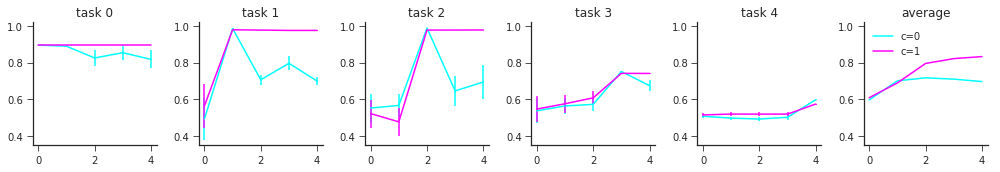

In [16]:
figure(figsize=(14, 2.5))
axs = [subplot(1,n_tasks+1,1)]#, None, None]
for i in range(1, n_tasks + 1):
    axs.append(subplot(1, n_tasks+1, i+1, sharex=axs[0], sharey=axs[0]))
    
keys = list(data['mean'].keys())
sorted_keys = np.sort(keys)

for cval in sorted_keys:
    mean_vals = data['mean'][cval]
    std_vals = data['std'][cval]
    for j in range(n_tasks):
        colorVal = scalarMap.to_rgba(np.log(cval))
        # axs[j].plot(evals[:, j], c=colorVal)
        axs[j].errorbar(range(n_tasks), mean_vals[:, j], yerr=std_vals[:, j]/np.sqrt(n_stats), c=colorVal)
    label = "c=%g"%cval
    average = mean_vals.mean(1)
    axs[-1].plot(average, c=colorVal, label=label)
    
for i, ax in enumerate(axs):
    ax.legend(loc='best')
    ax.set_title((['task %d'%j for j in range(n_tasks)] + ['average'])[i])
gcf().tight_layout()
sns.despine()

In [17]:
plt.rc('text', usetex=False)
plt.rc('xtick', labelsize=8)
plt.rc('ytick', labelsize=8)
plt.rc('axes', labelsize=8)

def simple_axis(ax):
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.get_xaxis().tick_bottom()
    ax.get_yaxis().tick_left()

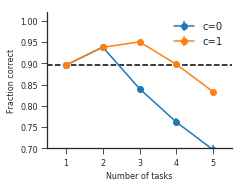

In [18]:
fig = plt.figure(figsize=(3.3,2.5))
ax = plt.subplot(111)

for cval in sorted_keys:
    mean_stuff = []
    std_stuff = []
    for i in range(len(data['mean'][cval])):
        mean_stuff.append(data['mean'][cval][i][:i+1].mean())
        std_stuff.append(np.sqrt((data['std'][cval][i][:i+1]**2).sum())/(n_stats*np.sqrt(n_stats)))
    # plot(range(1,n_tasks+1), mean_stuff, 'o-', label="c=%g"%cval)
    errorbar(range(1,n_tasks+1), mean_stuff, yerr=std_stuff, fmt='o-', label="c=%g"%cval)
        
axhline(data['mean'][cval][0][0], linestyle='--', color='k')
xlabel('Number of tasks')
ylabel('Fraction correct')
legend(loc='best')
xlim(0.5, 5.5)
ylim(0.7, 1.02)
# grid('on')
# sns.despine()
simple_axis(ax)

In [30]:
def _logistic_grad_hess(w, X, y, alpha, sample_weight=None):
    """Computes the gradient and the Hessian, in the case of a logistic loss.
    Parameters
    ----------
    w : ndarray, shape (n_features,) or (n_features + 1,)
        Coefficient vector.
    X : {array-like, sparse matrix}, shape (n_samples, n_features)
        Training data.
    y : ndarray, shape (n_samples,)
        Array of labels.
    alpha : float
        Regularization parameter. alpha is equal to 1 / C.
    sample_weight : array-like, shape (n_samples,) optional
        Array of weights that are assigned to individual samples.
        If not provided, then each sample is given unit weight.
    Returns
    -------
    grad : ndarray, shape (n_features,) or (n_features + 1,)
        Logistic gradient.
    Hs : callable
        Function that takes the gradient as a parameter and returns the
        matrix product of the Hessian and gradient.
    """
    n_samples, n_features = X.shape
    grad = np.empty_like(w)
    fit_intercept = grad.shape[0] > n_features

    w, c, yz = _intercept_dot(w, X, y)

    if sample_weight is None:
        sample_weight = np.ones(y.shape[0])

    z = expit(yz)
    z0 = sample_weight * (z - 1) * y

    grad[:n_features] = safe_sparse_dot(X.T, z0) + alpha * w

    # Case where we fit the intercept.
    if fit_intercept:
        grad[-1] = z0.sum()

    # The mat-vec product of the Hessian
    d = sample_weight * z * (1 - z)
    if sparse.issparse(X):
        dX = safe_sparse_dot(sparse.dia_matrix((d, 0),
                             shape=(n_samples, n_samples)), X)
    else:
        # Precompute as much as possible
        dX = d[:, np.newaxis] * X

    if fit_intercept:
        # Calculate the double derivative with respect to intercept
        # In the case of sparse matrices this returns a matrix object.
        dd_intercept = np.squeeze(np.array(dX.sum(axis=0)))

    def Hs(s):
        ret = np.empty_like(s)
        ret[:n_features] = X.T.dot(dX.dot(s[:n_features]))
        ret[:n_features] += alpha * s[:n_features]

        # For the fit intercept case.
        if fit_intercept:
            ret[:n_features] += s[-1] * dd_intercept
            ret[-1] = dd_intercept.dot(s[:n_features])
            ret[-1] += d.sum() * s[-1]
        return ret

    return grad, Hs(grad)

In [33]:
#Option - 1   https://github.com/scikit-learn/scikit-learn/blob/master/sklearn/linear_model/logistic.py#L40
from scipy.special import expit  # logistic function
from scipy import sparse

for  num_hidden_layer in [0,2]:
    gradient_save = np.zeros(shape=np.asarray(a_list[num_hidden_layer]).shape); hessian_save = np.zeros(shape=np.asarray(a_list[num_hidden_layer]).shape)
    for i in range(len(a_list[num_hidden_layer])):
        gradient_save[i],hessian_save[i] = _logistic_grad_hess(np.asarray(a_list[num_hidden_layer][i]), X_train, Y_train_all_attacks, 0.001, sample_weight=None)
    print('Rank of the Hessian Matrix: ',np.linalg.matrix_rank(hessian_save), 'for hidden layer',num_hidden_layer+1 if num_hidden_layer==0 else num_hidden_layer)

Rank of the Hessian Matrix:  43 for hidden layer 1
Rank of the Hessian Matrix:  43 for hidden layer 2


In [ ]:
#option - 2   https://stackoverflow.com/questions/31206443/numpy-second-derivative-of-a-ndimensional-array
def hessian(x):
    """
    Calculate the hessian matrix with finite differences
    Parameters:
       - x : ndarray
    Returns:
       an array of shape (x.dim, x.ndim) + x.shape
       where the array[i, j, ...] corresponds to the second derivative x_ij
    """
    x_grad = np.gradient(x) 
    hessian = np.empty((x.ndim, x.ndim) + x.shape, dtype=x.dtype) 
    for k, grad_k in enumerate(x_grad):
        # iterate over dimensions
        # apply gradient again to every component of the first derivative.
        tmp_grad = np.gradient(grad_k) 
        for l, grad_kl in enumerate(tmp_grad):
            hessian[k, l, :, :] = grad_kl
    return hessian

for  num_hidden_layer in [0,2]:
    hess_matrix = hessian(np.asarray(a_list[num_hidden_layer]))
    for i in range(2):
        for j in range(2):
            print('Rank of the Hessian matrix:',np.linalg.matrix_rank(hess_matrix[i][j]), 'for layer:',num_hidden_layer+1 if num_hidden_layer==0 else num_hidden_layer,'in direction:',i,j)


In [ ]:
#option-3    https://stackoverflow.com/questions/16841729/how-do-i-compute-the-derivative-of-an-array-in-python
for  num_hidden_layer in [0,2]:
    hess_matrix = np.diff(np.diff(np.asarray(a_list[num_hidden_layer])))
    print('Rank of the Hessian matrix:',np.linalg.matrix_rank(hess_matrix), 'for layer:',num_hidden_layer+1 if num_hidden_layer==0 else num_hidden_layer)


In [32]:
from scipy.sparse import csr_matrix, issparse
def _intercept_dot(w, X, y):
    """Computes y * np.dot(X, w).
    It takes into consideration if the intercept should be fit or not.
    Parameters
    ----------
    w : ndarray, shape (n_features,) or (n_features + 1,)
        Coefficient vector.
    X : {array-like, sparse matrix}, shape (n_samples, n_features)
        Training data.
    y : ndarray, shape (n_samples,)
        Array of labels.
    Returns
    -------
    w : ndarray, shape (n_features,)
        Coefficient vector without the intercept weight (w[-1]) if the
        intercept should be fit. Unchanged otherwise.
    X : {array-like, sparse matrix}, shape (n_samples, n_features)
        Training data. Unchanged.
    yz : float
        y * np.dot(X, w).
    """
    c = 0.
    if w.size == X.shape[1] + 1:
        c = w[-1]
        w = w[:-1]

    z = safe_sparse_dot(X, w) + c
    #z = np.dot(X, w) + c
    yz = y * z
    return w, c, yz

def safe_sparse_dot(a, b, dense_output=False):
    """Dot product that handle the sparse matrix case correctly
    Uses BLAS GEMM as replacement for numpy.dot where possible
    to avoid unnecessary copies.
    Parameters
    ----------
    a : array or sparse matrix
    b : array or sparse matrix
    dense_output : boolean, default False
        When False, either ``a`` or ``b`` being sparse will yield sparse
        output. When True, output will always be an array.
    Returns
    -------
    dot_product : array or sparse matrix
        sparse if ``a`` or ``b`` is sparse and ``dense_output=False``.
    """
    if issparse(a) or issparse(b):
        ret = a * b
        if dense_output and hasattr(ret, "toarray"):
            ret = ret.toarray()
        return ret
    else:
        return np.dot(a, b)


In [42]:
#https://stackoverflow.com/questions/39561560/getting-gradient-of-model-output-w-r-t-weights-using-keras
from keras.models import Sequential
from keras.layers import Dense, Activation
from keras import backend as k
import tensorflow as tf

outputTensor = model.output #Or model.layers[index].output
listOfVariableTensors = model.trainable_weights
gradients = k.gradients(outputTensor, listOfVariableTensors)
trainingExample = np.random.random((1,8))
sess = tf.InteractiveSession()
sess.run(tf.initialize_all_variables())
evaluated_gradients = sess.run(gradients,feed_dict={model.input:training_datasets[4][0]})

#Flattening the gradients into a list
def flatten(x):
    try:
        it = iter(x)
    except TypeError:
        yield x
    else:
        for i in it:
            for j in flatten(i):
                yield j

Flatten_gradients = list(flatten(evaluated_gradients))
print(len(Flatten_gradients))



Instructions for updating:
Use `tf.global_variables_initializer` instead.
4224


In [43]:
F_output = sess.run(outputTensor,feed_dict={model.input:training_datasets[4][0]})
print(F_output)
#masked_predict(model, training_datasets[1][0], training_datasets[1][1])
#listOfVariableTensors
print(min(Flatten_gradients),max(Flatten_gradients))

0.1
0.0 0.0


In [43]:
#Creating the Hessian matrix from the gradients
import math
Hessian_matrix = []
Hessian_row = []
for i in range(len(Flatten_gradients)):
    partial_deriv_1 = (math.ceil(Flatten_gradients[i]*1e15)/1e15)
    for j in range(len(Flatten_gradients)):
        partial_deriv_2 = (math.ceil(Flatten_gradients[j]*1e15)/1e15)
        Hessian_row.append(np.around(partial_deriv_1*partial_deriv_2))
    Hessian_matrix.append(Hessian_row)
    Hessian_row = []
print("Hessian Matrix Shape:",np.asarray(Hessian_matrix).shape)
print('Rank of the Hessian Matrix: ',(np.linalg.matrix_rank(np.asarray(Hessian_matrix))))

Hessian Matrix Shape: (4224, 4224)
Rank of the Hessian Matrix:  0


In [44]:
np.asarray(Hessian_matrix).min(),np.asarray(Hessian_matrix).max()

(0.0, 0.0)

In [47]:
import keras.backend as K
weights = model.weights # weight tensors
gradients = model.optimizer.get_gradients(model.output, weights) # gradient tensors
input_tensors = [model.inputs[0], # input data
                 model.sample_weights[0], # sample weights
                 model.targets[0], # labels
                 K.learning_phase(), # train or test mode
]
get_gradients = K.function(inputs=input_tensors, outputs=gradients)


inputs = [training_datasets[3][0], # X input data
          [1], # sample weights
          training_datasets[3][1], # y labels
          0 # learning phase in TEST mode
]

#All_weights_gradient = zip(weights, All_gradients)


All_gradients = get_gradients(inputs)
#Flattening the gradients into a list
def flatten(x):
    try:
        it = iter(x)
    except TypeError:
        yield x
    else:
        for i in it:
            for j in flatten(i):
                yield j

Flatten_gradients = list(flatten(All_gradients))
print(len(Flatten_gradients))

#Creating the Hessian matrix from the gradients
Hessian_matrix = []
Hessian_row = []
for i in range(len(Flatten_gradients)):
    partial_deriv_1 = Flatten_gradients[i]
    for j in range(len(Flatten_gradients)):
        partial_deriv_2 = Flatten_gradients[j]
        Hessian_row.append(partial_deriv_1*partial_deriv_2)
    Hessian_matrix.append(Hessian_row)
    Hessian_row = []
print(np.asarray(Hessian_matrix).shape)
print('Rank of the Hessian Matrix: ',np.linalg.matrix_rank(np.asarray(Hessian_matrix)))

4224
(4224, 4224)
Rank of the Hessian Matrix:  0


In [48]:
max(Flatten_gradients),min(Flatten_gradients)

(0.0, 0.0)

In [85]:
#Weights Pattern after training each task
Flatten_weights=[]
#Flattening the weights into a list
def flatten(x):
    try:
        it = iter(x)
    except TypeError:
        yield x
    else:
        for i in it:
            for j in flatten(i):
                yield j
                
for i in range(len(model_weights_save)):
    Flatten_weights.append(list(flatten(model_weights_save[i]))) 

Extract_model_params = [];
#For model parameters without consolidation use val, with consolidation use val+50 
for i in [val for val in [0,1,2,3,4,5,6,7,8,9]]:   
    Extract_model_params.append(Flatten_weights[i])

In [86]:
gradient_save=[]
for i in range(1,len(Extract_model_params)):
    temp=list(np.asarray(Extract_model_params[i-1])-np.asarray(Extract_model_params[i]))
    
    gradient = [j/0.001 for j in temp]
    gradient_save.append(gradient)

In [87]:
#Creating the Hessian matrix from the gradients
import math
Hessian_matrix = []
Hessian_row = []
for k in range(len(gradient_save)):
    for i in range(len(gradient_save[k])):
        partial_deriv_1 = (math.ceil(gradient_save[k][i]*1e10)/1e10)
        for j in range(len(gradient_save[k])):
            partial_deriv_2 = (math.ceil(gradient_save[k][j]*1e10)/1e10)
            Hessian_row.append(np.around(partial_deriv_1*partial_deriv_2))
        Hessian_matrix.append(Hessian_row)
        Hessian_row = []
    print('Rank of the Hessian Matrix for k=',k,'is :',np.linalg.matrix_rank(np.asarray(Hessian_matrix)))

#Without Consolidation up to 15 decimal digits
#Rank of the Hessian Matrix for k= 0 is : 3803
#Rank of the Hessian Matrix for k= 1 is : 3894
#Rank of the Hessian Matrix for k= 2 is : 3986
#Rank of the Hessian Matrix for k= 3 is : 4053
#With 10 decimal places
#Rank of the Hessian Matrix for k= 0 is : 3485
#Rank of the Hessian Matrix for k= 1 is : 3648
#Rank of the Hessian Matrix for k= 2 is : 3832
#Rank of the Hessian Matrix for k= 3 is : 3905
#With 5 decimal places
#Rank of the Hessian Matrix for k= 0 is : 3488
#Rank of the Hessian Matrix for k= 1 is : 3653
#Rank of the Hessian Matrix for k= 2 is : 3840
#Rank of the Hessian Matrix for k= 3 is : 3917

#With Consolidation up to 15 decimal digits
#Rank of the Hessian Matrix for k= 0 is : 3503
#Rank of the Hessian Matrix for k= 1 is : 3645
#Rank of the Hessian Matrix for k= 2 is : 3854
#Rank of the Hessian Matrix for k= 3 is : 3907
#with 10 decimal places
#Rank of the Hessian Matrix for k= 0 is : 3329
#Rank of the Hessian Matrix for k= 1 is : 3461
#Rank of the Hessian Matrix for k= 2 is : 3680
#Rank of the Hessian Matrix for k= 3 is : 3736
#with 5 decimeal places
#Rank of the Hessian Matrix for k= 0 is : 3324
#Rank of the Hessian Matrix for k= 1 is : 3460
#Rank of the Hessian Matrix for k= 2 is : 3679
#Rank of the Hessian Matrix for k= 3 is : 3729

Rank of the Hessian Matrix for k= 0 is : 3567


KeyboardInterrupt: 

In [64]:
#Finding the smallest positive number in Hessian matrix to set the decimial precision limit
A=list(flatten(Hessian_matrix))
B=[0 if x < 0 else x for x in A]
min(B), max(B)

KeyboardInterrupt: 

In [15]:
import sympy as smp
import mpmath as mp
mp.mp.dps =50
Hessian_matrix = []
Hessian_row = []
for k in range(len(gradient_save)):
    for i in range(len(gradient_save[k])):
        partial_deriv_1 = np.around(gradient_save[k][i],15)
        for j in range(len(gradient_save[k])):
            partial_deriv_2 = np.around(gradient_save[k][j],15)
            Hessian_row.append(np.around(partial_deriv_1*partial_deriv_2))
        Hessian_matrix.append(Hessian_row)
        Hessian_row = []
    print('Rank of the Hessian Matrix for k=',k,'is :',(smp.Matrix(Hessian_matrix).rank()))

KeyboardInterrupt: 